# Dust Buildup at High-z 

This notebook includes all of the functions, plots, and analysis needed to produce any data products or plots for the "Dust Build-up at High-z" paper using my personal analysis scripts.

Always runs the first few cells before running code in any section!

In [43]:
%load_ext autoreload
%autoreload 2

import os
import sys
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from astropy.io import fits
#np.set_printoptions(threshold=sys.maxsize)

from crc_scripts.io.gizmo import *
from crc_scripts.observations import dust_obs as obs
from crc_scripts.observations.obs_data import Observational_Data
from crc_scripts.utils.math_utils import *
import crc_scripts.utils.data_calc_utils as calc
from crc_scripts.figure import Figure,Projection
from crc_scripts.analysis.data_reduction import Buffer
from crc_scripts.utils.SKIRT.SKIRT_utils import *
import crc_scripts.utils.plot_utils as plt_set
import matplotlib.lines as mlines


# First setup directory for all the plots
plot_dir = os.path.join(os.environ['BIGRED'],'HighZ_dust/')
os.makedirs(plot_dir, exist_ok=True)

## Simulation Info 
Definitions for simulation info which is used by all routines

In [44]:
# Main directory
main_dirc = '/N/scratch/cchoban/HiZ_dust/'
# Names of simulation directories
names = np.array(['z5m11d','z5m12a','z5m12b','z5m12d',
                  'z7m12a','z7m12b','z7m12c','z9m12a',
                  'z5m12a_4acc','z5m12a_0.9sd',
                  'z5m11d_0.2sd_4acc','z5m12a_0.2sd_4acc','z5m12b_0.2sd_4acc','z5m12d_0.2sd_4acc',
                  'z7m12a_0.2sd_4acc','z7m12b_0.2sd_4acc','z7m12c_0.2sd_4acc','z9m12a_0.2sd_4acc',
                  'z5m12a_0.2sd_4acc_Tcut','z5m12a_0.2sd_4acc_FIRE3'])

short_names = np.array(['z5m11d','z5m12a','z5m12b','z5m12d',
                  'z7m12a','z7m12b','z7m12c','z9m12a',
                  'z5m12a_4acc','z5m12a_0.9sd',
                  'z5m11d_enh','z5m12a_enh','z5m12b_enh','z5m12d_enh',
                  'z7m12a_enh','z7m12b_enh','z7m12c_enh','z9m12a_enh',
                  'z5m12a_enh_Tcut','z5m12a_enh_FIRE3'])

FIRE_ver = np.array([2]*(len(names)-1)+[3],dtype=int)

# names = np.array(['z5m11d_0.2sd_4acc','z5m12a_0.2sd_4acc','z5m12b_0.2sd_4acc','z5m12d_0.2sd_4acc',
#                   'z7m12a_0.2sd_4acc','z7m12b_0.2sd_4acc','z7m12c_0.2sd_4acc','z9m12a_0.2sd_4acc'])

# short_names = np.array(['z5m11d_enh','z5m12a_enh','z5m12b_enh','z5m12d_enh',
#                   'z7m12a_enh','z7m12b_enh','z7m12c_enh','z9m12a_enh'])

# FIRE_ver = np.array([2]*(len(names)),dtype=int)

# Some masks to get subsets of the simulations
all_mask = np.arange(len(names))
fiducial_mask = np.char.find(names, "_") < 0
z5m12a_mask = np.char.find(names, "z5m12a") >= 0
z5m12d_mask = np.char.find(names, "z5m12d") >= 0
z5m12b_mask = np.char.find(names, "z5m12b") >= 0
z5enh_mask = (np.char.find(names, "z5") >= 0) & (np.char.find(names, "0.2sd_4acc") >= 0) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))
z7enh_mask = (np.char.find(names, "z7") >= 0) & (np.char.find(names, "0.2sd_4acc") >= 0) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))
z9enh_mask = (np.char.find(names, "z9") >= 0) & (np.char.find(names, "0.2sd_4acc") >= 0) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))
z79enh_mask = ((np.char.find(names, "z9") >= 0) | (np.char.find(names, "z7") >= 0)) & (np.char.find(names, "0.2sd_4acc") >= 0) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))

z5fid_mask = (np.char.find(names, "z5") >= 0) & (np.char.find(names, "_") < 0)
z7fid_mask = (np.char.find(names, "z7") >= 0) & (np.char.find(names, "_") < 0)
z9fid_mask = (np.char.find(names, "z9") >= 0) & (np.char.find(names, "_") < 0)
z79fid_mask = ((np.char.find(names, "z9") >= 0) | (np.char.find(names, "z7") >= 0)) & (np.char.find(names, "_") < 0)

z5m12b_z7m12c_mask = ((np.char.find(names, "z5m12b") >= 0) | (np.char.find(names, "z7m12c") >= 0)) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))

z5m12b_z5m11d_mask = ((np.char.find(names, "z5m12b") >= 0) | (np.char.find(names, "z5m11d") >= 0)) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))
z5m12b_z5m12d_mask = ((np.char.find(names, "z5m12b") >= 0) | (np.char.find(names, "z5m12d") >= 0)) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))
z5m12b_z7m12b_mask = ((np.char.find(names, "z5m12b") >= 0) | (np.char.find(names, "z7m12b") >= 0)) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))

z5m11d_z5m12a_mask = ((np.char.find(names, "z5m11d") >= 0) | (np.char.find(names, "z5m12a") >= 0)) & ~((np.char.find(names, "0.2sd_4acc_") >= 0)) & ~((np.char.find(names, "z5m12a_4acc") >= 0)) & ~((np.char.find(names, "z5m12a_0.9sd") >= 0))
z5m12d_z7m12c_mask = ((np.char.find(names, "z5m12d") >= 0) | (np.char.find(names, "z7m12c") >= 0)) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))
z7m12a_z9m12a_mask = ((np.char.find(names, "z7m12a") >= 0) | (np.char.find(names, "z9m12a") >= 0)) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))

FIRE3_mask = np.char.find(names, "FIRE3") >= 0
enhanced_mask = (np.char.find(names, "0.2sd_4acc") >= 0) & ~((np.char.find(names, "0.2sd_4acc_") >= 0))

fid_and_enh_mask = (np.char.find(names, "_") < 0) | ((np.char.find(names, "0.2sd_4acc") >= 0) & ~(np.char.find(names, "0.2sd_4acc_") >= 0))


# Main sim directories and their snap and halo directories
# Note you need to specify the dtype or else you get numpy strings which annoying to deal with
main_dirs = np.array([main_dirc+name+'/' for name in names], dtype=object)
snap_dirs = np.array([main_dirc+name+'/output/' for name in names], dtype=object)
hdirs = np.array([main_dirc+name+'/halo/ahf/output/' for name in names], dtype=object)
# We only look at the main halos
halo_histories = np.array([main_dirc+name+'/halo/ahf/history/halo_main.dat' for name in names], dtype=object)

# Final snapshot number since sims are run to varying redshift
final_snaps = np.zeros(len(names),dtype=int)
for i,snap_dir in enumerate(snap_dirs):
    snap_files = os.listdir(snap_dir)
    snap_files.sort()
    snap_nums = []
    for snap_file in snap_files:
        if 'snapshot' in snap_file:
            if snap_file[9:12] == '000':
                snap_nums += [0]
            else:
                snap_nums += [int(snap_file[9:12].lstrip('0'))]
    final_snaps[i]=np.max(snap_nums)
    print(snap_dir,final_snaps[i])

# Nothing interesting in earlier snaps so limit first snapshot to 10
first_snaps = [10]*len(names)
# FIRE-3 has different snapshot numbering so this roughly corresponds to the same redshift as FIRE-2
first_snaps[-1]=10


/N/scratch/cchoban/HiZ_dust/z5m11d/output/ 67
/N/scratch/cchoban/HiZ_dust/z5m12a/output/ 67
/N/scratch/cchoban/HiZ_dust/z5m12b/output/ 66
/N/scratch/cchoban/HiZ_dust/z5m12d/output/ 67
/N/scratch/cchoban/HiZ_dust/z7m12a/output/ 32
/N/scratch/cchoban/HiZ_dust/z7m12b/output/ 35
/N/scratch/cchoban/HiZ_dust/z7m12c/output/ 41
/N/scratch/cchoban/HiZ_dust/z9m12a/output/ 16
/N/scratch/cchoban/HiZ_dust/z5m12a_4acc/output/ 67
/N/scratch/cchoban/HiZ_dust/z5m12a_0.9sd/output/ 67
/N/scratch/cchoban/HiZ_dust/z5m11d_0.2sd_4acc/output/ 67
/N/scratch/cchoban/HiZ_dust/z5m12a_0.2sd_4acc/output/ 67
/N/scratch/cchoban/HiZ_dust/z5m12b_0.2sd_4acc/output/ 57
/N/scratch/cchoban/HiZ_dust/z5m12d_0.2sd_4acc/output/ 67
/N/scratch/cchoban/HiZ_dust/z7m12a_0.2sd_4acc/output/ 33
/N/scratch/cchoban/HiZ_dust/z7m12b_0.2sd_4acc/output/ 33
/N/scratch/cchoban/HiZ_dust/z7m12c_0.2sd_4acc/output/ 41
/N/scratch/cchoban/HiZ_dust/z9m12a_0.2sd_4acc/output/ 18
/N/scratch/cchoban/HiZ_dust/z5m12a_0.2sd_4acc_Tcut/output/ 67
/N/scratch/

## Galactic Properties

Load in each simulation and calculate general galactic properties for simulation table.

In [50]:
# Select what subset of the sims you want
mask = z5m12a_mask

verbose=False

indices = np.arange(len(names))[mask]
for i in indices:
    snap_dir=snap_dirs[i]
    hdir = hdirs[i];name = names[i];short_name = short_names[i]; snap_num = final_snaps[i]
    halo = load_halo(snap_dir, snap_num, cosmological=1, id=-1, mode='AHF', hdir=hdir)
    halo.set_zoom(rout=1.0, kpc=False)

    
    halfmass_radius = halo.get_half_mass_radius(within_radius=None, geometry='spherical', ptype=4, rvir_frac=1)

    #halo.set_zoom(rout=3*halfmass_radius, kpc=True)
    gas = halo.loadpart(0)
    star = halo.loadpart(4)



    M_star = np.sum(star.get_property('M'))
    M_gas = np.sum(gas.get_property('M'))
    M_metal = np.sum(gas.get_property('M_metals'))
    M_dust = np.sum(gas.get_property('M_dust'))
    age = star.get_property('age')
    sfr_10Myr = np.sum(star.get_property('M')[age<0.01])/1E7
    sfr_100Myr = np.sum(star.get_property('M')[age<0.1])/1E8

    gas_halfmass_radius_all = halo.get_half_mass_radius(within_radius=None, geometry='spherical', ptype=0, rvir_frac=1)
    gas_halfmass_radius_inner = halo.get_half_mass_radius(within_radius=None, geometry='spherical', ptype=0, rvir_frac=0.2)

    neutral_mass_frac = gas.get_property('H_neutral_fraction')
    M_gas_neutral = np.sum(gas.get_property('M_gas_neutral'))
    Z_neutral = weighted_percentile(gas.get_property('Z'), percentiles=np.array([50]), weights=gas.get_property('M_gas_neutral'), ignore_invalid=True)[0]
    Z_all = weighted_percentile(gas.get_property('Z'), percentiles=np.array([50]), weights=gas.get_property('M_gas'), ignore_invalid=True)[0]
    Z_ionized = weighted_percentile(gas.get_property('Z'), percentiles=np.array([50]), weights=gas.get_property('M_gas_ionized'), ignore_invalid=True)[0]
    cool_mask = gas.get_property('T')<=1000
    Z_cool = weighted_percentile(gas.get_property('Z')[cool_mask], percentiles=np.array([50]), weights=gas.get_property('M_gas')[cool_mask], ignore_invalid=True)[0]
    
    
    neutral_halfmass_radius_all = halo.get_half_mass_radius(within_radius=None, geometry='spherical', ptype=0, rvir_frac=1, mass_weight = neutral_mass_frac)
    neutral_halfmass_radius_inner = halo.get_half_mass_radius(within_radius=None, geometry='spherical', ptype=0, rvir_frac=0.2, mass_weight = neutral_mass_frac)
    
    
    dust_mass_frac = gas.get_property('D/G')
    dust_halfmass_radius_all = halo.get_half_mass_radius(within_radius=None, geometry='spherical', ptype=0, rvir_frac=1, mass_weight = dust_mass_frac)
    dust_halfmass_radius_inner = halo.get_half_mass_radius(within_radius=None, geometry='spherical', ptype=0, rvir_frac=0.2, mass_weight = dust_mass_frac)


    if verbose:
        print(name)
        print("\t Final Redshift:",halo.redshift)
        print("\t M_vir:",halo.mvir/1E10, "10^10 M_sol")
        print("\t R_vir:",halo.rvir, "kpc")
        if len(gas.get_property('size')) > 0:
            print("\t softening min:",np.min(gas.get_property('size')))
        else:
            print("\t No gas within 3 x half mass radius!")
        print("\t M_stellar:",M_star/1E10,"10^10 M_Solar")
        print("\t R_1/2:",halfmass_radius, "kpc")
        print("\t M_gas:",M_gas/1E10,"10^10 M_Solar")
        print("\t M_metal:",M_metal/1E10,"10^10 M_Solar")
        print("\t M_dust:",M_dust/1E10,"10^10 M_Solar")
        print("\t Median Z:",np.median(gas.get_property('Z')),"Z_solar")
        print("\t Median D/Z:",np.median(gas.get_property('D/Z')))
        print("\t M_dust:",M_dust/1E10,"10^10 M_Solar")
        print("\t Median Z:",np.median(gas.get_property('Z')),"Z_solar")
        print("\t Median D/Z:",np.median(gas.get_property('D/Z')))
        print("\t SFR_10Myr:",sfr_10Myr,"M_Solar/yr")
        print("\t SFR_100Myr:",sfr_100Myr,"M_Solar/yr")
        print("\t Gas R_1/2 All:",gas_halfmass_radius_all,"kpc")
        print("\t Gas R_1/2 Inner:",gas_halfmass_radius_inner,"kpc")
        print("\t Z cool (T<1E3K) gas:",Z_cool,"Z_solar")
        print("\t Neutral gas R_1/2 All:",neutral_halfmass_radius_all,"kpc")
        print("\t Neutral gas R_1/2 Inner:",neutral_halfmass_radius_inner,"kpc")
        print("\t M_gas_neutral:",M_gas_neutral/1E10,"10^10 M_Solar")
        print("\t Dust R_1/2 All:",dust_halfmass_radius_all,"kpc")
        print("\t Dust R_1/2 Inner:",dust_halfmass_radius_inner,"kpc")


    # Now the latex table line
    # print(r'%s & %1.2f & %1.2E & %1.2f & %1.2E & %1.2f & %1.2E & %1.2E & %1.2E & %1.2f \\'%(name,halo.redshift,halo.mvir,halo.rvir,M_star,halfmass_radius,M_gas,M_metal,M_dust,sfr_10Myr))


    M_halo_power = int(np.floor(np.log10(halo.mvir)))
    M_halo_digit = halo.mvir / np.power(10,M_halo_power)    
    M_star_power = int(np.floor(np.log10(M_star)))
    M_star_digit = M_star / np.power(10,M_star_power)
    M_gasn_power = int(np.floor(np.log10(M_gas_neutral)))
    M_gasn_digit = M_gas_neutral / np.power(10,M_gasn_power)
    M_dust_power = int(np.floor(np.log10(M_dust)))
    M_dus_digit = M_dust / np.power(10,M_dust_power)

    # print(r'%s & %1.1f & %1.2E & %1.2f & %1.2E & %1.2f & %1.2E & %1.2f & %1.2f & %1.2E & %1.2f & %1.2f \\'%
    #      (name,halo.redshift,halo.mvir,halo.rvir,M_star,halfmass_radius,M_gas_neutral,neutral_halfmass_radius,Z_neutral,M_dust,dust_halfmass_radius,sfr_10Myr))

    print(r'%s & %1.1f & $%.2f \times 10^{%i}$ & %1.2f &  $%.2f \times 10^{%i}$ & %1.2f & $%.2f \times 10^{%i}$ & %1.2f & %1.2f &  $%.2f \times 10^{%i}$ & %1.2f & %1.2f \\'%
          (short_name,halo.redshift,M_halo_digit,M_halo_power,halo.rvir,M_star_digit,M_star_power,halfmass_radius,M_gasn_digit,M_gasn_power,neutral_halfmass_radius_inner,
           Z_cool,M_dus_digit,M_dust_power,dust_halfmass_radius_inner,sfr_10Myr))
    
    del gas; del star;
    del halo;

Looking for snapshot's corresponding AHF file
AHF file found /N/scratch/cchoban/HiZ_dust/z5m12a/halo/ahf/output/snapshot_067.z5.024.AHF_halos
Ptype 4 half mass radius: 6.228000e+00 kpc
Ptype 0 half mass radius: 1.848864e+01 kpc
Ptype 0 half mass radius: 5.559096e+00 kpc
Ptype 0 half mass radius: 1.380006e+01 kpc
Ptype 0 half mass radius: 5.432504e+00 kpc
Ptype 0 half mass radius: 8.119062e+00 kpc
Ptype 0 half mass radius: 6.187366e+00 kpc
z5m12a & 5.0 & $4.39 \times 10^{11}$ & 39.06 &  $5.43 \times 10^{9}$ & 6.23 & $1.91 \times 10^{10}$ & 5.43 & 0.12 &  $1.08 \times 10^{6}$ & 6.19 & 5.15 \\
Looking for snapshot's corresponding AHF file
AHF file found /N/scratch/cchoban/HiZ_dust/z5m12a_4acc/halo/ahf/output/snapshot_067.z5.024.AHF_halos
Ptype 4 half mass radius: 3.780205e+00 kpc
Ptype 0 half mass radius: 1.619305e+01 kpc
Ptype 0 half mass radius: 4.780434e+00 kpc
Ptype 0 half mass radius: 1.189630e+01 kpc
Ptype 0 half mass radius: 4.694342e+00 kpc
Ptype 0 half mass radius: 5.619436e+00 k

## Simulation End Plots

Load in just the simulations you want to avoid memory issues

In [27]:
prefix_name = 'fiducial'
mask = names=='z5m12a_0.2sd_4acc'


snap_objs=[]
snap_names = []

labels = names[mask]

for i, snap_dir in enumerate(snap_dirs[mask]):
    hdir = hdirs[mask][i];name = names[mask][i];snap_num = final_snaps[mask][i]
    halo = load_halo(snap_dir, snap_num, cosmological=1, id=-1, mode='AHF', hdir=hdir)
    print(name)

    snap=load_snap(snap_dir, snap_num, cosmological=1)
    star = snap.loadpart(4)
    print(np.mean(star.p,axis=0))
    print(halo.center_position)
    halo.assign_center()
    halo.set_zoom(rout=1.0, kpc=False)

    snap_objs+=[halo]
    snap_names += [name]

snap_objs=np.array(snap_objs)

Looking for snapshot's corresponding AHF file
z5m12a_0.2sd_4acc
[3386.91862742 3533.42634059 3541.0864078 ]
[3386.7119656552914, 3534.315624360203, 3544.885142432732]
assigning center of galaxy:
  center position [kpc] = 3386.729, 3534.346, 3544.908
  center velocity [km/s] = -41.5, -33.7, -110.9


### Phase Histograms

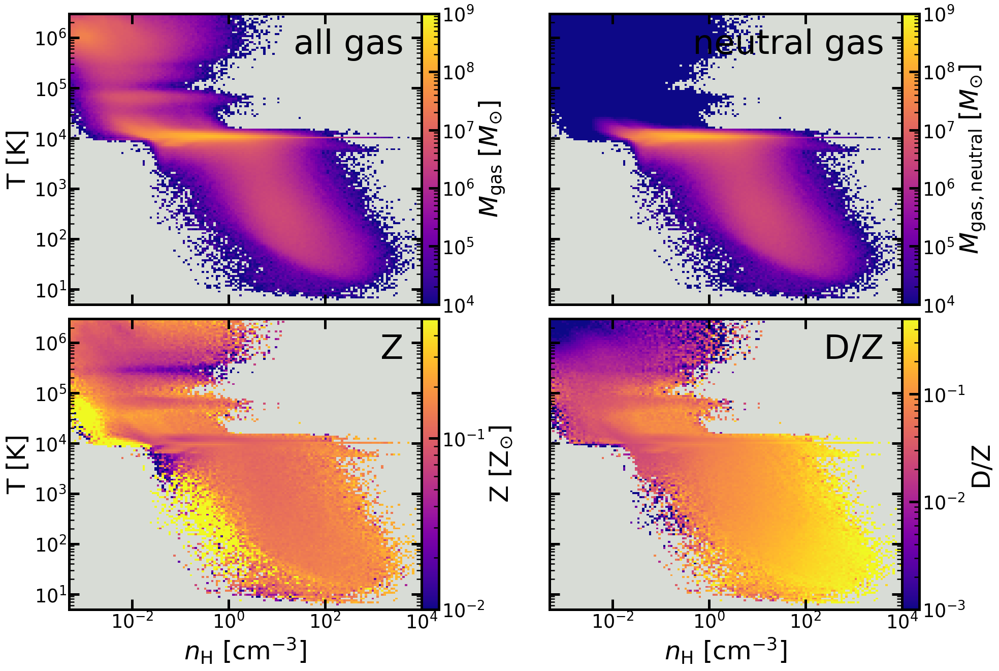

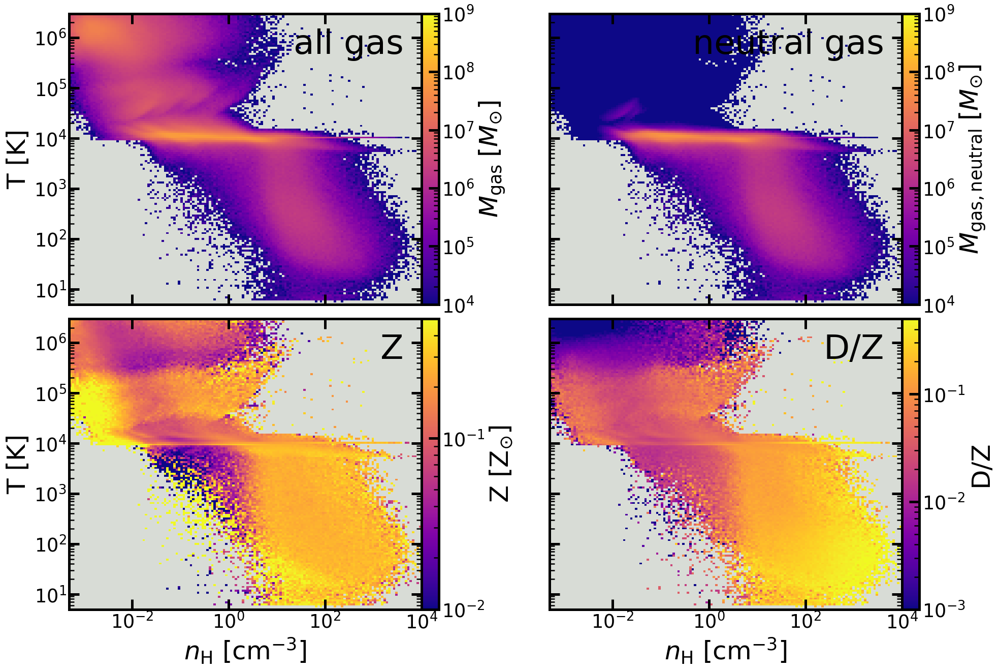

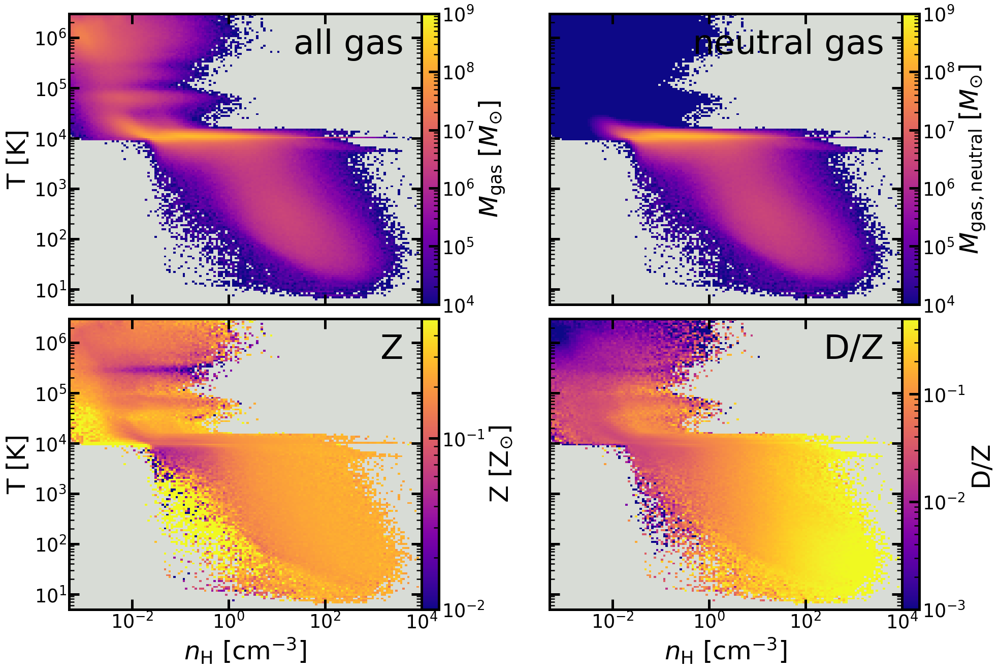

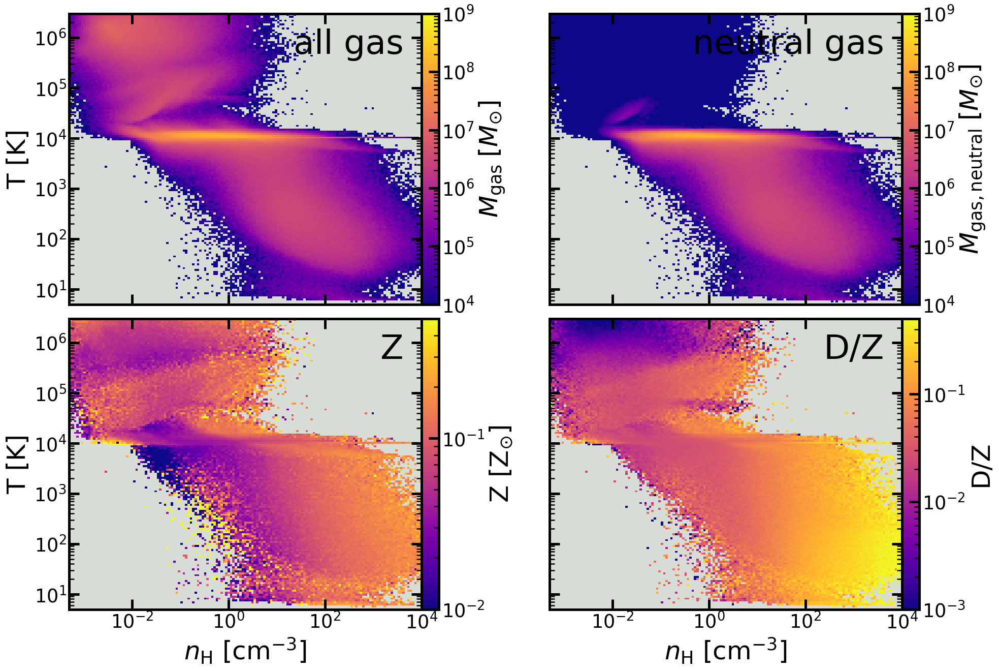

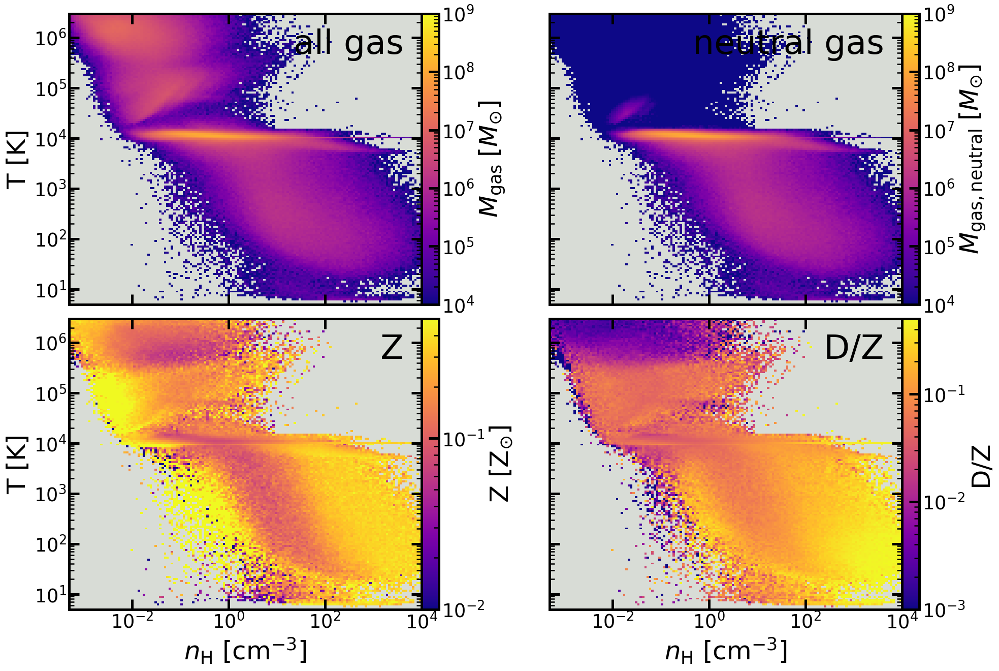

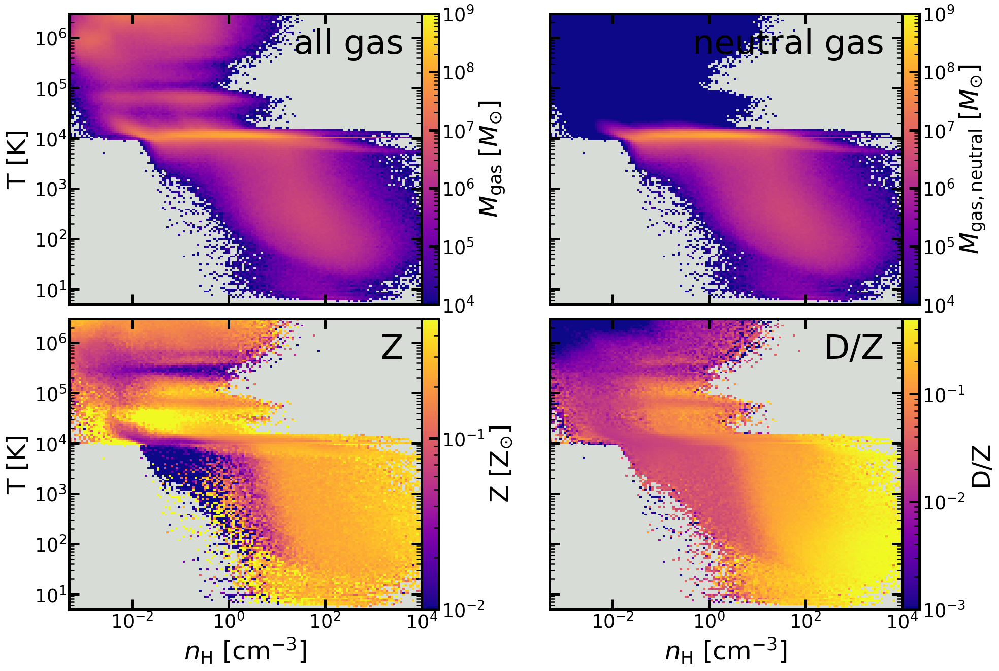

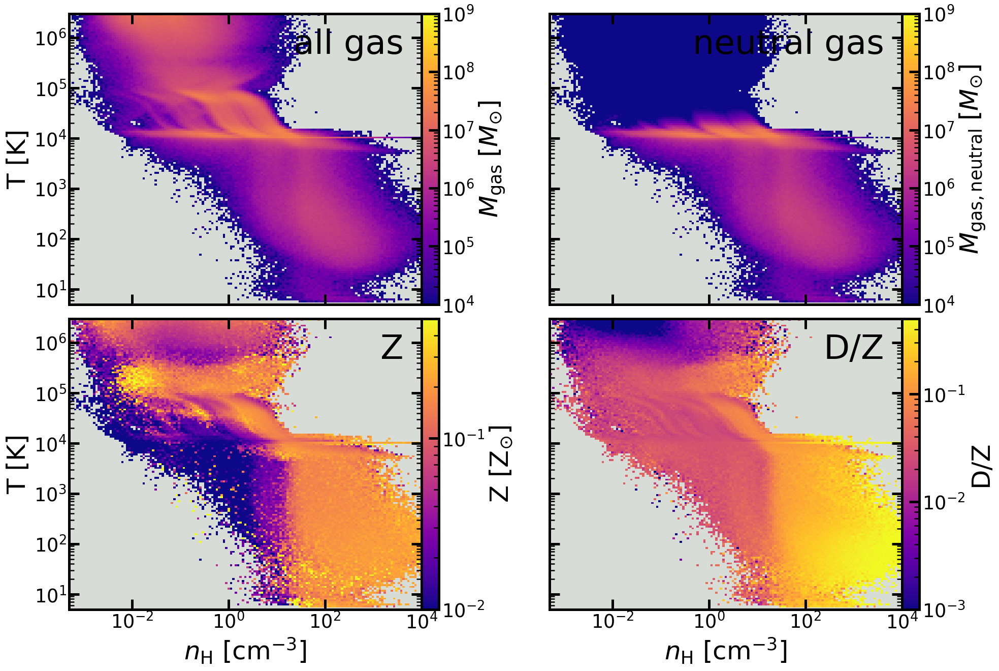

In [71]:
foutname='metals&dust_gas_phase.png'
# Property to bin in phase diagram
props = ['M_gas','M_gas_neutral','Z','D/Z']
fig_labels = ['all gas','neutral gas','Z','D/Z']
z_logs=[True]*len(props)
# Number of bins across nH and T space
bin_nums = 150
cmap='plasma'
# nH and T limits
nH_lims = [5E-4,1E4]
T_lims = [5,3E6]

prop_lims=[[1E4,1E9],[1E4,1E9],[0.01,0.5],[0.001,0.5]]

for i, snap in enumerate(snap_objs):
    name = snap_names[i]
    # Setup figure
    fig = Figure(len(props),ncols=2, sharex='col',sharey='row')

    for j,prop in enumerate(props):
        # Set up for each plot
        fig.set_axis(j, 'nH', 'T', x_lim=nH_lims, x_log=True, y_lim=T_lims, y_log=True, face_color='xkcd:light grey')
        ret = calc.calc_phase_hist_data(prop, snap, bin_nums=bin_nums, nH_lims=nH_lims, T_lims=T_lims)
        X, Y = np.meshgrid(ret.x_edge, ret.y_edge)
        fig.plot_histogram(j, prop, X, Y, ret.statistic.T, cmap=cmap, z_lim=prop_lims[j], z_log=z_logs[j],label=fig_labels[j])

        # Add colorbar to last axis
        fig.add_colorbar(j,cbar_prop=prop)

    fig.save(plot_dir+name+'_'+foutname)

### Projections 

Projection size: 19.566 kpc


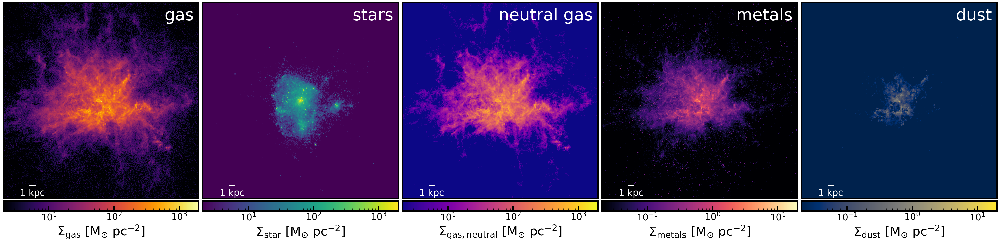

In [28]:
# Properties to plot projections of. Can be surface densities (total mass in pixel divied by pixel size) or properties like T (median value of all particles in pixel)
properties = ['sigma_gas','sigma_star','sigma_gas_neutral','sigma_metals','sigma_dust']
# Limits for projection of each property. Defaults if not set
prop_limits = [[2E0,2E3],[2E0,2E3],[2E0,2E3],[2E-2,2E1],[2E-2,2E1]]
# Colormaps for each projection
prop_cmaps = ['inferno','viridis','plasma','magma','cividis']
# Do you want log colormaps (default = yes)
log_cmap = [True]*len(properties)
# Labels for each projection is so desired
labels = ['gas','stars','neutral gas','metals','dust']
# Physical size of projection
rvir_frac = 0.5 # rvir_frac
# Do you want a secondary projection from an orthogonal axis?
sub_proj = False
# size of secondary projection
sub_L = 2 # kpc
# Do you want colorbars for each projection?
has_colorbars=True
# Size resolution (kpc) for each "pixel" in projection
pixel_res=0.05

# Saved image name
foutname='snap_projection.png'

print(snap_objs)
for i,snap in enumerate(snap_objs):
    # Initialize projection figure
    L = rvir_frac*snap.rvir
    height_ratios = [L/sub_L,1]
    new_proj = Projection(len(properties), sub_proj=sub_proj, has_colorbars=has_colorbars, height_ratios=height_ratios)
    # Create projections for each property and plot the projection
    print('Projection size: %.3f kpc'%L)
    for j,prop in enumerate(properties):
        new_proj.set_axis(j, prop, L, axes_visible=False)
        # x-y projection
        main_pixel_stats, main_xedges, main_yedges, main_extent = calc.calc_projected_prop(prop, snap, [L,L,L], pixel_res=pixel_res, proj='xy')
        # x-z projection
        #sub_pixel_stats, sub_xedges, sub_yedges, sub_extent = calc.calc_projected_prop(prop, snap, [L,sub_L,L], pixel_res=pixel_res, proj='xz')
        new_proj.plot_projection(j, main_pixel_stats, main_extent, sub_proj_data=None, sub_extent=None,
                                 cmap= prop_cmaps[j], v_limits = prop_limits[j],v_log=log_cmap[j], label=labels[j])

    new_proj.save(plot_dir+snap_names[i]+'_'+foutname)

In [11]:
# Properties to plot projections of. Can be surface densities (total mass in pixel divied by pixel size) or properties like T (median value of all particles in pixel)
properties = ['sigma_gas','sigma_star','sigma_gas_neutral','sigma_metals','sigma_dust']
# Limits for projection of each property. Defaults if not set
prop_limits = [[2E0,2E3],[2E0,2E3],[2E0,2E3],[2E-2,2E1],[2E-2,2E1]]
# Colormaps for each projection
prop_cmaps = ['inferno','viridis','plasma','magma','cividis']
# Do you want log colormaps (default = yes)
log_cmap = [True]*len(properties)
# Labels for each projection is so desired
labels = ['gas','stars','neutral gas','metals','dust']
# Physical size of projection
rvir_frac = 0.5 # rvir_frac
# Do you want a secondary projection from an orthogonal axis?
sub_proj = False
# size of secondary projection
sub_L = 2 # kpc
# Do you want colorbars for each projection?
has_colorbars=True
# Size resolution (kpc) for each "pixel" in projection
pixel_res=0.05

# Saved image name
foutname='snap_projection.png'


for i,snap in enumerate(snap_objs):
    # Initialize projection figure
    L = rvir_frac*snap.rvir
    height_ratios = [L/sub_L,1]
    new_proj = Projection(len(properties), sub_proj=sub_proj, has_colorbars=has_colorbars, height_ratios=height_ratios)
    # Create projections for each property and plot the projection
    print('Projection size: %.3f kpc'%L)
    for j,prop in enumerate(properties):
        new_proj.set_axis(j, prop, L, axes_visible=False)
        # x-y projection
        main_pixel_stats, main_xedges, main_yedges, main_extent = calc.calc_projected_prop(prop, snap, [L,L,L], pixel_res=pixel_res, proj='xy')
        # x-z projection
        #sub_pixel_stats, sub_xedges, sub_yedges, sub_extent = calc.calc_projected_prop(prop, snap, [L,sub_L,L], pixel_res=pixel_res, proj='xz')
        new_proj.plot_projection(j, main_pixel_stats, main_extent, sub_proj_data=None, sub_extent=None,
                                 cmap= prop_cmaps[j], v_limits = prop_limits[j],v_log=log_cmap[j], label=labels[j])

    new_proj.save(plot_dir+snap_names[i]+'_'+foutname)

## Time Evolution

Process snapshots for time evolution data and make time evolution plots.

### Process Time Evolution Data (THIS TAKES TIME AND USES A LOT OF MEMORY)

In [41]:
# Maximum radius (fraction of Rvir) to get data)
# Papers choose 0.2 Rvir since stellar populations are usually more extended at high redshift
rvir_frac = 0.2 # times Rvir

sims=[]
for i in range(len(names)):
    snap_dir = snap_dirs[i]; hdir = hdirs[i];final_snap=final_snaps[i];halo_file=halo_histories[i]
    first_snap = first_snaps[i]
    snap_nums = list(range(first_snap,final_snaps[i]+1))
    buff = Buffer(snap_dir, snap_nums, cosmological=1,halohist_file=halo_file)
    buff.set_halo(mode='AHF', hdir=hdir, rout=rvir_frac, kpc=False)
    buff.load(override=False,increment=2)

    sims+=[buff]
sims=np.array(sims)

Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
Reduced data already exists for the given halo setup so loading that first....
All done reducing 

### Evolution of galactic properties for all galaxies

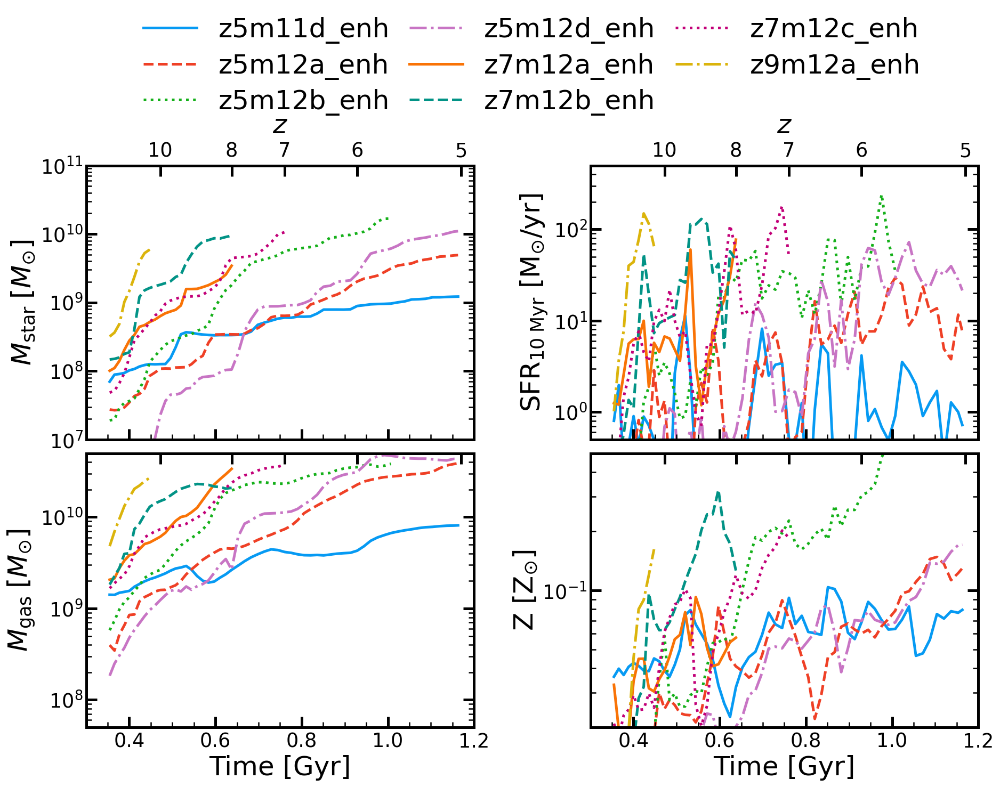

In [64]:
mask=enhanced_mask
prefix = 'enhanced'

foutname = prefix+'_'+str(rvir_frac)+'Rvir_reduced_galaxy_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_star','sfr_10Myr','M_gas','Z']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[1E7,1E11],[5E-1,5E2],[5E7,5E10],[2E-2,0.5],]
x_lim=[0.3,1.2]
y_logs=[True]*len(params); #y_logs[3]=False

# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
#labels = names[mask]
labels = short_names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
gas_sample = 'all'
star_sample='all'
metal_sample = 'cold'
subsample = [star_sample,star_sample,gas_sample,metal_sample,gas_sample,gas_sample,star_sample]
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(data_objs), style=style)
# Setup figure
fig = Figure(len(params), sharex=True, orientation='vertical',ncols=2,yx_ratio=0.9)

for i, y_prop in enumerate(params):

    fig.set_axis(i, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)

    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            if isinstance(subsample, list):
                sample = subsample[j]
            else:
                sample = subsample
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample=sample, statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
        print("These species in sims given:", param_labels)
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    if isinstance(subsample, list):
        sample = subsample[i]
    else:
        sample = subsample

    for j, data in enumerate(data_objs):

        label = labels[j] if labels is not None else None
        # Get time data for x axis
        time_data = data.get_data(time_prop)

        # Check if parameter has subparameters
        if len(param_labels) == 0:
            data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
            fig.plot_line_data(i, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                      linewidth=config.BASE_LINEWIDTH, zorder=-1)
        else:
            data_vals = []
            for sub_param in sub_y_props:
                data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
            data_vals = np.array(data_vals)
            for k in range(np.shape(data_vals)[0]):
                # Ignore properties that are zero for the entire simulation and don't plot them
                if not np.all(data_vals[k, :] == 0):
                    fig.plot_line_data(i, time_data, data_vals[k, :], color=sub_colors[k], linestyle=linestyles[j],
                              linewidth=config.BASE_LINEWIDTH, zorder=-1, label=param_labels[k])
    # Only need to label the separate simulations in the first plot
    if i == 0 and len(data_objs) > 1:
        if outside_legend:
            fig.set_outside_legend(ncol=3)
        else:
            fig.set_axis_legend(i)

fig.save(plot_dir+foutname)


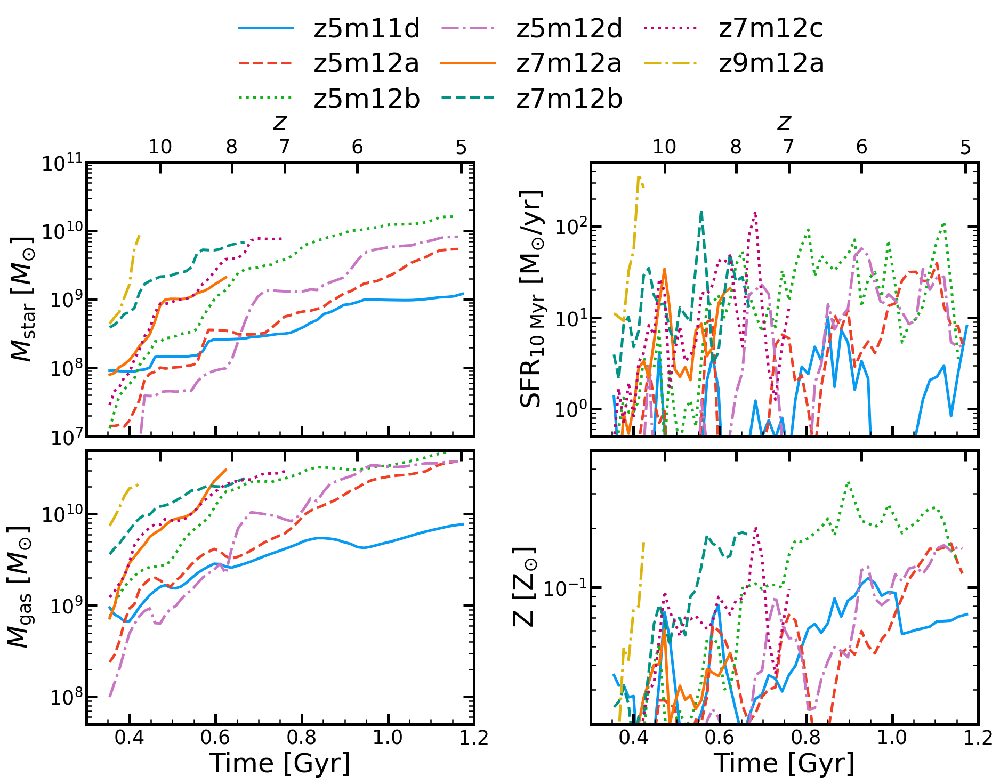

In [65]:
mask=fiducial_mask
prefix = 'fiducial'

foutname = prefix+'_'+str(rvir_frac)+'Rvir_reduced_galaxy_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_star','sfr_10Myr','M_gas','Z']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[1E7,1E11],[5E-1,5E2],[5E7,5E10],[2E-2,0.5],]
x_lim=[0.3,1.2]
y_logs=[True]*len(params); #y_logs[3]=False

# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
#labels = names[mask]
labels = short_names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
gas_sample = 'all'
star_sample='all'
metal_sample = 'cold'
subsample = [star_sample,star_sample,gas_sample,metal_sample,gas_sample,gas_sample,star_sample]
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(data_objs), style=style)
# Setup figure
fig = Figure(len(params), sharex=True, orientation='vertical',ncols=2,yx_ratio=0.9)

for i, y_prop in enumerate(params):

    fig.set_axis(i, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)

    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            if isinstance(subsample, list):
                sample = subsample[j]
            else:
                sample = subsample
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample=sample, statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
        print("These species in sims given:", param_labels)
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    if isinstance(subsample, list):
        sample = subsample[i]
    else:
        sample = subsample

    for j, data in enumerate(data_objs):

        label = labels[j] if labels is not None else None
        # Get time data for x axis
        time_data = data.get_data(time_prop)

        # Check if parameter has subparameters
        if len(param_labels) == 0:
            data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
            fig.plot_line_data(i, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                      linewidth=config.BASE_LINEWIDTH, zorder=-1)
        else:
            data_vals = []
            for sub_param in sub_y_props:
                data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
            data_vals = np.array(data_vals)
            for k in range(np.shape(data_vals)[0]):
                # Ignore properties that are zero for the entire simulation and don't plot them
                if not np.all(data_vals[k, :] == 0):
                    fig.plot_line_data(i, time_data, data_vals[k, :], color=sub_colors[k], linestyle=linestyles[j],
                              linewidth=config.BASE_LINEWIDTH, zorder=-1, label=param_labels[k])
    # Only need to label the separate simulations in the first plot
    if i == 0 and len(data_objs) > 1:
        if outside_legend:
            fig.set_outside_legend(ncol=3)
        else:
            fig.set_axis_legend(i)

fig.save(plot_dir+foutname)


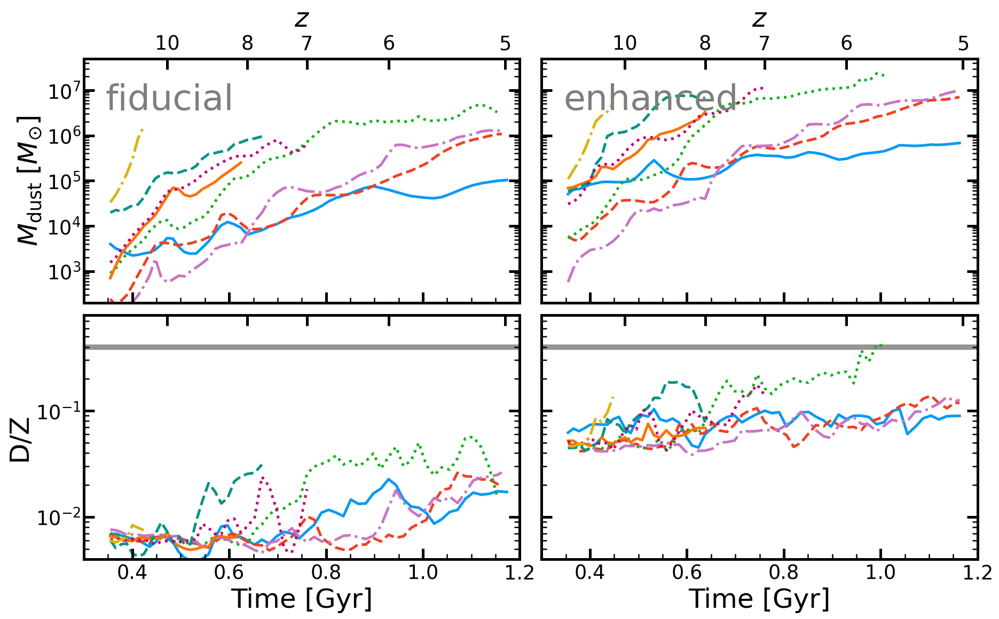

In [67]:
mask= fid_and_enh_mask
prefix = 'fid_and_enh'

foutname = prefix+'_'+str(rvir_frac)+'Rvir_Mdust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_dust','D/Z']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[2E2,5E7],[4E-3,8E-1]]
x_lim=[0.3,1.20]
y_logs=[True]*len(params);

# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
#labels = names[mask]
labels = short_names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsample = ['all','cold']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Add a horizontal line for MW DZ
from matplotlib.lines import Line2D

y_data = [0.4,0.4]
MW_DZ = Line2D(x_lim,y_data, c='xkcd:grey',linewidth=config.BASE_LINEWIDTH*2,zorder=-3)

# Get plot stylization
half_len = len(data_objs)//2
linewidths, colors, linestyles = plt_set.setup_plot_style(half_len, style=style)
colors=colors*2
linestyles=linestyles*2
linewidths*=2
# Lets just make the enhanced subsample large
#linewidths=[0.75*config.BASE_LINEWIDTH]*half_len + [1.5*config.BASE_LINEWIDTH]*half_len
# Setup figure
fig = Figure(2*len(params), sharex='col', sharey='row', orientation='horizontal',ncols=2, yx_ratio=0.8)

for i, y_prop in enumerate(params):
    fig.set_axis(i*2, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)
    fig.set_axis(i*2+1, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)
    if i==0:
        fig.add_text(i*2, .05, .9, 'fiducial', color='xkcd:medium grey', fontsize=config.EXTRA_LARGE_FONT, ha='left',
                    va='top', zorder=1)
        fig.add_text(i*2+1, .05, .9, 'enhanced', color='xkcd:medium grey', fontsize=config.EXTRA_LARGE_FONT, ha='left',
                    va='top', zorder=1)
    sample = subsample[i]

    for j, data in enumerate(data_objs):

        label = labels[j] if labels is not None else None
        # Get time data for x axis
        time_data = data.get_data(time_prop)
        

        data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
        plot_num = i*2+j//half_len
        fig.plot_line_data(plot_num, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                  linewidth=linewidths[j], zorder=-1)

        if y_prop == 'D/Z':
            fig.add_artist(plot_num,MW_DZ)


fig.save(plot_dir+foutname)


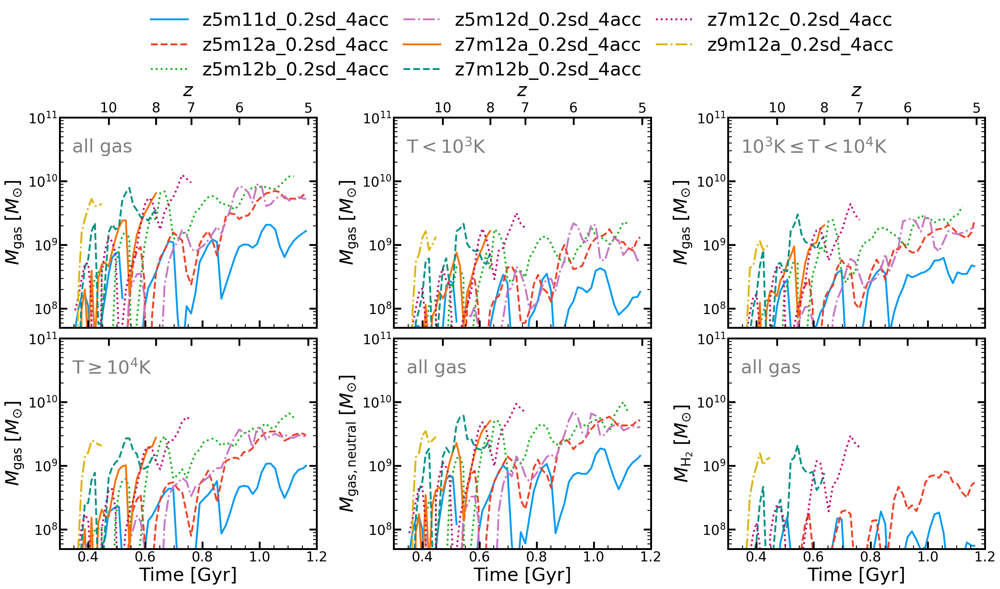

In [229]:
mask=enhanced_mask
prefix = 'enhanced'

foutname = prefix+'_all_galaxy_ISM_phases_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_gas','M_gas','M_gas','M_gas','M_gas_neutral','M_H2']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E7,1E11]]*len(params)
x_lim=[0.3,1.2]
y_logs=[True]*(len(params))

# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
# Labels you to give to the data objects
labels = names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'total'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsample = ['all','cold','warm','hot','all','all']
subsample_labels = ['all gas',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K','all gas','all gas']

# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(data_objs), style=style)
# Setup figure
fig = Figure(len(params), sharex='col', orientation='vertical')
for i, y_prop in enumerate(params):

    fig.set_axis(i, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)

    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            if isinstance(subsample, list):
                sample = subsample[j]
            else:
                sample = subsample
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample=sample, statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
        print("These species in sims given:", param_labels)
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    if isinstance(subsample, list):
        sample = subsample[i]
    else:
        sample = subsample

    fig.add_text(i, .05, .9, subsample_labels[i], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='left',
                va='top', zorder=1)

    for j, data in enumerate(data_objs):

        label = labels[j]
        # Get time data for x axis
        time_data = data.get_data(time_prop)

        # Check if parameter has subparameters
        if len(param_labels) == 0:
            data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
            fig.plot_line_data(i, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                      linewidth=config.BASE_LINEWIDTH, zorder=-1)
        else:
            data_vals = []
            for sub_param in sub_y_props:
                data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
            data_vals = np.array(data_vals)
            for k in range(np.shape(data_vals)[0]):
                # Ignore properties that are zero for the entire simulation and don't plot them
                if not np.all(data_vals[k, :] == 0):
                    fig.plot_line_data(i, time_data, data_vals[k, :], color=sub_colors[k], linestyle=linestyles[j],
                              linewidth=config.BASE_LINEWIDTH, zorder=-1, label=param_labels[k])
    # Only need to label the separate simulations in the first plot
    if i == 0 and len(data_objs) > 1:
        if outside_legend:
            fig.set_outside_legend(ncol=3)
        else:
            fig.set_axis_legend(i)

fig.save(plot_dir+foutname)


### Appendix Plot for z5m12a Reruns

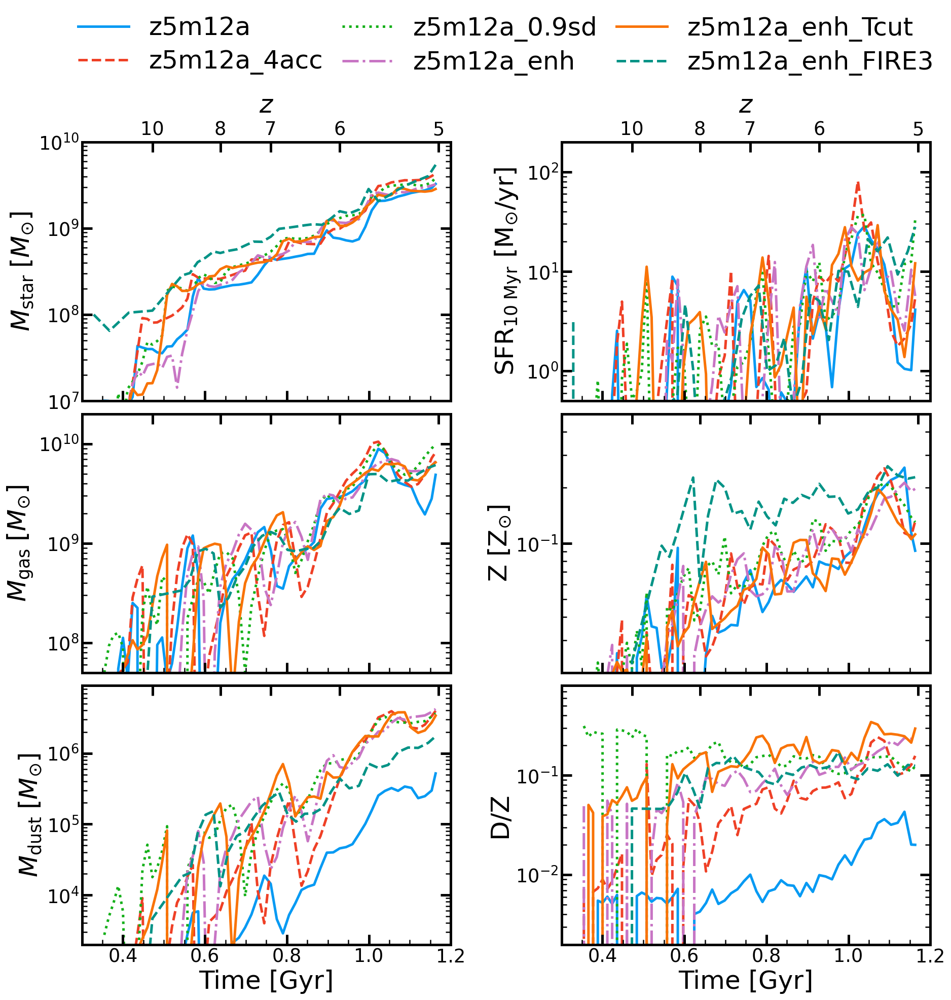

In [231]:
mask=z5m12a_mask
prefix = 'appendix_z5m12a_comparisons'

foutname = prefix+'_'+str(rvir_frac)+'Rvir_reduced_galaxy_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_star','sfr_10Myr','M_gas','Z','M_dust','D/Z']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[1E7,1E10],[5E-1,2E2],[5E7,2E10],[2E-2,0.5],[2E3,9E6],[2E-3,8E-1]]
x_lim=[0.3,1.2]
y_logs=[True]*len(params); #y_logs[3]=False

# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
#labels = names[mask]
labels = short_names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
gas_sample = 'all'
star_sample='all'
metal_sample = 'cold'
subsample = [star_sample,star_sample,gas_sample,metal_sample,gas_sample,metal_sample]
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(data_objs), style=style)
# Setup figure
fig = Figure(len(params), sharex=True, orientation='vertical',ncols=2,yx_ratio=0.9)

for i, y_prop in enumerate(params):

    fig.set_axis(i, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)

    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            if isinstance(subsample, list):
                sample = subsample[j]
            else:
                sample = subsample
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample=sample, statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
        print("These species in sims given:", param_labels)
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    if isinstance(subsample, list):
        sample = subsample[i]
    else:
        sample = subsample

    for j, data in enumerate(data_objs):

        label = labels[j] if labels is not None else None
        # Get time data for x axis
        time_data = data.get_data(time_prop)

        # Check if parameter has subparameters
        if len(param_labels) == 0:
            data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
            fig.plot_line_data(i, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                      linewidth=config.BASE_LINEWIDTH, zorder=-1)
        else:
            data_vals = []
            for sub_param in sub_y_props:
                data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
            data_vals = np.array(data_vals)
            for k in range(np.shape(data_vals)[0]):
                # Ignore properties that are zero for the entire simulation and don't plot them
                if not np.all(data_vals[k, :] == 0):
                    fig.plot_line_data(i, time_data, data_vals[k, :], color=sub_colors[k], linestyle=linestyles[j],
                              linewidth=config.BASE_LINEWIDTH, zorder=-1, label=param_labels[k])
    # Only need to label the separate simulations in the first plot
    if i == 0 and len(data_objs) > 1:
        if outside_legend:
            fig.set_outside_legend(ncol=3)
        else:
            fig.set_axis_legend(i)

fig.save(plot_dir+foutname)


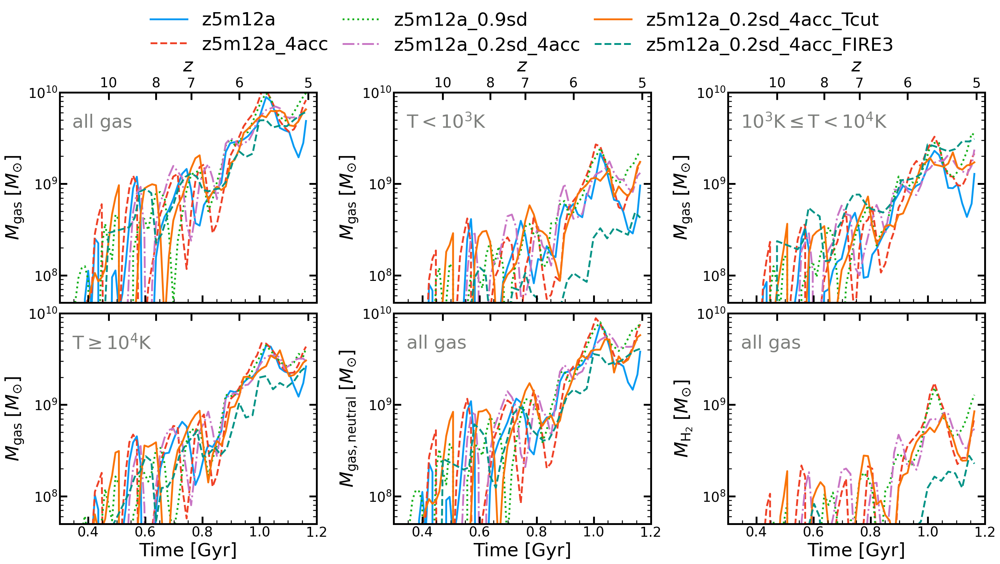

In [230]:
mask=z5m12a_mask
prefix = 'z5m12a_comparisons'

foutname = prefix+'_ISM_phases_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_gas','M_gas','M_gas','M_gas','M_gas_neutral','M_H2']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E7,1E10]]*len(params)
x_lim=[0.3,1.2]
y_logs=[True]*(len(params))

# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
# Labels you to give to the data objects
labels = names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'total'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsample = ['all','cold','warm','hot','all','all']
subsample_labels = ['all gas',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K','all gas','all gas']

# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(data_objs), style=style)
# Setup figure
fig = Figure(len(params), sharex='col', orientation='vertical')
for i, y_prop in enumerate(params):

    fig.set_axis(i, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)

    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            if isinstance(subsample, list):
                sample = subsample[j]
            else:
                sample = subsample
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample=sample, statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
        print("These species in sims given:", param_labels)
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    if isinstance(subsample, list):
        sample = subsample[i]
    else:
        sample = subsample

    fig.add_text(i, .05, .9, subsample_labels[i], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='left',
                va='top', zorder=1)

    for j, data in enumerate(data_objs):

        label = labels[j]
        # Get time data for x axis
        time_data = data.get_data(time_prop)

        # Check if parameter has subparameters
        if len(param_labels) == 0:
            data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
            fig.plot_line_data(i, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                      linewidth=config.BASE_LINEWIDTH, zorder=-1)
        else:
            data_vals = []
            for sub_param in sub_y_props:
                data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
            data_vals = np.array(data_vals)
            for k in range(np.shape(data_vals)[0]):
                # Ignore properties that are zero for the entire simulation and don't plot them
                if not np.all(data_vals[k, :] == 0):
                    fig.plot_line_data(i, time_data, data_vals[k, :], color=sub_colors[k], linestyle=linestyles[j],
                              linewidth=config.BASE_LINEWIDTH, zorder=-1, label=param_labels[k])
    # Only need to label the separate simulations in the first plot
    if i == 0 and len(data_objs) > 1:
        if outside_legend:
            fig.set_outside_legend(ncol=3)
        else:
            fig.set_axis_legend(i)

fig.save(plot_dir+foutname)


### Evolution of metals and dust populations for each galaxy

/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:294: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(), fontsize=rescale_font*config.SMALL_FONT, **kwargs)


spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.


/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:294: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(), fontsize=rescale_font*config.SMALL_FONT, **kwargs)


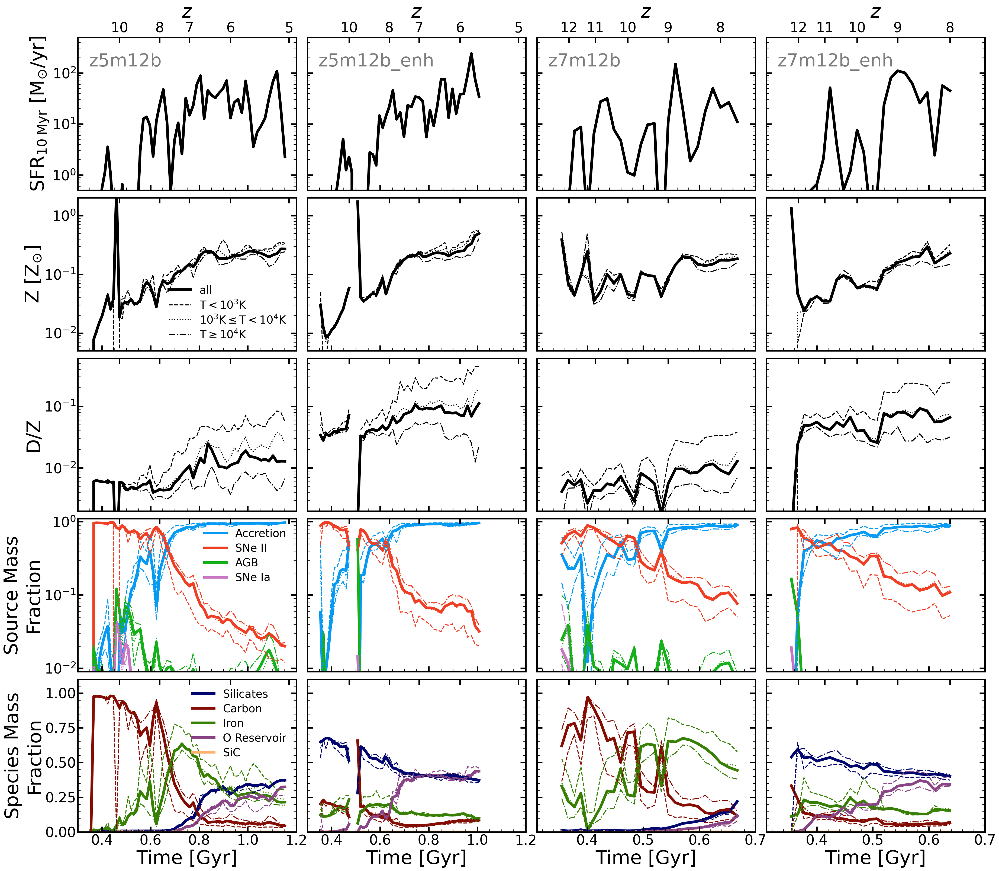

In [43]:
mask = z5m12b_z7m12b_mask
prefix='select_comparison'
x_lims=[[0.3,1.2],[0.31,0.7]]
# x_lims=[[0.3,1.2],[0.3,1.2]]

axis_font_rescale=1.4
legend_font_rescale=1.1

foutname = prefix+'_' + str(rvir_frac)+'Rvir_dust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['sfr_10Myr','Z','D/Z','source_frac','spec_frac']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E-1,5E2],[5E-3,2E0],[2E-3,6E-1],[9E-3,1.1],[0,1.1]]
y_logs=[True]*(len(params)-1)+[False]
# The precompile data objects which house all of the time evolution data
data_objs = sims[mask][[0,2,1,3]]
sim_labels = short_names[mask][[0,2,1,3]]

# The statistic you want to use when plotting quantities that could be averaged
stats = ['median']*len(params)
stats[0]='total';
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsamples = ['all','cold','warm','hot']
subsample_labels = ['all',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(subsamples), style=style)
# Lets just make the first subsample large
linewidths=[2*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH]
# Setup figure
ncols = len(data_objs)
fig = Figure(len(params)*len(data_objs), sharex='col', sharey='row', orientation='horizontal',ncols=ncols)

for i, y_prop in enumerate(params):
    stat = stats[i]
    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample='all', statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    for j, data in enumerate(data_objs):
        axis_num = i*ncols+j
        fig.set_axis(axis_num, time_prop, y_prop, x_lim=x_lims[j//2], y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True, rescale_font=axis_font_rescale)
        if i == 0:
            fig.add_text(axis_num, .05, .9, sim_labels[j], color='xkcd:medium grey', fontsize=config.EXTRA_LARGE_FONT, ha='left',
                        va='top', zorder=1)

        # Get time data for x axis
        time_data = data.get_data(time_prop)
        if stats[i] == 'median':
            for k,sample in enumerate(subsamples):
                # Check if parameter has subparameters
                if len(param_labels) == 0:
                    data_vals = data.get_data(y_prop, subsample=sample, statistic=stats[k])
                    fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[k], label=subsample_labels[k],
                              linewidth=linewidths[k], zorder=-1)
                else:
                    data_vals = []
                    for sub_param in sub_y_props:
                        data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
                    data_vals = np.array(data_vals)
                    for m in range(np.shape(data_vals)[0]):
                        # Ignore properties that are zero for the entire simulation and don't plot them
                        if not np.all(data_vals[m, :] == 0):
                            fig.plot_line_data(axis_num, time_data, data_vals[m, :], color=sub_colors[m], linestyle=linestyles[k],
                                      linewidth=linewidths[k], zorder=-1, label=param_labels[m])
    
                # Only need to label the subsamples in the first plot
                if axis_num == 1*ncols and len(subsamples) > 1:
                    fig.set_axis_legend(axis_num,ncol=1,loc='best',rescale_font=legend_font_rescale)
    
                # If there are subparameters need to make their own legend but only for the first sim
                if len(param_labels) > 0 and j == 0:
                    # param_labels = param_labels[:np.shape(data_vals)[1]]
                    param_lines = []
                    for k, label in enumerate(param_labels):
                        param_lines += [
                            mlines.Line2D([], [], color=sub_colors[k], label=label, linewidth=2*config.BASE_LINEWIDTH)]
                    fig.set_axis_legend(axis_num,handles=param_lines, loc='best', ncol=1,rescale_font=legend_font_rescale)
        else:
            data_vals = data.get_data(y_prop, statistic=stats[i])
            fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[0],
                              linewidth=linewidths[0], zorder=-1)

fig.save(plot_dir+foutname)

/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:294: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(), fontsize=rescale_font*config.SMALL_FONT, **kwargs)


spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.


/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:294: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(), fontsize=rescale_font*config.SMALL_FONT, **kwargs)


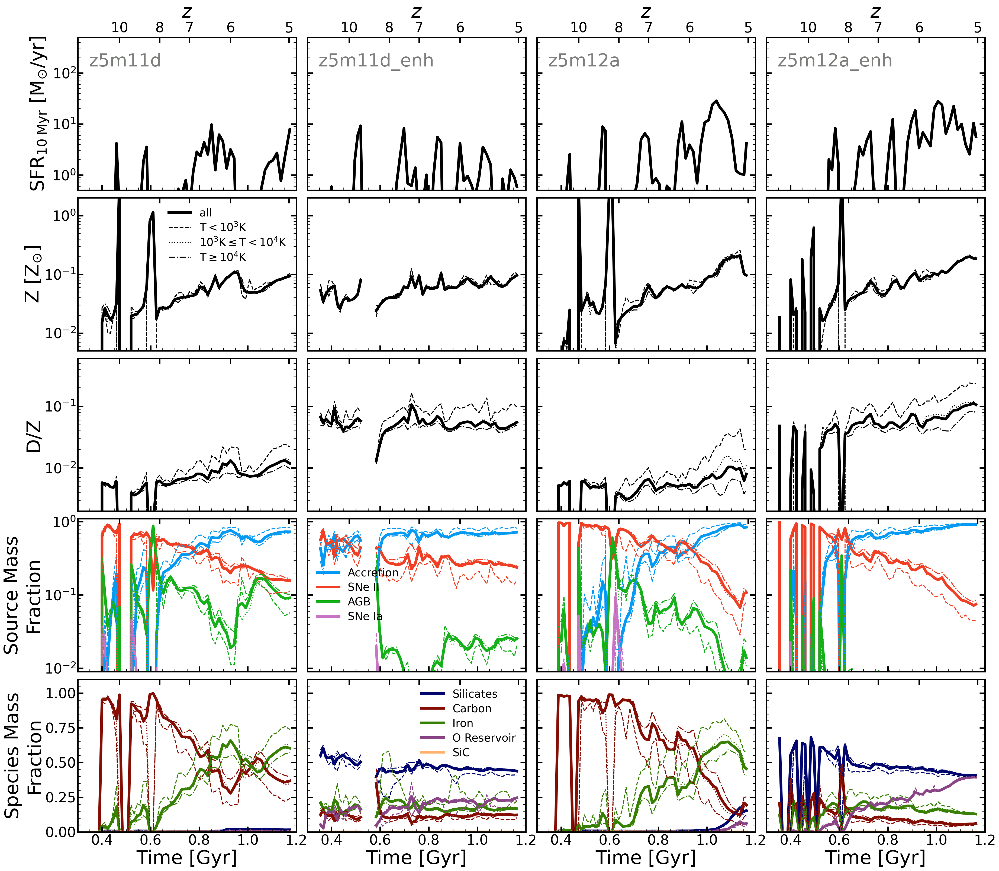

In [44]:
mask = z5m11d_z5m12a_mask
prefix='appendix_comparison1'

x_lims=[[0.3,1.2],[0.3,1.2]]

axis_font_rescale=1.4
legend_font_rescale=1.1

foutname = prefix+'_' + str(rvir_frac)+'Rvir_dust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['sfr_10Myr','Z','D/Z','source_frac','spec_frac']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E-1,5E2],[5E-3,2E0],[2E-3,6E-1],[9E-3,1.1],[0,1.1]]
y_logs=[True]*(len(params)-1)+[False]
# The precompile data objects which house all of the time evolution data
data_objs = sims[mask][[0,2,1,3]]
sim_labels = short_names[mask][[0,2,1,3]]

# The statistic you want to use when plotting quantities that could be averaged
stats = ['median']*len(params)
stats[0]='total';
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsamples = ['all','cold','warm','hot']
subsample_labels = ['all',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(subsamples), style=style)
# Lets just make the first subsample large
linewidths=[2*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH]
# Setup figure
ncols = len(data_objs)
fig = Figure(len(params)*len(data_objs), sharex='col', sharey='row', orientation='horizontal',ncols=ncols)

for i, y_prop in enumerate(params):
    stat=stats[i]
    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample='all', statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    for j, data in enumerate(data_objs):
        axis_num = i*ncols+j
        fig.set_axis(axis_num, time_prop, y_prop, x_lim=x_lims[j//2], y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True, rescale_font=axis_font_rescale)
        if i == 0:
            fig.add_text(axis_num, .05, .9, sim_labels[j], color='xkcd:medium grey', fontsize=config.EXTRA_LARGE_FONT, ha='left',
                        va='top', zorder=1)

        # Get time data for x axis
        time_data = data.get_data(time_prop)
        if stats[i] == 'median':
            for k,sample in enumerate(subsamples):
                # Check if parameter has subparameters
                if len(param_labels) == 0:
                    data_vals = data.get_data(y_prop, subsample=sample, statistic=stats[k])
                    fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[k], label=subsample_labels[k],
                              linewidth=linewidths[k], zorder=-1)
                else:
                    data_vals = []
                    for sub_param in sub_y_props:
                        data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
                    data_vals = np.array(data_vals)
                    for m in range(np.shape(data_vals)[0]):
                        # Ignore properties that are zero for the entire simulation and don't plot them
                        if not np.all(data_vals[m, :] == 0):
                            fig.plot_line_data(axis_num, time_data, data_vals[m, :], color=sub_colors[m], linestyle=linestyles[k],
                                      linewidth=linewidths[k], zorder=-1, label=param_labels[m])
    
                # Only need to label the subsamples in the first plot
                if j == 0 and i == 1 and len(subsamples) > 1:
                    fig.set_axis_legend(axis_num,ncol=1,loc='best',rescale_font=legend_font_rescale)
    
                # If there are subparameters need to make their own legend but only for the first sim
                if len(param_labels) > 0 and j == 1:
                    # param_labels = param_labels[:np.shape(data_vals)[1]]
                    param_lines = []
                    for k, label in enumerate(param_labels):
                        param_lines += [
                            mlines.Line2D([], [], color=sub_colors[k], label=label, linewidth=2*config.BASE_LINEWIDTH)]
                    fig.set_axis_legend(axis_num,handles=param_lines, loc='best', ncol=1,rescale_font=legend_font_rescale)
        else:
            data_vals = data.get_data(y_prop, statistic=stats[i])
            fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[0],
                              linewidth=linewidths[0], zorder=-1)

fig.save(plot_dir+foutname)

/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:294: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(), fontsize=rescale_font*config.SMALL_FONT, **kwargs)


spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.


/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:294: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(), fontsize=rescale_font*config.SMALL_FONT, **kwargs)


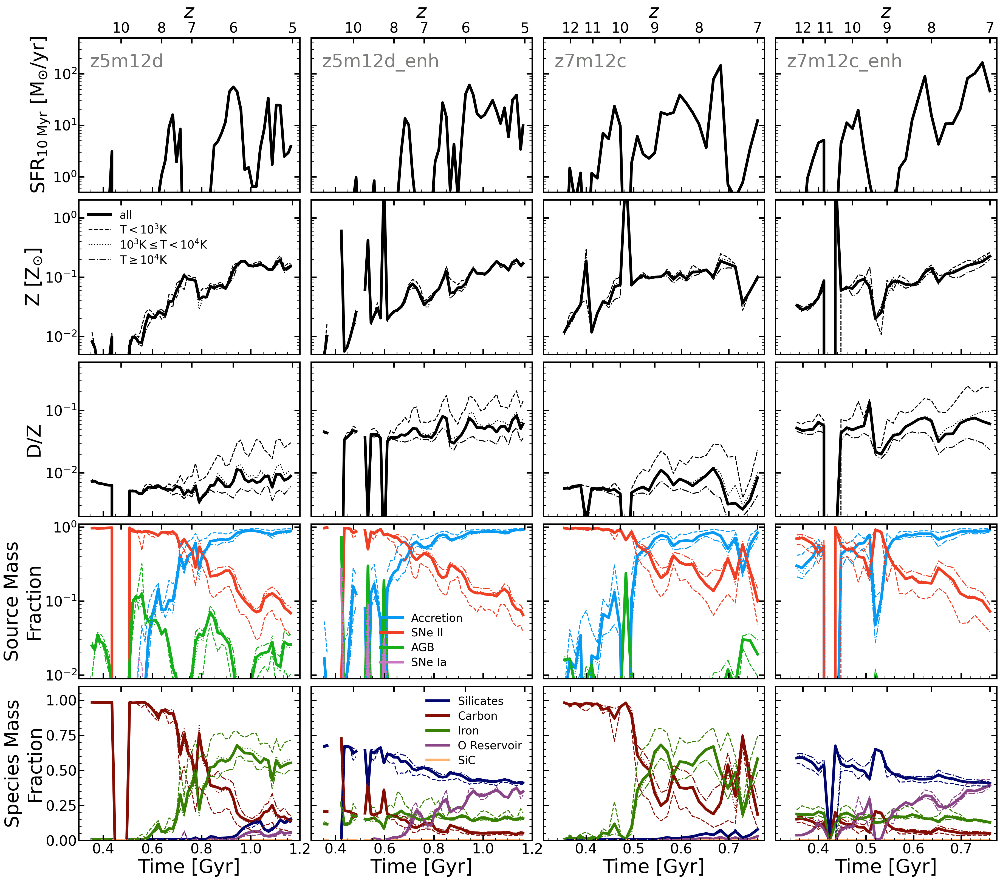

In [45]:
mask = z5m12d_z7m12c_mask
prefix='appendix_comparison2'

x_lims=[[0.3,1.2],[0.31,0.775]]

axis_font_rescale=1.4
legend_font_rescale=1.1

foutname = prefix+'_' + str(rvir_frac)+'Rvir_dust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['sfr_10Myr','Z','D/Z','source_frac','spec_frac']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E-1,5E2],[5E-3,2E0],[2E-3,6E-1],[9E-3,1.1],[0,1.1]]
y_logs=[True]*(len(params)-1)+[False]
# The precompile data objects which house all of the time evolution data
data_objs = sims[mask][[0,2,1,3]]
sim_labels = short_names[mask][[0,2,1,3]]

# The statistic you want to use when plotting quantities that could be averaged
stats = ['median']*len(params)
stats[0]='total';
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsamples = ['all','cold','warm','hot']
subsample_labels = ['all',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(subsamples), style=style)
# Lets just make the first subsample large
linewidths=[2*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH]
# Setup figure
ncols = len(data_objs)
fig = Figure(len(params)*len(data_objs), sharex='col', sharey='row', orientation='horizontal',ncols=ncols)

for i, y_prop in enumerate(params):
    stat=stats[i]
    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample='all', statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    for j, data in enumerate(data_objs):
        axis_num = i*ncols+j
        fig.set_axis(axis_num, time_prop, y_prop, x_lim=x_lims[j//2], y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True, rescale_font=axis_font_rescale)
        if i == 0:
            fig.add_text(axis_num, .05, .9, sim_labels[j], color='xkcd:medium grey', fontsize=config.EXTRA_LARGE_FONT, ha='left',
                        va='top', zorder=1)

        # Get time data for x axis
        time_data = data.get_data(time_prop)
        if stats[i] == 'median':
            for k,sample in enumerate(subsamples):
                # Check if parameter has subparameters
                if len(param_labels) == 0:
                    data_vals = data.get_data(y_prop, subsample=sample, statistic=stats[k])
                    fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[k], label=subsample_labels[k],
                              linewidth=linewidths[k], zorder=-1)
                else:
                    data_vals = []
                    for sub_param in sub_y_props:
                        data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
                    data_vals = np.array(data_vals)
                    for m in range(np.shape(data_vals)[0]):
                        # Ignore properties that are zero for the entire simulation and don't plot them
                        if not np.all(data_vals[m, :] == 0):
                            fig.plot_line_data(axis_num, time_data, data_vals[m, :], color=sub_colors[m], linestyle=linestyles[k],
                                      linewidth=linewidths[k], zorder=-1, label=param_labels[m])
    
                # Only need to label the subsamples in the first plot
                if j == 0 and i == 1 and len(subsamples) > 1:
                    fig.set_axis_legend(axis_num,ncol=1,loc='best',rescale_font=legend_font_rescale)
    
                # If there are subparameters need to make their own legend but only for the first sim
                if len(param_labels) > 0 and j == 1:
                    # param_labels = param_labels[:np.shape(data_vals)[1]]
                    param_lines = []
                    for k, label in enumerate(param_labels):
                        param_lines += [
                            mlines.Line2D([], [], color=sub_colors[k], label=label, linewidth=2*config.BASE_LINEWIDTH)]
                    fig.set_axis_legend(axis_num,handles=param_lines, loc='best', ncol=1,rescale_font=legend_font_rescale)
        else:
            data_vals = data.get_data(y_prop, statistic=stats[i])
            fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[0],
                              linewidth=linewidths[0], zorder=-1)

fig.save(plot_dir+foutname)

/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:294: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(), fontsize=rescale_font*config.SMALL_FONT, **kwargs)


spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.


/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:294: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(), fontsize=rescale_font*config.SMALL_FONT, **kwargs)


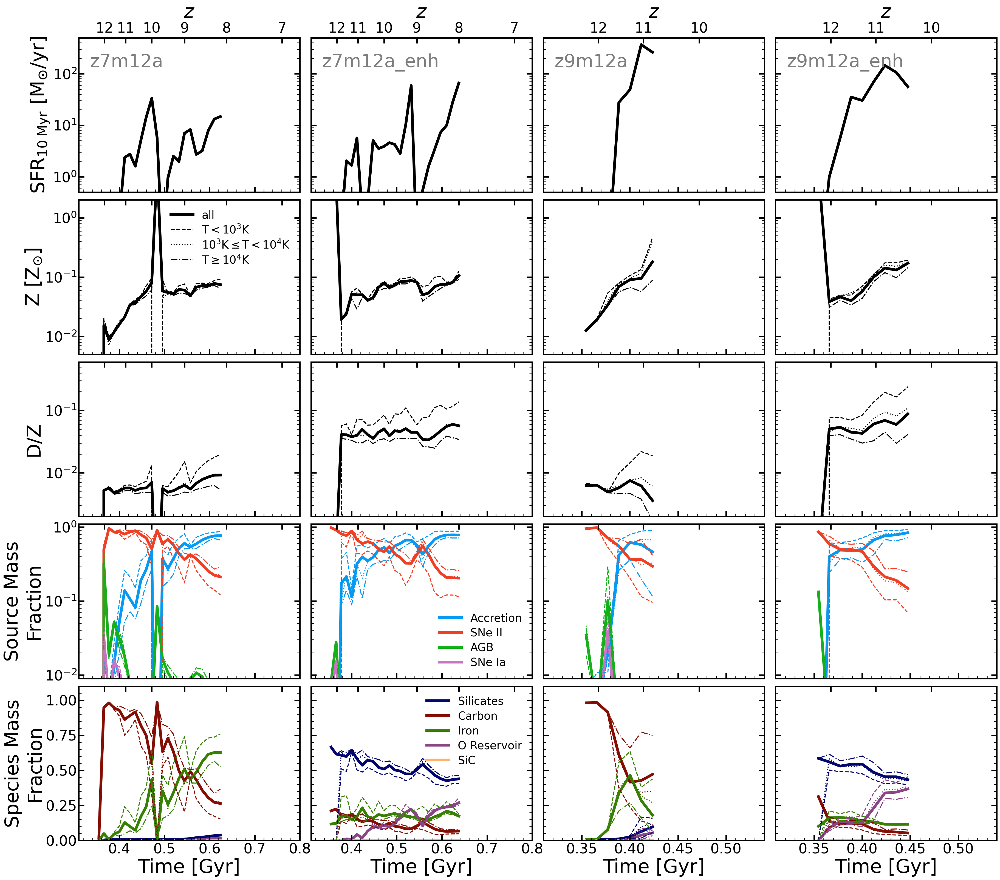

In [46]:
mask = z7m12a_z9m12a_mask
prefix='appendix_comparison3'

x_lims=[[0.31,0.8],[0.31,0.54]]

axis_font_rescale=1.4
legend_font_rescale=1.1

foutname = prefix+'_' + str(rvir_frac)+'Rvir_dust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['sfr_10Myr','Z','D/Z','source_frac','spec_frac']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E-1,5E2],[5E-3,2E0],[2E-3,6E-1],[9E-3,1.1],[0,1.1]]
y_logs=[True]*(len(params)-1)+[False]
# The precompile data objects which house all of the time evolution data
data_objs = sims[mask][[0,2,1,3]]
sim_labels = short_names[mask][[0,2,1,3]]

# The statistic you want to use when plotting quantities that could be averaged
stats = ['median']*len(params)
stats[0]='total';
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsamples = ['all','cold','warm','hot']
subsample_labels = ['all',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(subsamples), style=style)
# Lets just make the first subsample large
linewidths=[2*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH]
# Setup figure
ncols = len(data_objs)
fig = Figure(len(params)*len(data_objs), sharex='col', sharey='row', orientation='horizontal',ncols=ncols)

for i, y_prop in enumerate(params):
    stat=stats[i]
    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample='all', statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    for j, data in enumerate(data_objs):
        axis_num = i*ncols+j
        fig.set_axis(axis_num, time_prop, y_prop, x_lim=x_lims[j//2], y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True, rescale_font=axis_font_rescale)
        if i == 0:
            fig.add_text(axis_num, .05, .9, sim_labels[j], color='xkcd:medium grey', fontsize=config.EXTRA_LARGE_FONT, ha='left',
                        va='top', zorder=1)

        # Get time data for x axis
        time_data = data.get_data(time_prop)
        if stats[i] == 'median':
            for k,sample in enumerate(subsamples):
                # Check if parameter has subparameters
                if len(param_labels) == 0:
                    data_vals = data.get_data(y_prop, subsample=sample, statistic=stats[k])
                    fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[k], label=subsample_labels[k],
                              linewidth=linewidths[k], zorder=-1)
                else:
                    data_vals = []
                    for sub_param in sub_y_props:
                        data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
                    data_vals = np.array(data_vals)
                    for m in range(np.shape(data_vals)[0]):
                        # Ignore properties that are zero for the entire simulation and don't plot them
                        if not np.all(data_vals[m, :] == 0):
                            fig.plot_line_data(axis_num, time_data, data_vals[m, :], color=sub_colors[m], linestyle=linestyles[k],
                                      linewidth=linewidths[k], zorder=-1, label=param_labels[m])
    
                # Only need to label the subsamples in the first plot
                if j == 0 and i == 1 and len(subsamples) > 1:
                    fig.set_axis_legend(axis_num,ncol=1,loc='best',rescale_font=legend_font_rescale)
    
                # If there are subparameters need to make their own legend but only for the first sim
                if len(param_labels) > 0 and j == 1:
                    # param_labels = param_labels[:np.shape(data_vals)[1]]
                    param_lines = []
                    for k, label in enumerate(param_labels):
                        param_lines += [
                            mlines.Line2D([], [], color=sub_colors[k], label=label, linewidth=2*config.BASE_LINEWIDTH)]
                    fig.set_axis_legend(axis_num,handles=param_lines, loc='best', ncol=1,rescale_font=legend_font_rescale)
        else:
            data_vals = data.get_data(y_prop, statistic=stats[i])
            fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[0],
                              linewidth=linewidths[0], zorder=-1)

fig.save(plot_dir+foutname)

In [ ]:
mask = z5fid_mask
prefix='z5_fiducial'

foutname = prefix+'_' + str(rvir_frac)+'Rvir_dust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['Z','D/Z','source_frac','spec_frac']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E-1,5E2][5E-3,2E0],[5E-3,6E-1],[9E-3,1.1],[0,1.1]]
x_lim=[0.3,1.2]
y_logs=[True]*(len(params)-1)+[False]
# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
sim_labels = names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsamples = ['all','cold','warm','hot']
subsample_labels = ['all',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(subsamples), style=style)
# Lets just make the first subsample large
linewidths=[2*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH]
# Setup figure
ncols = len(data_objs)
fig = Figure(len(params)*len(data_objs), sharex='col', sharey='row', orientation='horizontal',ncols=ncols)

for i, y_prop in enumerate(params):
    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample='all', statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    for j, data in enumerate(data_objs):
        axis_num = i*ncols+j
        fig.set_axis(axis_num, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)
        if i == 0:
            fig.add_text(axis_num, .95, .9, sim_labels[j], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='right',
                        va='top', zorder=1)

        # Get time data for x axis
        time_data = data.get_data(time_prop)
        for k,sample in enumerate(subsamples):
            # Check if parameter has subparameters
            if len(param_labels) == 0:
                data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
                fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[k], label=subsample_labels[k],
                          linewidth=linewidths[k], zorder=-1)
            else:
                data_vals = []
                for sub_param in sub_y_props:
                    data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
                data_vals = np.array(data_vals)
                for m in range(np.shape(data_vals)[0]):
                    # Ignore properties that are zero for the entire simulation and don't plot them
                    if not np.all(data_vals[m, :] == 0):
                        fig.plot_line_data(axis_num, time_data, data_vals[m, :], color=sub_colors[m], linestyle=linestyles[k],
                                  linewidth=linewidths[k], zorder=-1, label=param_labels[m])

            # Only need to label the subsamples in the first plot
            if j == 0 and i ==1 and len(subsamples) > 1:
                fig.set_axis_legend(axis_num,ncol=1,loc='best')

            # If there are subparameters need to make their own legend but only for the first sim
            if len(param_labels) > 0 and j == 2:
                # param_labels = param_labels[:np.shape(data_vals)[1]]
                param_lines = []
                for k, label in enumerate(param_labels):
                    param_lines += [
                        mlines.Line2D([], [], color=sub_colors[k], label=label, linewidth=2*config.BASE_LINEWIDTH)]
                fig.set_axis_legend(axis_num,handles=param_lines, loc='best', ncol=1)

fig.save(plot_dir+foutname)

/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:294: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(), fontsize=rescale_font*config.SMALL_FONT, **kwargs)


spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.
spec_ironIncl  is not in the dataset.


/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/figure.py:294: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axis.legend(new_lh.values(), new_lh.keys(), fontsize=rescale_font*config.SMALL_FONT, **kwargs)


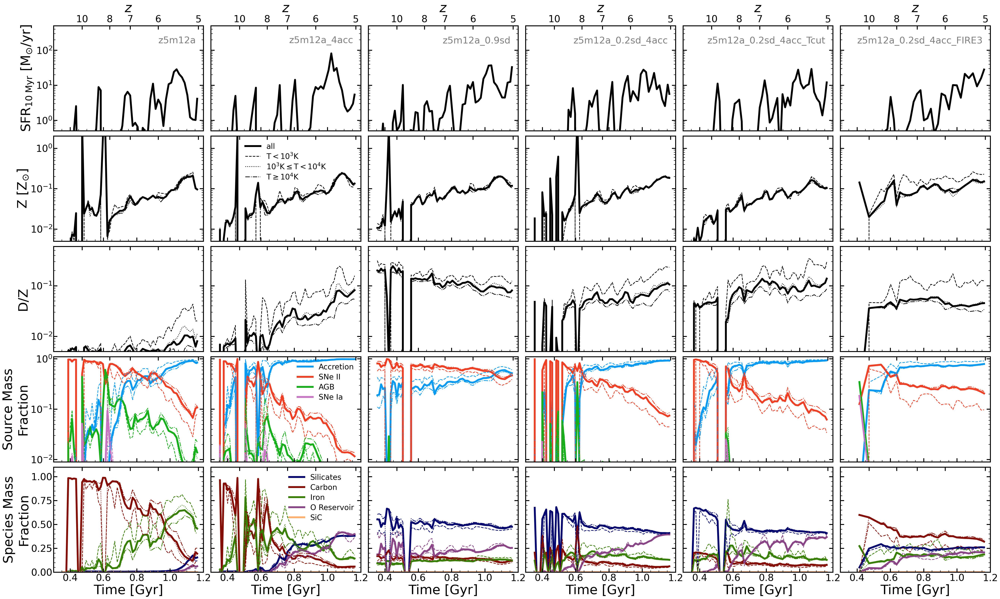

In [51]:
mask = z5m12a_mask
prefix='appendix_z5m12a'

axis_font_rescale=1.4
legend_font_rescale=1.1

foutname = prefix+'_'+str(rvir_frac)+'Rvir_dust_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['sfr_10Myr','Z','D/Z','source_frac','spec_frac']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E-1,5E2],[5E-3,2E0],[5E-3,6E-1],[9E-3,1.1],[0,1.1]]
x_lim=[0.3,1.2]
y_logs=[True]*(len(params)-1)+[False]
# The precompile data objects which house all of the time evolution data
data_objs = sims[mask]
sim_labels = names[mask]
# The statistic you want to use when plotting quantities that could be averaged
stats = ['median']*len(params)
stats[0]='total';
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsample = ['all','cold','warm','hot']
subsample_labels = ['all',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K']
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(subsample), style=style)
# Lets just make the first subsample large
linewidths=[2*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH,0.75*config.BASE_LINEWIDTH]
# Setup figure
ncols = len(data_objs)
fig = Figure(len(params)*len(data_objs), sharex='col', sharey='row', orientation='horizontal',ncols=ncols)

for i, y_prop in enumerate(params):
    stat=stats[i]
    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample='all', statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    for j, data in enumerate(data_objs):
        axis_num = i*ncols+j
        fig.set_axis(axis_num, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True, rescale_font=axis_font_rescale)
        if i == 0:
            fig.add_text(axis_num, .95, .9, sim_labels[j], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='right',
                        va='top', zorder=1)

        # Get time data for x axis
        time_data = data.get_data(time_prop)
        
        if stats[i] == 'median':
            for k,sample in enumerate(subsamples):
                # Check if parameter has subparameters
                if len(param_labels) == 0:
                    data_vals = data.get_data(y_prop, subsample=sample, statistic=stats[k])
                    fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[k], label=subsample_labels[k],
                              linewidth=linewidths[k], zorder=-1)
                else:
                    data_vals = []
                    for sub_param in sub_y_props:
                        data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
                    data_vals = np.array(data_vals)
                    for m in range(np.shape(data_vals)[0]):
                        # Ignore properties that are zero for the entire simulation and don't plot them
                        if not np.all(data_vals[m, :] == 0):
                            fig.plot_line_data(axis_num, time_data, data_vals[m, :], color=sub_colors[m], linestyle=linestyles[k],
                                      linewidth=linewidths[k], zorder=-1, label=param_labels[m])
    
                # Only need to label the subsamples in the first plot
                if j == 1 and i == 1 and len(subsamples) > 1:
                    fig.set_axis_legend(axis_num,ncol=1,loc='upper center',rescale_font=legend_font_rescale)
    
                # If there are subparameters need to make their own legend but only for the first sim
                if len(param_labels) > 0 and j == 1:
                    # param_labels = param_labels[:np.shape(data_vals)[1]]
                    param_lines = []
                    for k, label in enumerate(param_labels):
                        param_lines += [
                            mlines.Line2D([], [], color=sub_colors[k], label=label, linewidth=2*config.BASE_LINEWIDTH)]
                    fig.set_axis_legend(axis_num,handles=param_lines, loc='best', ncol=1,rescale_font=legend_font_rescale)
        else:
            data_vals = data.get_data(y_prop, statistic=stats[i])
            fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[0],
                              linewidth=linewidths[0], zorder=-1)
        
        # for k,sample in enumerate(subsample):
        #     # Check if parameter has subparameters
        #     if len(param_labels) == 0:
        #         data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
        #         fig.plot_line_data(axis_num, time_data, data_vals, color=config.BASE_COLOR, linestyle=linestyles[k], label=subsample_labels[k],
        #                   linewidth=linewidths[k], zorder=-1)
        #     else:
        #         data_vals = []
        #         for sub_param in sub_y_props:
        #             data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
        #         data_vals = np.array(data_vals)
        #         for m in range(np.shape(data_vals)[0]):
        #             # Ignore properties that are zero for the entire simulation and don't plot them
        #             if not np.all(data_vals[m, :] == 0):
        #                 fig.plot_line_data(axis_num, time_data, data_vals[m, :], color=sub_colors[m], linestyle=linestyles[k],
        #                           linewidth=linewidths[k], zorder=-1, label=param_labels[m])

        #     # Only need to label the subsamples in the first plot
        #     if j == 0 and i == 1 and len(subsamples) > 1:
        #         fig.set_axis_legend(axis_num,ncol=1,loc='upper right')

        #     # If there are subparameters need to make their own legend but only for the first sim
        #     if len(param_labels) > 0 and j == 1:
        #         # param_labels = param_labels[:np.shape(data_vals)[1]]
        #         param_lines = []
        #         for k, label in enumerate(param_labels):
        #             param_lines += [
        #                 mlines.Line2D([], [], color=sub_colors[k], label=label, linewidth=2*config.BASE_LINEWIDTH)]
        #         fig.set_axis_legend(axis_num,handles=param_lines, loc='best', ncol=1)

fig.save(plot_dir+foutname)

## Multi-Snap Evolution Plots

Makes various plots of galactic dust properties evolving through redshift.

In [46]:
# Load primary halos for each snapshot at simulation end

halos = []
rvir_frac=0.2
id=-1

# Corresponds to z=5,6,7,8,9,10 for FIRE 2
FIRE2_base_snap_nums = np.array([67,52,41,33,26,20])
FIRE3_base_snap_nums = np.array([42,32,24,18,13,12])

sims=[]

sim_snap_nums = []

for i in range(len(names)):
    snap_dir = snap_dirs[i]; hdir = hdirs[i];final_snap=final_snaps[i];halo_file=halo_histories[i]
    if FIRE_ver[i] == 2:
        snap_nums = FIRE2_base_snap_nums[FIRE2_base_snap_nums<=final_snaps[i]]
    else:
        snap_nums = FIRE3_base_snap_nums[FIRE3_base_snap_nums<=final_snaps[i]]
    # If last sim snap is not at a int value of redshift tack it onto the list
    if len(snap_nums)==0 or final_snaps[i] > snap_nums[0]:
        snap_nums = np.append([final_snaps[i]],snap_nums)
    print(snap_dir)
    buff = Buffer(snap_dir, snap_nums, cosmological=1,halohist_file=halo_file)
    buff.set_halo(mode='AHF', hdir=hdir, rout=rvir_frac, kpc=False)
    buff.load(override=False,increment=2)
    sim_snap_nums+=[snap_nums]
    sims+=[buff]

sims = np.array(sims)
# Need to set to this specific numpy array to have inhomogenous 2D numpy arrays
sim_snap_nums = np.array(sim_snap_nums, dtype=object)


/N/scratch/cchoban/HiZ_dust/z5m11d/output/
Reduced data already exists for the given halo setup so loading that first....
Loading snap 30 ...
For snap 30 using Halo ID 0
Looking for snapshot's corresponding AHF file
AHF file found /N/scratch/cchoban/HiZ_dust/z5m11d/halo/ahf/output/snapshot_030.z8.403.AHF_halos


/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/io/particle.py:487: RuntimeWarning: invalid value encountered in divide
  prop_data = data['dust_spec'][:,0]/data['dust_Z'][:,0]
/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/io/particle.py:489: RuntimeWarning: invalid value encountered in divide
  prop_data = data['dust_spec'][:,1]/data['dust_Z'][:,0]
/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/io/particle.py:492: RuntimeWarning: invalid value encountered in divide
  prop_data = data['dust_spec'][:,2]/data['dust_Z'][:,0]
/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/io/particle.py:495: RuntimeWarning: invalid value encountered in divide
  prop_data = (data['dust_spec'][:,3]+data['dust_spec'][:,5])/data['dust_Z'][:,0]
/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/io/particle.py:500: RuntimeWarning: invalid value encountered in divide
  prop_data = data['dust_spec'][:,4]/

Ptype 4 half mass radius: 9.725180e-01 kpc
Took 7.835 secs to load this snap:
Loading snap 31 ...
For snap 31 using Halo ID 0
Looking for snapshot's corresponding AHF file
AHF file found /N/scratch/cchoban/HiZ_dust/z5m11d/halo/ahf/output/snapshot_031.z8.265.AHF_halos
Ptype 4 half mass radius: 1.099399e+00 kpc
Took 9.287 secs to load this snap:
Loading snap 32 ...
For snap 32 using Halo ID 0
Looking for snapshot's corresponding AHF file
AHF file found /N/scratch/cchoban/HiZ_dust/z5m11d/halo/ahf/output/snapshot_032.z8.130.AHF_halos


/geode2/home/u020/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/io/particle.py:552: RuntimeWarning: divide by zero encountered in log10
  prop_data = 12+np.log10(Fe/H)


Ptype 4 half mass radius: 8.929995e-01 kpc
Took 12.451 secs to load this snap:
Loading snap 33 ...
For snap 33 using Halo ID 0
Looking for snapshot's corresponding AHF file
AHF file found /N/scratch/cchoban/HiZ_dust/z5m11d/halo/ahf/output/snapshot_033.z8.000.AHF_halos
Ptype 4 half mass radius: 9.048789e-01 kpc
Took 12.579 secs to load this snap:
Loading snap 34 ...
For snap 34 using Halo ID 0
Looking for snapshot's corresponding AHF file
AHF file found /N/scratch/cchoban/HiZ_dust/z5m11d/halo/ahf/output/snapshot_034.z7.862.AHF_halos
Ptype 4 half mass radius: 9.279124e-01 kpc
Took 12.952 secs to load this snap:
Loading snap 35 ...
For snap 35 using Halo ID 0
Looking for snapshot's corresponding AHF file
AHF file found /N/scratch/cchoban/HiZ_dust/z5m11d/halo/ahf/output/snapshot_035.z7.727.AHF_halos
Ptype 4 half mass radius: 9.520150e-01 kpc
Took 13.226 secs to load this snap:
Loading snap 36 ...
For snap 36 using Halo ID 0
Looking for snapshot's corresponding AHF file
AHF file found /N/sc

### Make Shareable Data Table

In [83]:
# Load primary halos for each snapshot at simulation end

halos = []
rvir_frac=0.2
id=-1

# Corresponds to z=5,6,7,8,9,10 for FIRE 2
FIRE2_base_snap_nums = np.arange(20,67+1)
FIRE3_base_snap_nums = np.arange(12,42+1)

sims=[]

sim_snap_nums = []

for i in range(len(names)):
    snap_dir = snap_dirs[i]; hdir = hdirs[i];final_snap=final_snaps[i];halo_file=halo_histories[i]
    if FIRE_ver[i] == 2:
        snap_nums = FIRE2_base_snap_nums[FIRE2_base_snap_nums<=final_snaps[i]]
    else:
        snap_nums = FIRE3_base_snap_nums[FIRE3_base_snap_nums<=final_snaps[i]]
    # If last sim snap is not at a int value of redshift tack it onto the list
    if len(snap_nums)==0 or final_snaps[i] > snap_nums[-1]:
        snap_nums = np.append(snap_nums,[final_snaps[i]])
    print(names[i],snap_dir)
    buff = Buffer(snap_dir, snap_nums, cosmological=1,halohist_file=halo_file)
    buff.set_halo(mode='AHF', hdir=hdir, rout=rvir_frac, kpc=False)
    buff.load(override=False,increment=2)
    sim_snap_nums+=[snap_nums]
    sims+=[buff]

sims = np.array(sims)
# Need to set to this specific numpy array to have inhomogenous 2D numpy arrays
sim_snap_nums = np.array(sim_snap_nums, dtype=object)


z5m11d /N/scratch/cchoban/HiZ_dust/z5m11d/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
z5m12a /N/scratch/cchoban/HiZ_dust/z5m12a/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
z5m12b /N/scratch/cchoban/HiZ_dust/z5m12b/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
z5m12d /N/scratch/cchoban/HiZ_dust/z5m12d/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
z7m12a /N/scratch/cchoban/HiZ_dust/z7m12a/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
z7m12b /N/scratch/cchoban/HiZ_dust/z7m12b/output/
Reduced data already exists for the given halo setup so

In [84]:
from astropy.io import ascii
from astropy.table import Table, Column
from astropy import units as u

mask = fid_and_enh_mask
simulations = sims[mask]
sim_snaps = sim_snap_nums[mask]
labels = short_names[mask]
props = ['M_star','M_dust','O/H_gas','D/Z']

criteria=['all','all','ionized','cold']

col_names = ['sim_name','redshift']+props
data_cols = {el:[] for el in col_names}

for j, sim_buff in enumerate(simulations):
    label = labels[j]
    times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
    data_cols['sim_name'] += [label]*len(times)
    data_cols['redshift'] = np.append(data_cols['redshift'],times)
    for i, prop in enumerate(props):
        crit = criteria[i]
        vals = sim_buff.get_data(prop, snap_nums = sim_snaps[j],subsample=crit)
        if 'O/H' in prop:
            vals[vals>0]-=0.2
        data_cols[prop] = np.append(data_cols[prop],vals)

data = Table()
for key in data_cols.keys():
    if 'M_' in key:
        data[key] = Column(data_cols[key], unit=u.Msun)
    else:
        data[key] = Column(data_cols[key])

data.write(plot_dir+'FIRE_HiZ.ecsv', overwrite=True)


### Comparison with and Predictions for Observations

#### Predictions for Relation of Dust Mass and D/Z with Metallicity

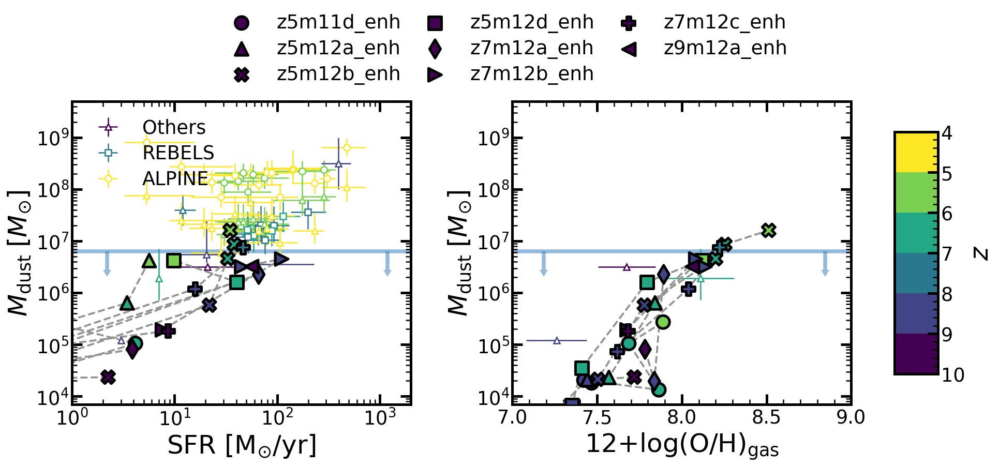

In [15]:
prefix = 'enhanced'
mask = enhanced_mask

foutname=prefix+'_Mdust_vs_SFR_Z.pdf'
x_props = ['sfr','O/H_gas']
y_props=['M_dust','M_dust']
x_lims = [[1,2E3],[7,9]]
y_lims = [[7E3,5E9],[7E3,5E9]]

simulations = sims[mask]
labels = short_names[mask]
sim_snaps = sim_snap_nums[mask]
x_criteria=['all','ionized']
y_criteria='all'
style='color-line'
include_obs='HiZ_compilation'
connect_points=True
time_cmap='viridis_r'
redshift=True
time_range=[4,10]

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(simulations), style=style)

fig = Figure(len(x_props),ncols=2,orientation='horizontal')

norm = mpl.colors.Normalize(time_range[0],time_range[1])
cmap = plt.get_cmap(time_cmap)

# Descretize the colormap so the color changes for each +1 change in redshift
num_times = int(time_range[1]-time_range[0])
times = np.linspace(0,1,num_times)*(time_range[1]-time_range[0])+time_range[0]
colors = cmap(norm(times))
cmap = mpl.colors.ListedColormap(colors)

for i in range(len(x_props)):
    x_lim=x_lims[i]; y_lim=y_lims[i]
    x_prop = x_props[i]
    x_crit = x_criteria[i] if isinstance(x_criteria, list) else x_criteria
    y_prop = y_props[i]
    y_crit = y_criteria[i] if isinstance(y_criteria, list) else y_criteria

    # Set up axis for each plot
    fig.set_axis(i, x_prop, y_prop, x_lim=x_lim, y_lim=y_lim)

    # First plot observational data if applicable
    if include_obs is not None:
        obs_data = Observational_Data(include_obs)
        xprop_data,xprop_err= obs_data.get_data_w_errors(x_prop)
        yprop_data,yprop_err= obs_data.get_data_w_errors(y_prop)
        redshifts= obs_data.get_data('redshift')
        source = obs_data.get_data('source')
        if xprop_data is not None and yprop_data is not None:
            # Have to plot these one by one since errorbar only takes one color at a time
            for k in range(len(redshifts)):
                if source[k] == 'Palla+23': fmt='s';source_label='REBELS';
                elif source[k] == 'Pozzi+21': fmt='o';source_label='ALPINE';
                else: fmt='^';source_label='Others'
                fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                       fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                       ms=config.SMALL_MARKERSIZE**.5, mfc='xkcd:white', zorder=2, label=source_label)
        if i ==0: fig.set_axis_legend(i,ncol=1,loc='upper left')

    if y_prop=='M_dust':
        diagram_linewidth = 1.5*config.BASE_LINEWIDTH
        # Add detection upper limit
        N=30
        upper_x = np.logspace(np.log10(x_lim[0]),np.log10(x_lim[1]),N)
        upper_y = np.full(N,np.power(10,6.8))
        x1 = upper_x[int(N*0.1)]; x2 = upper_x[int(N*0.9)]
        y1 = np.power(10,6.8)
        fig.plot_line_data(i,upper_x,upper_y,color='xkcd:bluish',linestyle='-',zorder=-2, alpha=0.5,linewidth=diagram_linewidth)
        fig.plot_errorbar_data(i, [x1,x2], [y1,y1], y_err=np.power(10,np.log10(y1)-0.25), alpha=0.5,
                                       fmt='o', c='xkcd:bluish',elinewidth=diagram_linewidth, mew=0,
                                       ms=0, mfc='xkcd:bluish', zorder=-3, label=None, uplims=True,capsize=5)

    for j, sim_buff in enumerate(simulations):
        label = labels[j]
        times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
        y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snaps[j])
        x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j],subsample=x_crit)
        fig.plot_scatter_data(i, x_vals, y_vals, label=label, marker=config.MARKER_STYLES[j], c=times, cmap=cmap, norm = norm,
                     s=config.LARGE_MARKERSIZE, edgecolors=config.BASE_COLOR, linewidths=config.LINE_WIDTHS[2], zorder=3)
        if connect_points:
            fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=config.LINE_WIDTHS[3], zorder=2)

#fig.add_colorbar(-1, cbar_prop='redshift', invert_axis=True)
fig.add_outside_colorbar(cbar_prop='redshift', invert_axis=True)
fig.set_outside_legend(ncol=3, fontsize= 0.75*config.LARGE_FONT,bbox_to_anchor= (0.5, 1.03))
fig.save(plot_dir+foutname)

Z is not in the specified date frame
O/H_gas is not in the specified date frame
Z is not in the specified date frame
O/H_gas is not in the specified date frame
Z is not in the specified date frame
O/H is not in the specified date frame


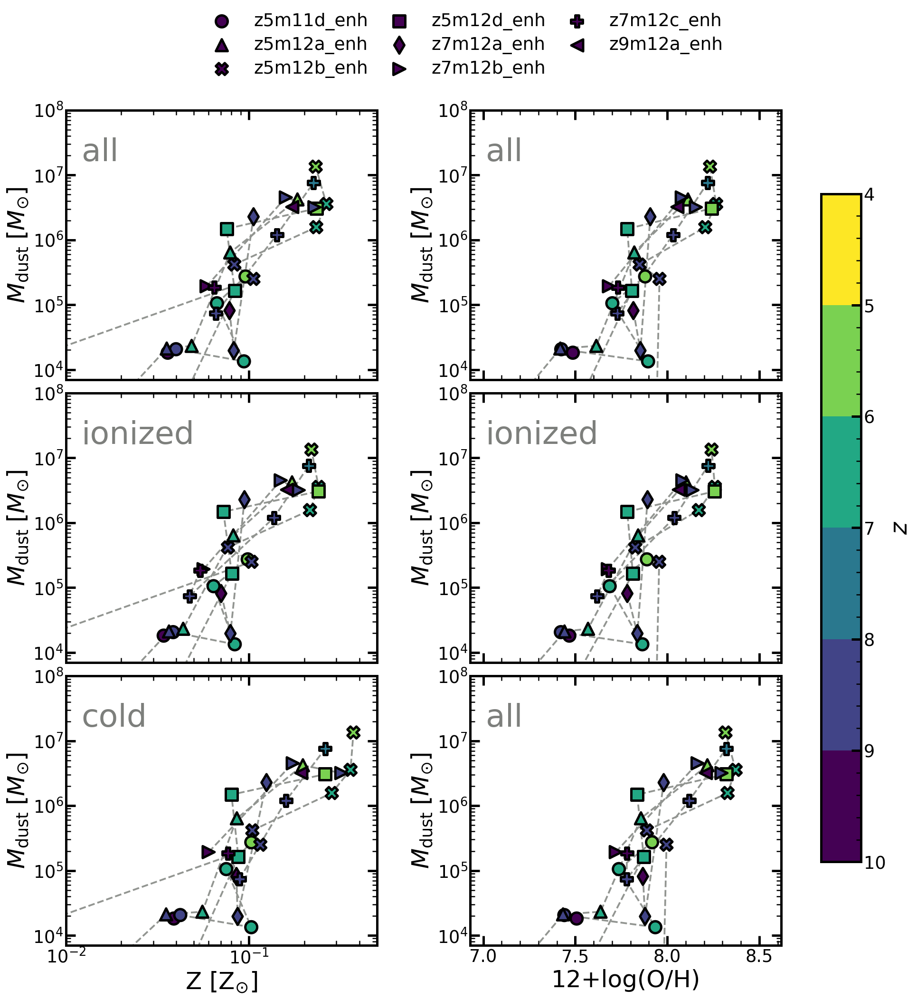

In [27]:
prefix = 'enhanced'
mask = enhanced_mask

foutname=prefix+'_Mdust_vs_Z_definitions.pdf'
x_props = ['Z','O/H_gas','Z','O/H_gas','Z','O/H']
y_props=['M_dust']*len(x_props)
x_lims = [[1E-2,0.5],[6.93,8.62],[1E-2,0.5],[6.93,8.62],[1E-2,0.5],[6.93,8.62]]
y_lims = [[7E3,1E8]]*len(x_props)

simulations = sims[mask]
labels = short_names[mask]
sim_snaps = sim_snap_nums[mask]
x_criteria=['all','all','ionized','ionized','cold','all']
y_criteria='all'
style='color-line'
include_obs='HiZ_compilation'
connect_points=True
time_cmap='viridis_r'
redshift=True
time_range=[4,10]

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(simulations), style=style)

fig = Figure(len(x_props),ncols=2,orientation='horizontal',sharex='col')

norm = mpl.colors.Normalize(time_range[0],time_range[1])
cmap = plt.get_cmap(time_cmap)

# Descretize the colormap so the color changes for each +1 change in redshift
num_times = int(time_range[1]-time_range[0])
times = np.linspace(0,1,num_times)*(time_range[1]-time_range[0])+time_range[0]
colors = cmap(norm(times))
cmap = mpl.colors.ListedColormap(colors)

for i in range(len(x_props)):
    x_prop = x_props[i]
    x_crit = x_criteria[i] if isinstance(x_criteria, list) else x_criteria
    y_prop = y_props[i]
    y_crit = y_criteria[i] if isinstance(y_criteria, list) else y_criteria

    # Set up axis for each plot
    fig.set_axis(i, x_prop, y_prop, x_lim=x_lims[i], y_lim=y_lims[i])

    # First plot observational data if applicable
    if include_obs is not None:
        obs_data = Observational_Data(include_obs)
        xprop_data,xprop_err= obs_data.get_data_w_errors(x_prop)
        yprop_data,yprop_err= obs_data.get_data_w_errors(y_prop)
        redshifts= obs_data.get_data('redshift')
        source = obs_data.get_data('source')
        if xprop_data is not None and yprop_data is not None:
            # Have to plot these one by one since errorbar only takes one color at a time
            for k in range(len(redshifts)):
                if source[k] == 'Palla+23': fmt='s';source_label='REBELS';
                elif source[k] == 'Pozzi+21': fmt='o';source_label='ALPINE';
                else: fmt='^';source_label='Others'
                fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                       fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                       ms=config.SMALL_MARKERSIZE**.5, mfc='xkcd:white', zorder=2, label=source_label)
        if i ==0: fig.set_axis_legend(i,ncol=1,loc='upper left')

    for j, sim_buff in enumerate(simulations):
        label = labels[j]
        times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
        y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snaps[j])
        x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j],subsample=x_crit)
        fig.plot_scatter_data(i, x_vals, y_vals, label=label, marker=config.MARKER_STYLES[j], c=times, cmap=cmap, norm = norm,
                     s=config.LARGE_MARKERSIZE, edgecolors=config.BASE_COLOR, linewidths=config.LINE_WIDTHS[2], zorder=3)
        if connect_points:
            fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=config.LINE_WIDTHS[3], zorder=2)
            
    fig.add_text(i, .05, .9, x_crit, color='xkcd:medium grey', fontsize=config.EXTRA_LARGE_FONT, ha='left',
                    va='top', zorder=1)

#fig.add_colorbar(-1, cbar_prop='redshift', invert_axis=True)
fig.add_outside_colorbar(cbar_prop='redshift', invert_axis=True)
fig.set_outside_legend(ncol=3, fontsize= 0.75*config.LARGE_FONT,bbox_to_anchor= (0.5, 1.03))
fig.save(plot_dir+foutname)

all
cold
D/Z is not in the specified date frame


/tmp/ipykernel_3164508/1028452082.py:85: RuntimeWarning: invalid value encountered in divide
  Z = DTG/DTM; OH = np.log10(Z/Z_solar)+A09_O_abun
/tmp/ipykernel_3164508/1028452082.py:94: RuntimeWarning: invalid value encountered in divide
  Z = DTG/DTM; OH = np.log10(Z/Z_solar)+A09_O_abun


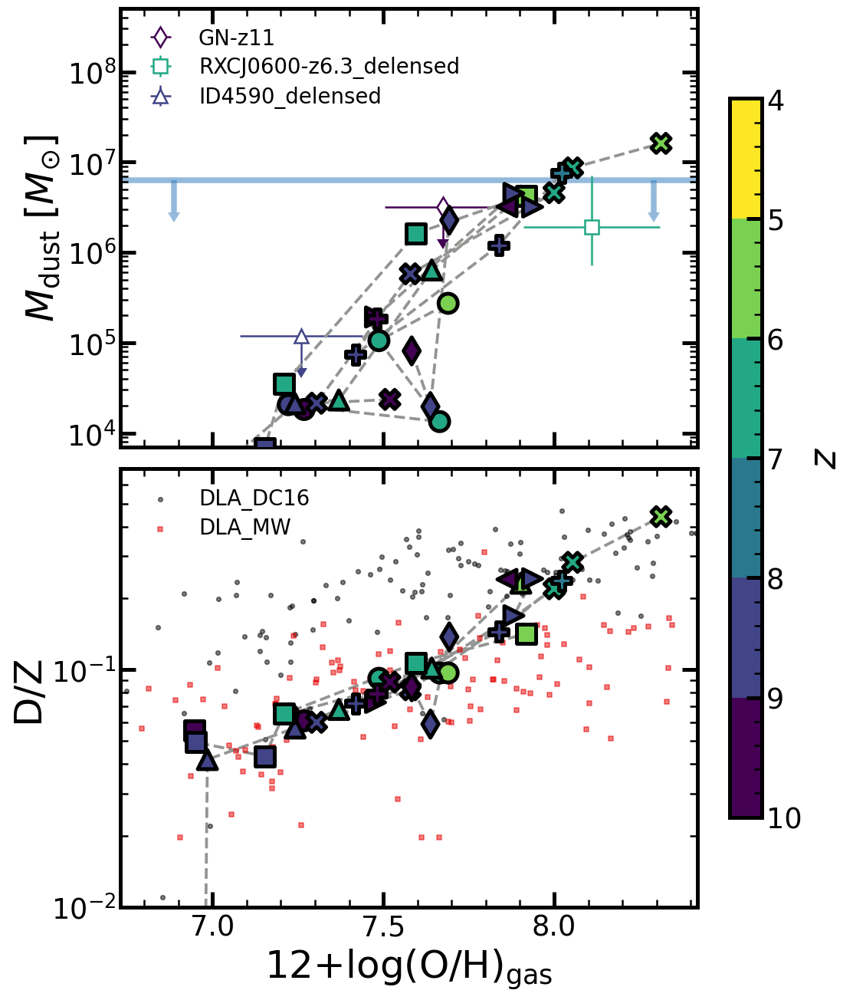

In [70]:
prefix = 'enhanced'
mask = enhanced_mask

foutname=prefix+'_Mdust_scaling_relations.pdf'
x_props = ['O/H_gas','O/H_gas']
y_props=['M_dust','D/Z']
x_lims = [[6.73,8.42],[6.73,8.42]]
y_lims = [[7E3,5E8],[0.01,0.7]]

simulations = sims[mask]
labels = short_names[mask]
sim_snaps = sim_snap_nums[mask]
x_criteria=['ionized','ionized',]
y_criteria=['all','cold']
style='color-line'
include_obs='HiZ_compilation'
connect_points=True
time_cmap='viridis_r'
redshift=True
time_range=[4,10]

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(simulations), style=style)

fig = Figure(len(x_props),ncols=1,sharex='col')

norm = mpl.colors.Normalize(time_range[0],time_range[1])
cmap = plt.get_cmap(time_cmap)

# Descretize the colormap so the color changes for each +1 change in redshift
num_times = int(time_range[1]-time_range[0])
times = np.linspace(0,1,num_times)*(time_range[1]-time_range[0])+time_range[0]
colors = cmap(norm(times))
cmap = mpl.colors.ListedColormap(colors)

for i in range(len(x_props)):
    x_lim=x_lims[i]; y_lim=y_lims[i]
    x_prop = x_props[i]
    x_crit = x_criteria[i] if isinstance(x_criteria, list) else x_criteria
    y_prop = y_props[i]
    y_crit = y_criteria[i] if isinstance(y_criteria, list) else y_criteria
    print(y_crit)

    # Set up axis for each plot
    fig.set_axis(i, x_prop, y_prop, x_lim=x_lim, y_lim=y_lim)

    # First plot observational data if applicable
    if include_obs is not None:
        obs_data = Observational_Data(include_obs)
        xprop_data,xprop_err= obs_data.get_data_w_errors(x_prop)
        yprop_data,yprop_err= obs_data.get_data_w_errors(y_prop)
        redshifts= obs_data.get_data('redshift')
        source = obs_data.get_data('source')
        id = obs_data.get_data('ID')
        if xprop_data is not None and yprop_data is not None:
            # Have to plot these one by one since errorbar only takes one color at a time
            for k in range(len(redshifts)):
                if ~np.isnan(xprop_data[k]) and ~np.isnan(yprop_data[k]):
                    source_label=id[k];
                    if source_label == 'RXCJ0600-z6.3_delensed': fmt = 's'
                    elif source_label == 'ID4590_delensed': fmt = '^'
                    elif source_label == 'GN-z11': fmt = 'd'
                    elif source_label == 'S04950': fmt = '>'
                    else: fmt = 'o'
                    if source_label in ['GN-z11','ID4590_delensed','S04950'] :
                        fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                           fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                           ms=config.SMALL_MARKERSIZE**0.6, mfc='xkcd:white', zorder=2, label=source_label)
                        fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=np.power(10,np.log10(yprop_data[k])-0.25),
                                   fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0,
                                   ms=0, mfc='xkcd:white', zorder=1, label=None, uplims=True,capsize=5)
                    else: 
                        fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                           fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                           ms=config.SMALL_MARKERSIZE**0.6, mfc='xkcd:white', zorder=2, label=source_label)
        if y_prop == 'D/Z':
            # Load in DLA observations
            Z_solar = 0.014; A09_O_abun = 8.73
            obs_dirc = '/N/u/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/observations/data/RomanDuval_2022_DLA/'
            obs_name1 = 'Quiret2016_sample_DTG_DC16.fits'; obs_name2 = 'DeCia2016_sample_DTG_DC16.fits'
            hdul1 = fits.open(obs_dirc+obs_name1); hdul2 = fits.open(obs_dirc+obs_name2)
            DTM = np.append(hdul1[1].data['DTM'],hdul2[1].data['DTM'])
            DTG = np.append(hdul1[1].data['DTG'],hdul2[1].data['DTG'])
            redshifts = np.append(hdul1[1].data['Z_ABS'],hdul2[1].data['Z_ABS'])
            Z = DTG/DTM; OH = np.log10(Z/Z_solar)+A09_O_abun
            # Convert Z to OH for Asplund abundancesabs# Add lines representing the AG89 and Asplund09 abundances
            fig.plot_scatter_data(i,OH,DTM, marker='o',c='xkcd:black', s=config.SMALL_MARKERSIZE**0.6, alpha=0.5, label='DLA_DC16')
    
            obs_name1 = 'Quiret2016_sample_DTG_MW.fits'; obs_name2 = 'DeCia2016_sample_DTG_MW.fits'
            hdul1 = fits.open(obs_dirc+obs_name1); hdul2 = fits.open(obs_dirc+obs_name2)
            DTM = np.append(hdul1[1].data['DTM'],hdul2[1].data['DTM'])
            DTG = np.append(hdul1[1].data['DTG'],hdul2[1].data['DTG'])
            redshifts = np.append(hdul1[1].data['Z_ABS'],hdul2[1].data['Z_ABS'])
            Z = DTG/DTM; OH = np.log10(Z/Z_solar)+A09_O_abun
            # Convert Z to OH for Asplund abundancesabs# Add lines representing the AG89 and Asplund09 abundances
            fig.plot_scatter_data(i,OH,DTM, marker='s',c='xkcd:red', s=config.SMALL_MARKERSIZE**0.6, alpha=0.5,label='DLA_MW')

            # obs_name1 = 'Quiret2016_sample_DTG_SMC.fits'; obs_name2 = 'DeCia2016_sample_DTG_SMC.fits'
            # hdul1 = fits.open(obs_dirc+obs_name1); hdul2 = fits.open(obs_dirc+obs_name2)
            # DTM = np.append(hdul1[1].data['DTM'],hdul2[1].data['DTM'])
            # DTG = np.append(hdul1[1].data['DTG'],hdul2[1].data['DTG'])
            # redshifts = np.append(hdul1[1].data['Z_ABS'],hdul2[1].data['Z_ABS'])
            # Z = DTG/DTM; OH = np.log10(Z/Z_solar)+A09_O_abun
            # # Convert Z to OH for Asplund abundancesabs# Add lines representing the AG89 and Asplund09 abundances
            # fig.plot_scatter_data(i,OH,DTM, marker='o',c='xkcd:red', s=config.SMALL_MARKERSIZE**0.6, alpha=0.5,label='DLA_SMC')

            # obs_name1 = 'Quiret2016_sample_DTG_LMC.fits'; obs_name2 = 'DeCia2016_sample_DTG_LMC.fits'
            # hdul1 = fits.open(obs_dirc+obs_name1); hdul2 = fits.open(obs_dirc+obs_name2)
            # DTM = np.append(hdul1[1].data['DTM'],hdul2[1].data['DTM'])
            # DTG = np.append(hdul1[1].data['DTG'],hdul2[1].data['DTG'])
            # redshifts = np.append(hdul1[1].data['Z_ABS'],hdul2[1].data['Z_ABS'])
            # Z = DTG/DTM; OH = np.log10(Z/Z_solar)+A09_O_abun
            # # Convert Z to OH for Asplund abundancesabs# Add lines representing the AG89 and Asplund09 abundances
            # fig.plot_scatter_data(i,OH,DTM, marker='o',c='xkcd:green', s=config.SMALL_MARKERSIZE**0.6, alpha=0.5,label='DLA_LMC')
                        
                    
        fig.set_axis_legend(i,ncol=1,loc='upper left', rescale_font=0.75)

    if y_prop=='M_dust':
        diagram_linewidth = 1.5*config.BASE_LINEWIDTH
        # Add detection upper limit
        N=30
        upper_x = np.logspace(np.log10(x_lim[0]),np.log10(x_lim[1]),N)
        upper_y = np.full(N,np.power(10,6.8))
        x1 = upper_x[int(N*0.1)]; x2 = upper_x[int(N*0.9)]
        y1 = np.power(10,6.8)
        fig.plot_line_data(i,upper_x,upper_y,color='xkcd:bluish',linestyle='-',zorder=-2, alpha=0.5,linewidth=diagram_linewidth)
        fig.plot_errorbar_data(i, [x1,x2], [y1,y1], y_err=np.power(10,np.log10(y1)-0.25), alpha=0.5,
                                       fmt='o', c='xkcd:bluish',elinewidth=diagram_linewidth, mew=0,
                                       ms=0, mfc='xkcd:bluish', zorder=-3, label=None, uplims=True,capsize=5)

    
    for j, sim_buff in enumerate(simulations):
        label = labels[j]
        times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
        y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snaps[j],subsample=y_crit)
        x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j],subsample=x_crit)
        
        # Need to offset O/H between d
        if 'O/H' in x_prop:
            x_vals-=0.2
        fig.plot_scatter_data(i, x_vals, y_vals, label=label, marker=config.MARKER_STYLES[j], c=times, cmap=cmap, norm = norm,
                     s=config.LARGE_MARKERSIZE, edgecolors=config.BASE_COLOR, linewidths=config.LINE_WIDTHS[2], zorder=3)
        if connect_points:
            fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=config.LINE_WIDTHS[3], zorder=2)
            

#fig.add_colorbar(-1, cbar_prop='redshift', invert_axis=True)
fig.add_outside_colorbar(cbar_prop='redshift', invert_axis=True)
#fig.set_outside_legend(ncol=3, fontsize= 0.75*config.LARGE_FONT,bbox_to_anchor= (0.5, 1.03))
fig.save(plot_dir+foutname)

/tmp/ipykernel_3164508/849519140.py:10: RuntimeWarning: invalid value encountered in divide
  Z = DTG/DTM


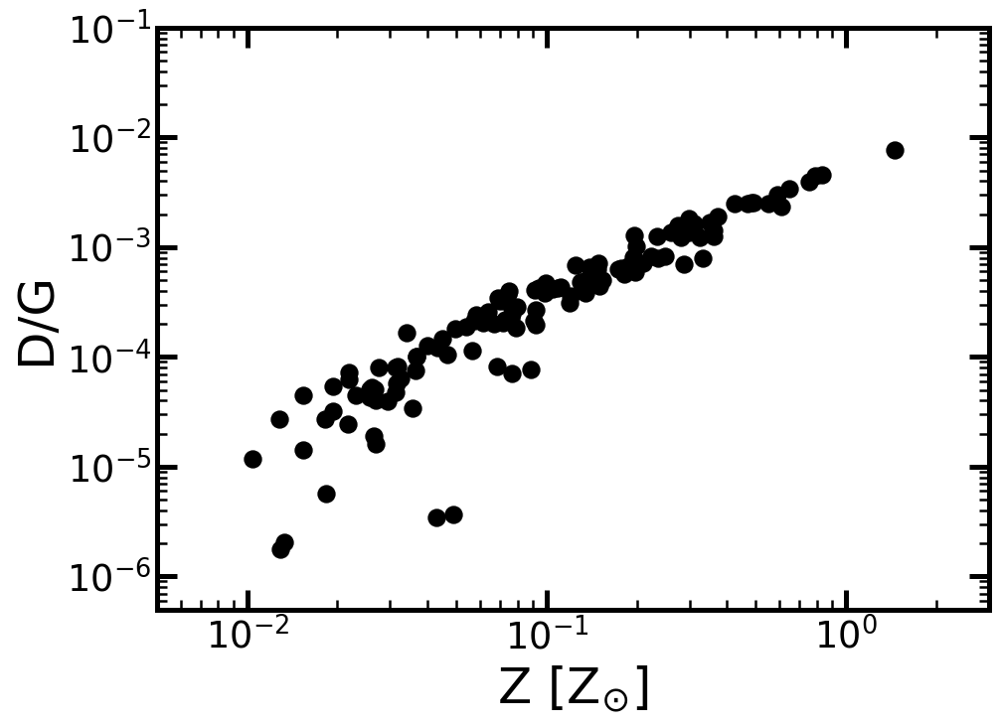

In [60]:
obs_dirc = '/N/u/cchoban/BigRed200/codes/crc_scripts/src/crc_scripts/observations/data/RomanDuval_2022_DLA/'
obs_name = 'Quiret2016_sample_DTG_DC16.fits'
hdul = fits.open(obs_dirc+obs_name)
DTM = hdul[1].data['DTM']
DTG = hdul[1].data['DTG']
obs_name = 'DeCia2016_sample_DTG_DC16.fits'
hdul = fits.open(obs_dirc+obs_name)
DTM = np.append(DTM,hdul[1].data['DTM'])
DTG = np.append(DTG,hdul[1].data['DTG'])
Z = DTG/DTM
# Convert Z to OH for Asplund abundancesabs# Add lines representing the AG89 and Asplund09 abundances
Z_solar = 0.014
A09_O_abun = 8.73
OH = np.log10(Z/Z_solar)+A09_O_abun



fig = Figure(1)
fig.set_axis(0,'Z','D/G',x_lim=[5E-3,3E0],y_lim=[5E-7,1E-1])

fig.plot_scatter_data(0,Z/Z_solar,DTG, marker='o')

### Plot $M_{dust}$ vs $M_{star}$ Relation

This requires loading in data from both the central part of the galaxy and all of the galactic halo and so is a bit complicated.

In [10]:
# Load primary halos for each snapshot at simulation end
# Corresponds to z=5,6,7,8,9,10 for FIRE 2
FIRE2_base_snap_nums = np.array([67,52,41,33,26,20])
FIRE3_base_snap_nums = np.array([42,32,24,18,13,12])


rvir_frac=1
sims_Rvir=[]
sim_snap_nums = []

for i in range(len(names)):
    snap_dir = snap_dirs[i]; hdir = hdirs[i];final_snap=final_snaps[i];halo_file=halo_histories[i]
    if FIRE_ver[i] == 2:
        snap_nums = FIRE2_base_snap_nums[FIRE2_base_snap_nums<=final_snaps[i]]
    else:
        snap_nums = FIRE3_base_snap_nums[FIRE3_base_snap_nums<=final_snaps[i]]
    # If last sim snap is not at a int value of redshift tack it onto the list
    if len(snap_nums)==0 or final_snaps[i] > snap_nums[0]:
        snap_nums = np.append([final_snaps[i]],snap_nums)
    print(snap_dir)
    buff = Buffer(snap_dir, snap_nums, cosmological=1,halohist_file=halo_file)
    buff.set_halo(mode='AHF', hdir=hdir, rout=rvir_frac, kpc=False)
    buff.load(override=False,increment=2)
    sim_snap_nums+=[snap_nums]
    sims_Rvir+=[buff]

sims_Rvir = np.array(sims_Rvir)

rvir_frac=0.2
sims_lowRvir=[]
sim_snap_nums = []

for i in range(len(names)):
    snap_dir = snap_dirs[i]; hdir = hdirs[i];final_snap=final_snaps[i];halo_file=halo_histories[i]
    if FIRE_ver[i] == 2:
        snap_nums = FIRE2_base_snap_nums[FIRE2_base_snap_nums<=final_snaps[i]]
    else:
        snap_nums = FIRE3_base_snap_nums[FIRE3_base_snap_nums<=final_snaps[i]]
    # If last sim snap is not at a int value of redshift tack it onto the list
    if len(snap_nums)==0 or final_snaps[i] > snap_nums[0]:
        snap_nums = np.append([final_snaps[i]],snap_nums)
    print(snap_dir)
    buff = Buffer(snap_dir, snap_nums, cosmological=1,halohist_file=halo_file)
    buff.set_halo(mode='AHF', hdir=hdir, rout=rvir_frac, kpc=False)
    buff.load(override=False,increment=2)
    sim_snap_nums+=[snap_nums]
    sims_lowRvir+=[buff]

sims_lowRvir = np.array(sims_lowRvir)

# Need to set to this specific numpy array to have inhomogenous 2D numpy arrays
sim_snap_nums = np.array(sim_snap_nums, dtype=object)


/N/scratch/cchoban/HiZ_dust/z5m11d/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z5m12a/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z5m12b/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z5m12d/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z7m12a/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z7m12b/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing 

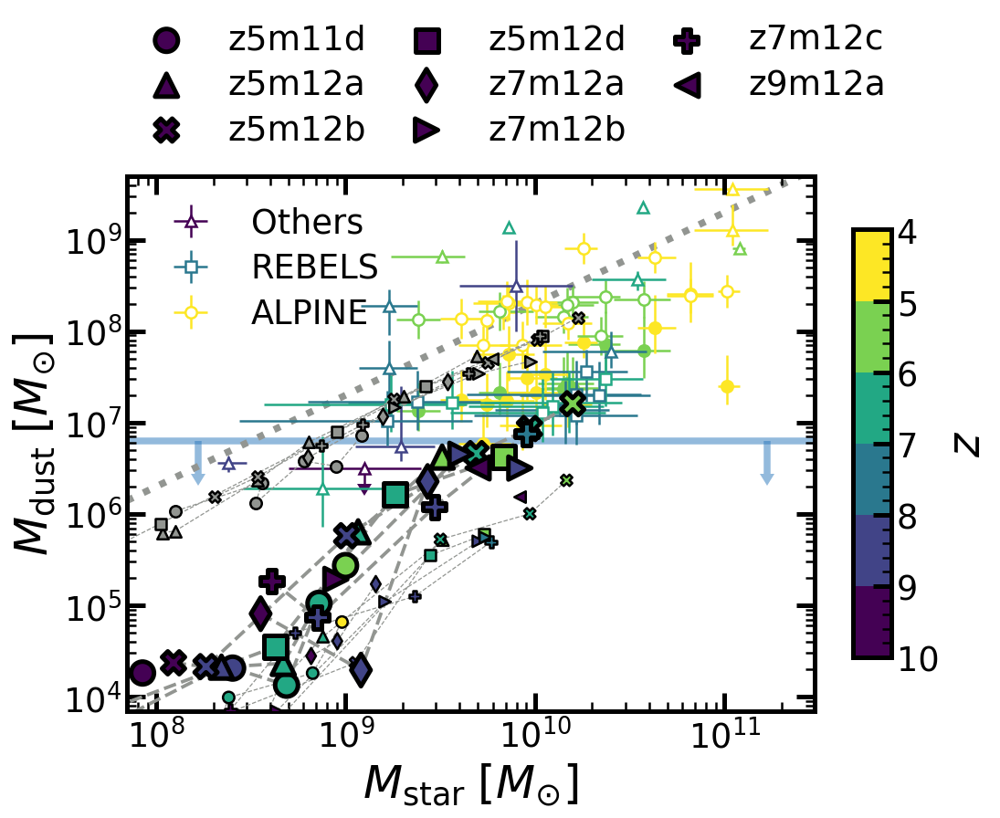

In [47]:
prefix = 'comparison'
mask = fid_and_enh_mask

foutname=prefix+'_'+str(rvir_frac)+'Rvir_Mstar_vs_Mdust_w_1Rvir_upperbound.pdf'
x_props = ['M_star']
y_props=['M_dust']
x_lims = [[7E7,3E11]]
y_lims = [[7E3,5E9]]

lowRvir_simulations = sims_lowRvir[mask]
Rvir_simulations = sims_Rvir[mask]
labels = short_names[mask]
sim_snaps = sim_snap_nums[mask]
x_criteria='all'
y_criteria='all'
style='color-line'
include_obs='HiZ_compilation'
connect_points=True
time_cmap='viridis_r'
redshift=True
time_range=[4,10]

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(lowRvir_simulations), style=style)

fig = Figure(len(x_props),ncols=1,sharex='col')

norm = mpl.colors.Normalize(time_range[0],time_range[1])
cmap = plt.get_cmap(time_cmap)

# Descretize the colormap so the color changes for each +1 change in redshift
num_times = int(time_range[1]-time_range[0])
times = np.linspace(0,1,num_times)*(time_range[1]-time_range[0])+time_range[0]
colors = cmap(norm(times))
cmap = mpl.colors.ListedColormap(colors)

for i in range(len(x_props)):
    x_prop = x_props[i]
    x_crit = x_criteria[i] if isinstance(x_criteria, list) else x_criteria
    y_prop = y_props[i]
    y_crit = y_criteria[i] if isinstance(y_criteria, list) else y_criteria

    # Set up axis for each plot
    fig.set_axis(i, x_prop, y_prop, x_lim=x_lims[i], y_lim=y_lims[i])

    # First plot observational data if applicable
    if include_obs is not None:
        obs_data = Observational_Data(include_obs)
        xprop_data,xprop_err= obs_data.get_data_w_errors(x_prop)
        yprop_data,yprop_err= obs_data.get_data_w_errors(y_prop)
        redshifts= obs_data.get_data('redshift')
        source = obs_data.get_data('source')
        # Have to plot these one by one since errorbar only takes one color at a time
        for k in range(len(redshifts)):
            alpha=1;zorder=0;mfc='xkcd:white'
            if source[k] == 'Palla+23': fmt='s';source_label='REBELS';
            elif source[k] == 'Pozzi+21': fmt='o';source_label='ALPINE';
            elif source[k] == 'Sommovigo+22': fmt='o';source_label=None;alpha=1;zorder=-1;mfc=cmap(norm(redshifts[k]))
            else: fmt='^';source_label='Others'
            if source[k] in ['Fudamoto+23','Fujimoto+24']:
                fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                   fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                   ms=config.SMALL_MARKERSIZE**.5, mfc=mfc, zorder=zorder, label=source_label)
                fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=np.power(10,np.log10(yprop_data[k])-0.5),
                                   fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0,
                                   ms=0, mfc=mfc, zorder=zorder-1, label=None, uplims=True,capsize=5)
            else:
                fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                   fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                   ms=config.SMALL_MARKERSIZE**.5, mfc=mfc, zorder=zorder, label=source_label,alpha=alpha)
    if i ==0: fig.set_axis_legend(i,ncol=1,loc='upper left')

    diagram_linewidth = 1.5*config.BASE_LINEWIDTH
    # Also include a metal yields upper limit
    upper_x = np.logspace(np.log10(x_lims[0][0]),np.log10(x_lims[0][1]),30)
    upper_y = 0.02*upper_x
    fig.plot_line_data(i,upper_x,upper_y,color='xkcd:grey',linestyle=':',zorder=-1,linewidth=diagram_linewidth)

    # Add detection upper limit
    N=30
    upper_x = np.logspace(np.log10(x_lims[0][0]),np.log10(x_lims[0][1]),N)
    upper_y = np.full(N,np.power(10,6.8))
    x1 = upper_x[int(N*0.1)]; x2 = upper_x[int(N*0.9)]
    y1 = np.power(10,6.8)
    fig.plot_line_data(i,upper_x,upper_y,color='xkcd:bluish',linestyle='-',zorder=-2, alpha=0.5,linewidth=diagram_linewidth)
    fig.plot_errorbar_data(i, [x1,x2], [y1,y1], y_err=np.power(10,np.log10(y1)-0.25), alpha=0.5,
                                   fmt=fmt, c='xkcd:bluish',elinewidth=diagram_linewidth, mew=0,
                                   ms=0, mfc=mfc, zorder=-3, label=None, uplims=True,capsize=5)

    half_len = len(lowRvir_simulations)//2
    for j, sim_buff in enumerate(lowRvir_simulations):
        if j < half_len:
            label = None
            marker=config.MARKER_STYLES[j]
            alpha=1
            s=config.SMALL_MARKERSIZE
            m_linewidth = config.LINE_WIDTHS[4]
            linewidth=config.LINE_WIDTHS[5]
        else:
            label=labels[j-half_len]
            marker=config.MARKER_STYLES[j-half_len]
            alpha=1
            s=config.LARGE_MARKERSIZE
            m_linewidth = config.LINE_WIDTHS[2]
            linewidth=config.LINE_WIDTHS[3]

        times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
        y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snaps[j])
        x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j])
        fig.plot_scatter_data(i, x_vals, y_vals, label=label, marker=marker, c=times, cmap=cmap, norm=norm,
                     s=s, edgecolors=config.BASE_COLOR, linewidths=m_linewidth, zorder=3, alpha=alpha)
        if connect_points:
            fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=linewidth, zorder=2, alpha=alpha)

        # Also include upper bound with D/Z=0.6
        if j >= half_len:
            sim_buff = Rvir_simulations[j]
            label=None
            alpha=1
            s=config.SMALL_MARKERSIZE
            m_linewidth = config.LINE_WIDTHS[4]
            linewidth=config.LINE_WIDTHS[5]

            times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
            y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snaps[j])
            x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j])
            y_vals = sim_buff.get_data('M_metals', snap_nums = sim_snaps[j])*0.6
            fig.plot_scatter_data(i, x_vals, y_vals, marker=marker, c='xkcd:grey',
                         s=s, edgecolors=config.BASE_COLOR, linewidths=m_linewidth, zorder=2, alpha=alpha)
            if connect_points:
                fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=linewidth, zorder=1, alpha=alpha)
    

#fig.add_colorbar(-1, cbar_prop='redshift', invert_axis=True)
fig.add_outside_colorbar(cbar_prop='redshift', invert_axis=True)
fig.set_outside_legend(ncol=3, fontsize= 0.75*config.LARGE_FONT,bbox_to_anchor= (0.5, 1.03))
fig.save(plot_dir+foutname)

### Plot $M_{dust}$ vs $SFR$ Relation


In [197]:
# Load primary halos for each snapshot selecting times when SFR is high to match observations
# Snapshot nums will vary between each sim so first need to load in everything
min_SFR = 0.1

rvir_frac=1
sims_Rvir=[]
sim_snap_nums = []

for i in range(len(names)):
    snap_dir = snap_dirs[i]; hdir = hdirs[i];final_snap=final_snaps[i];halo_file=halo_histories[i]
    first_snap = first_snaps[i]
    snap_nums = list(range(first_snap,final_snaps[i]+1))
    print(snap_dir)
    buff = Buffer(snap_dir, snap_nums, cosmological=1,halohist_file=halo_file)
    buff.set_halo(mode='AHF', hdir=hdir, rout=rvir_frac, kpc=False)
    buff.load(override=False,increment=2)
    sim_snap_nums+=[snap_nums]
    sims_Rvir+=[buff]

sims_Rvir = np.array(sims_Rvir)

rvir_frac=0.2
sims_lowRvir=[]
sim_snap_nums = []

for i in range(len(names)):
    snap_dir = snap_dirs[i]; hdir = hdirs[i];final_snap=final_snaps[i];halo_file=halo_histories[i]
    first_snap = first_snaps[i]
    snap_nums = list(range(first_snap,final_snaps[i]+1))
    print(snap_dir)
    buff = Buffer(snap_dir, snap_nums, cosmological=1,halohist_file=halo_file)
    buff.set_halo(mode='AHF', hdir=hdir, rout=rvir_frac, kpc=False)
    buff.load(override=False,increment=2)
    sim_snap_nums+=[snap_nums]
    sims_lowRvir+=[buff]

sims_lowRvir = np.array(sims_lowRvir)

# Need to set to this specific numpy array to have inhomogenous 2D numpy arrays
sim_snap_nums = np.array(sim_snap_nums, dtype=object)


/N/scratch/cchoban/HiZ_dust/z5m11d/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z5m12a/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z5m12b/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z5m12d/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z7m12a/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/HiZ_dust/z7m12b/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing 

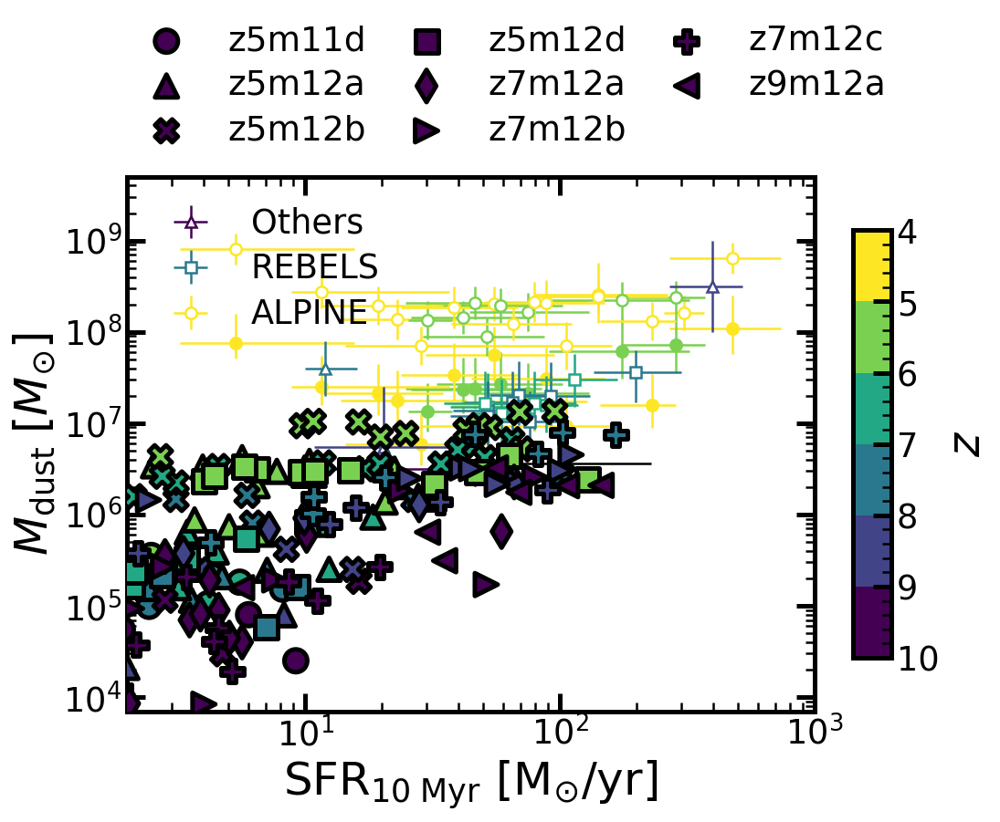

In [200]:
prefix = 'comparison'
mask = fid_and_enh_mask

foutname=prefix+'_'+str(rvir_frac)+'Rvir_SFR10_vs_Mdust_w_1Rvir_upperbound_all.pdf'
x_props = ['sfr_10Myr']
y_props=['M_dust']
x_lims = [[2,1E3]]
y_lims = [[7E3,5E9]]

lowRvir_simulations = sims_lowRvir[mask]
Rvir_simulations = sims_Rvir[mask]
labels = short_names[mask]
sim_snaps = sim_snap_nums[mask]
x_criteria='all'
y_criteria='all'
style='color-line'
include_obs='HiZ_compilation'
connect_points=False
time_cmap='viridis_r'
redshift=True
time_range=[4,10]

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(lowRvir_simulations), style=style)

fig = Figure(len(x_props),ncols=1,sharex='col')

norm = mpl.colors.Normalize(time_range[0],time_range[1])
cmap = plt.get_cmap(time_cmap)

# Descretize the colormap so the color changes for each +1 change in redshift
num_times = int(time_range[1]-time_range[0])
times = np.linspace(0,1,num_times)*(time_range[1]-time_range[0])+time_range[0]
colors = cmap(norm(times))
cmap = mpl.colors.ListedColormap(colors)

for i in range(len(x_props)):
    x_prop = x_props[i]
    x_crit = x_criteria[i] if isinstance(x_criteria, list) else x_criteria
    y_prop = y_props[i]
    y_crit = y_criteria[i] if isinstance(y_criteria, list) else y_criteria

    # Set up axis for each plot
    fig.set_axis(i, x_prop, y_prop, x_lim=x_lims[i], y_lim=y_lims[i])

    # First plot observational data if applicable
    if include_obs is not None:
        obs_data = Observational_Data(include_obs)
        xprop_data,xprop_err= obs_data.get_data_w_errors('sfr')
        yprop_data,yprop_err= obs_data.get_data_w_errors(y_prop)
        redshifts= obs_data.get_data('redshift')
        source = obs_data.get_data('source')
        # Have to plot these one by one since errorbar only takes one color at a time
        for k in range(len(redshifts)):
            alpha=1;zorder=0;mfc='xkcd:white'
            if source[k] == 'Palla+23': fmt='s';source_label='REBELS';
            elif source[k] == 'Pozzi+21': fmt='o';source_label='ALPINE';
            elif source[k] == 'Sommovigo+22': fmt='o';source_label=None;alpha=1;zorder=-1;mfc=cmap(norm(redshifts[k]))
            else: fmt='^';source_label='Others'
            if xprop_data is not None and yprop_data is not None:
                if source[k] == 'Fudamoto+23':
                    fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                       fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                       ms=config.SMALL_MARKERSIZE**.5, mfc=mfc, zorder=zorder, label=source_label)
                    fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=np.power(10,np.log10(yprop_data[k])-0.5),
                                       fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0,
                                       ms=0, mfc=mfc, zorder=zorder-1, label=None, uplims=True,capsize=5)
                else:
                    fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                       fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                       ms=config.SMALL_MARKERSIZE**.5, mfc=mfc, zorder=zorder, label=source_label,alpha=alpha)
    if i ==0: fig.set_axis_legend(i,ncol=1,loc='upper left')

    half_len = len(lowRvir_simulations)//2
    for j, sim_buff in enumerate(lowRvir_simulations):
        if j < half_len:
            continue
            label = None
            marker=config.MARKER_STYLES[j]
            alpha=1
            s=config.SMALL_MARKERSIZE
            m_linewidth = config.LINE_WIDTHS[4]
            linewidth=config.LINE_WIDTHS[5]
        else:
            label=labels[j-half_len]
            marker=config.MARKER_STYLES[j-half_len]
            alpha=1
            s=config.LARGE_MARKERSIZE
            m_linewidth = config.LINE_WIDTHS[2]
            linewidth=config.LINE_WIDTHS[3]

        times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
        y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snaps[j])
        x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j])
        
        SFR_mask = x_vals>=min_SFR
        x_vals=x_vals[SFR_mask]; y_vals=y_vals[SFR_mask];times=times[SFR_mask]
        
        fig.plot_scatter_data(i, x_vals, y_vals, label=label, marker=marker, c=times, cmap=cmap, norm=norm,
                     s=s, edgecolors=config.BASE_COLOR, linewidths=m_linewidth, zorder=3, alpha=alpha)
        if connect_points:
            fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=linewidth, zorder=2, alpha=alpha)

        # # Also include upper bound with D/Z=0.6
        # if j >= half_len:
        #     sim_buff = Rvir_simulations[j]
        #     label=None
        #     alpha=1
        #     s=config.SMALL_MARKERSIZE
        #     m_linewidth = config.LINE_WIDTHS[4]
        #     linewidth=config.LINE_WIDTHS[5]

        #     times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
        #     x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j])
        #     y_vals = sim_buff.get_data('M_metals', snap_nums = sim_snaps[j])*0.6

        #     SFR_mask = x_vals>=min_SFR
        #     x_vals=x_vals[SFR_mask]; y_vals=y_vals[SFR_mask];times=times[SFR_mask]
            
        #     fig.plot_scatter_data(i, x_vals, y_vals, marker=marker, c='xkcd:grey',
        #                  s=s, edgecolors=config.BASE_COLOR, linewidths=m_linewidth, zorder=2, alpha=alpha)
        #     if connect_points:
        #         fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=linewidth, zorder=1, alpha=alpha)
    

#fig.add_colorbar(-1, cbar_prop='redshift', invert_axis=True)
fig.add_outside_colorbar(cbar_prop='redshift', invert_axis=True)
fig.set_outside_legend(ncol=3, fontsize= 0.75*config.LARGE_FONT,bbox_to_anchor= (0.5, 1.03))
fig.save(plot_dir+foutname)

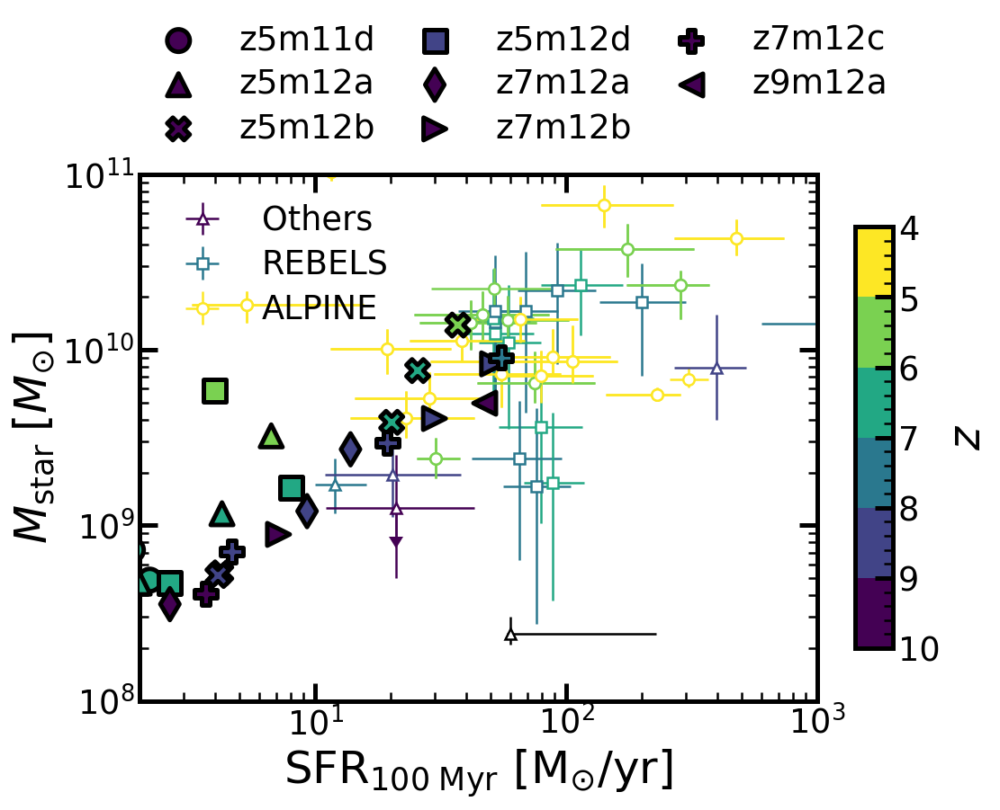

In [193]:
prefix = 'comparison'
mask = fid_and_enh_mask

foutname=prefix+'_'+str(rvir_frac)+'Rvir_SFR_vs_Mstar_w_1Rvir_upperbound.pdf'
min_SFR=0.1
x_props = ['sfr_100Myr']
y_props=['M_star']
x_lims = [[2,1E3]]
y_lims = [[1E8,1E11]]

lowRvir_simulations = sims_lowRvir[mask]
Rvir_simulations = sims_Rvir[mask]
labels = short_names[mask]
sim_snaps = sim_snap_nums[mask]
x_criteria='all'
y_criteria='all'
style='color-line'
include_obs='HiZ_compilation'
connect_points=False
time_cmap='viridis_r'
redshift=True
time_range=[4,10]

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(lowRvir_simulations), style=style)

fig = Figure(len(x_props),ncols=1,sharex='col')

norm = mpl.colors.Normalize(time_range[0],time_range[1])
cmap = plt.get_cmap(time_cmap)

# Descretize the colormap so the color changes for each +1 change in redshift
num_times = int(time_range[1]-time_range[0])
times = np.linspace(0,1,num_times)*(time_range[1]-time_range[0])+time_range[0]
colors = cmap(norm(times))
cmap = mpl.colors.ListedColormap(colors)

for i in range(len(x_props)):
    x_prop = x_props[i]
    x_crit = x_criteria[i] if isinstance(x_criteria, list) else x_criteria
    y_prop = y_props[i]
    y_crit = y_criteria[i] if isinstance(y_criteria, list) else y_criteria

    # Set up axis for each plot
    fig.set_axis(i, x_prop, y_prop, x_lim=x_lims[i], y_lim=y_lims[i])

    # First plot observational data if applicable
    if include_obs is not None:
        obs_data = Observational_Data(include_obs)
        xprop_data,xprop_err= obs_data.get_data_w_errors('sfr')
        yprop_data,yprop_err= obs_data.get_data_w_errors(y_prop)
        redshifts= obs_data.get_data('redshift')
        source = obs_data.get_data('source')
        # Have to plot these one by one since errorbar only takes one color at a time
        for k in range(len(redshifts)):
            alpha=1;zorder=0;mfc='xkcd:white'
            if source[k] == 'Palla+23': fmt='s';source_label='REBELS';
            elif source[k] == 'Pozzi+21': fmt='o';source_label='ALPINE';
            elif source[k] == 'Sommovigo+22': fmt='o';source_label=None;alpha=1;zorder=-1;mfc=cmap(norm(redshifts[k]))
            else: fmt='^';source_label='Others'
            if xprop_data is not None and yprop_data is not None:
                if source[k] == 'Fudamoto+23':
                    fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                       fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                       ms=config.SMALL_MARKERSIZE**.5, mfc=mfc, zorder=zorder, label=source_label)
                    fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=np.power(10,np.log10(yprop_data[k])-0.5),
                                       fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0,
                                       ms=0, mfc=mfc, zorder=zorder-1, label=None, uplims=True,capsize=5)
                else:
                    fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                       fmt=fmt, c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                       ms=config.SMALL_MARKERSIZE**.5, mfc=mfc, zorder=zorder, label=source_label,alpha=alpha)
    if i ==0: fig.set_axis_legend(i,ncol=1,loc='upper left')

    half_len = len(lowRvir_simulations)//2
    for j, sim_buff in enumerate(lowRvir_simulations):
        if j < half_len:
            continue
            label = None
            marker=config.MARKER_STYLES[j]
            alpha=1
            s=config.SMALL_MARKERSIZE
            m_linewidth = config.LINE_WIDTHS[4]
            linewidth=config.LINE_WIDTHS[5]
        else:
            label=labels[j-half_len]
            marker=config.MARKER_STYLES[j-half_len]
            alpha=1
            s=config.LARGE_MARKERSIZE
            m_linewidth = config.LINE_WIDTHS[2]
            linewidth=config.LINE_WIDTHS[3]

        times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
        y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snaps[j])
        x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j])
        
        SFR_mask = x_vals>=min_SFR
        x_vals=x_vals[SFR_mask]; y_vals=y_vals[SFR_mask];times=times[SFR_mask]
        
        fig.plot_scatter_data(i, x_vals, y_vals, label=label, marker=marker, c=times, cmap=cmap, norm=norm,
                     s=s, edgecolors=config.BASE_COLOR, linewidths=m_linewidth, zorder=3, alpha=alpha)
        if connect_points:
            fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=linewidth, zorder=2, alpha=alpha)

        # # Also include upper bound with D/Z=0.6
        # if j >= half_len:
        #     sim_buff = Rvir_simulations[j]
        #     label=None
        #     alpha=1
        #     s=config.SMALL_MARKERSIZE
        #     m_linewidth = config.LINE_WIDTHS[4]
        #     linewidth=config.LINE_WIDTHS[5]

        #     times = sim_buff.get_data('redshift', snap_nums = sim_snaps[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snaps[j])
        #     x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snaps[j])
        #     y_vals = sim_buff.get_data('M_metals', snap_nums = sim_snaps[j])*0.6

        #     SFR_mask = x_vals>=min_SFR
        #     print(len(x_vals[SFR_mask]))
        #     x_vals=x_vals[SFR_mask]; y_vals=y_vals[SFR_mask];times=times[SFR_mask]
            
        #     fig.plot_scatter_data(i, x_vals, y_vals, marker=marker, c='xkcd:grey',
        #                  s=s, edgecolors=config.BASE_COLOR, linewidths=m_linewidth, zorder=2, alpha=alpha)
        #     if connect_points:
        #         fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=linewidth, zorder=1, alpha=alpha)
    

#fig.add_colorbar(-1, cbar_prop='redshift', invert_axis=True)
fig.add_outside_colorbar(cbar_prop='redshift', invert_axis=True)
fig.set_outside_legend(ncol=3, fontsize= 0.75*config.LARGE_FONT,bbox_to_anchor= (0.5, 1.03))
fig.save(plot_dir+foutname)

### Make same plot for z5m12a reruns

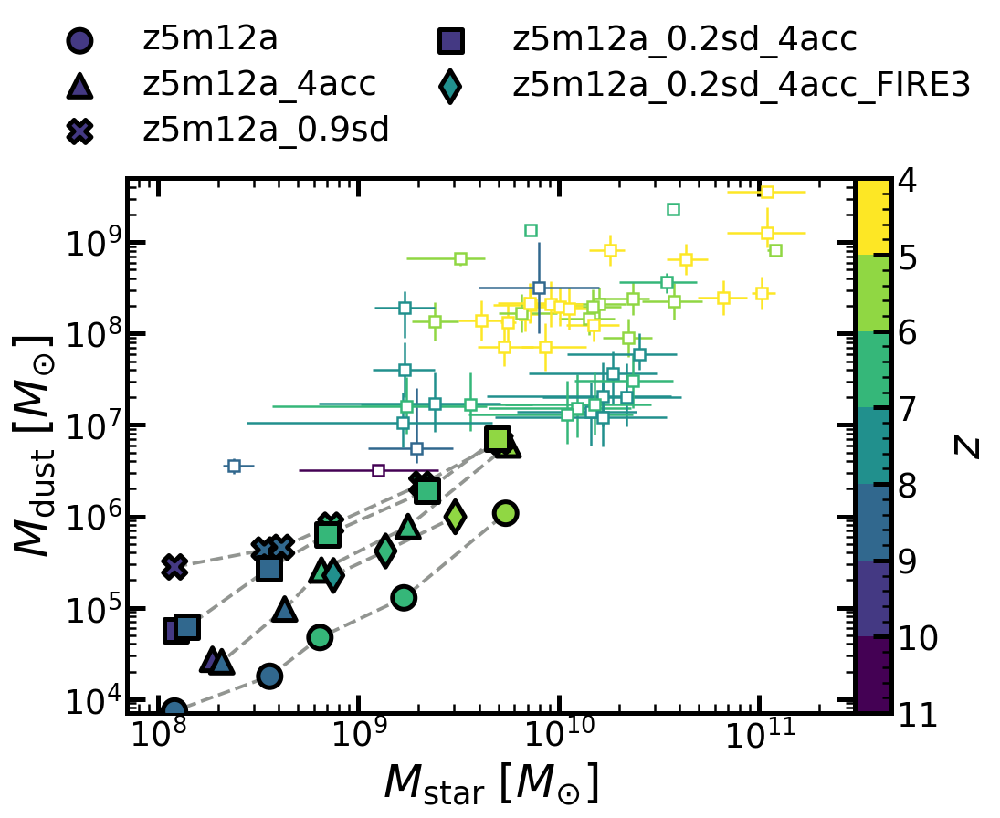

In [26]:
foutname=plot_dir+'z5m12a_Mstar_vs_Mdust.pdf'
x_props = ['M_star']
y_props=['M_dust']
x_lims = [[7E7,3E11]]
y_lims = [[7E3,5E9]]

simulations = sims[z5m12a_mask]
labels = names[z5m12a_mask]
x_criteria='all'
y_criteria='all'
style='color-line'
include_obs='HiZ_compilation'
connect_points=True
time_cmap='viridis_r'
redshift=True
time_range=[4,11]

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(simulations), style=style)

fig = Figure(len(x_props),ncols=1,sharex='col')

norm = mpl.colors.Normalize(time_range[0],time_range[1])
cmap = plt.get_cmap(time_cmap)

# Descretize the colormap so the color changes for each +1 change in redshift
num_times = int(time_range[1]-time_range[0])
times = np.linspace(0,1,num_times)*(time_range[1]-time_range[0])+time_range[0]
colors = cmap(norm(times))
cmap = mpl.colors.ListedColormap(colors)

for i in range(len(x_props)):
    x_prop = x_props[i]
    x_crit = x_criteria[i] if isinstance(x_criteria, list) else x_criteria
    y_prop = y_props[i]
    y_crit = y_criteria[i] if isinstance(y_criteria, list) else y_criteria

    # Set up axis for each plot
    fig.set_axis(i, x_prop, y_prop, x_lim=x_lims[i], y_lim=y_lims[i])

    # First plot observational data if applicable
    if include_obs is not None:
        obs_data = Observational_Data(include_obs)
        xprop_data,xprop_err= obs_data.get_data_w_errors(x_prop)
        yprop_data,yprop_err= obs_data.get_data_w_errors(y_prop)
        redshifts= obs_data.get_data('redshift')
        # Have to plot these one by one since errorbar only takes one color at a time
        for k in range(len(redshifts)):
            fig.plot_errorbar_data(i, xprop_data[k], yprop_data[k], y_err=yprop_err[:,k].reshape(2,1), x_err=xprop_err[:,k].reshape(2,1),
                                   fmt='s', c=cmap(norm(redshifts[k])),elinewidth=0.5*config.BASE_ELINEWIDTH, mew=0.5*config.BASE_ELINEWIDTH,
                                   ms=config.SMALL_MARKERSIZE**.5, mfc='xkcd:white', zorder=3)

    for j, sim_buff in enumerate(simulations):
        label = labels[j]
        times = sim_buff.get_data('redshift', snap_nums = sim_snap_nums[j]) if redshift else sim_buff.get_data('time', snap_nums = sim_snap_nums[j])
        y_vals = sim_buff.get_data(y_prop, snap_nums = sim_snap_nums[j])
        x_vals = sim_buff.get_data(x_prop, snap_nums = sim_snap_nums[j])
        fig.plot_scatter_data(i, x_vals, y_vals, label=label, marker=config.MARKER_STYLES[j], c=times, cmap=cmap, norm = norm,
                     s=config.LARGE_MARKERSIZE, edgecolors=config.BASE_COLOR, linewidths=config.LINE_WIDTHS[2], zorder=3)
        if connect_points:
            fig.plot_line_data(i,x_vals, y_vals, linestyle='--', color='xkcd:grey', linewidth=config.LINE_WIDTHS[3], zorder=2)

fig.add_colorbar(-1, cbar_prop='redshift', invert_axis=True)
fig.set_outside_legend(ncol=2, fontsize= 0.75*config.LARGE_FONT,bbox_to_anchor= (0.5, 1.03))
fig.save(foutname)

## $T_{\rm dust}$ Diagram

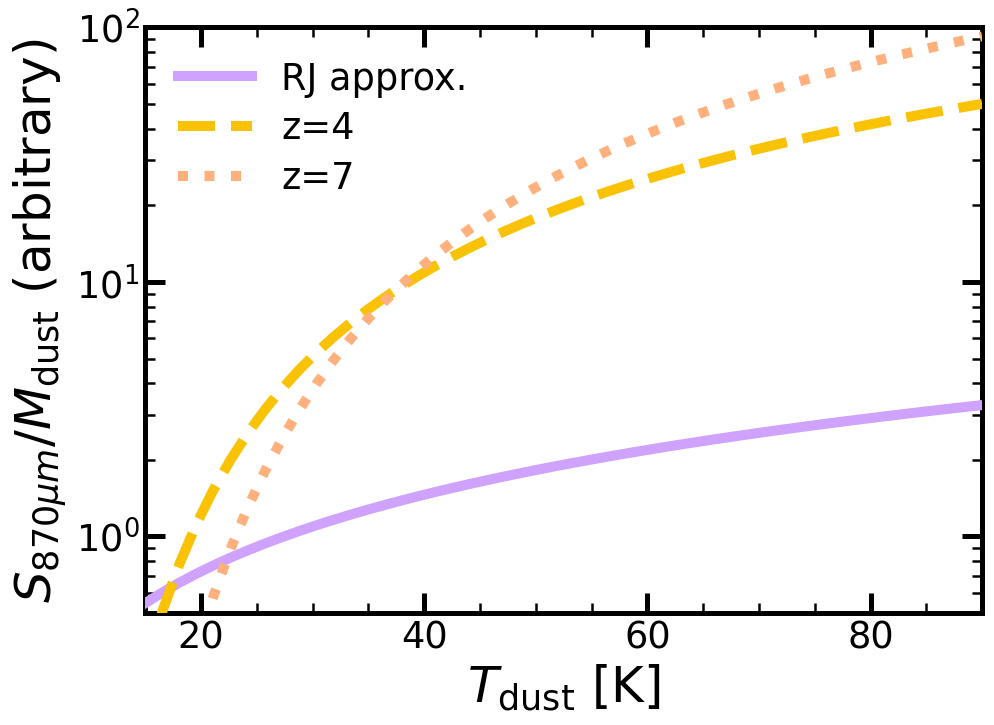

In [6]:
h = 6.626E-34; # Planck constant J/Hz
k = 1.38E-23; # Boltzmanns constant J/K
c = 3E8;# Speed of light m/z
# Planck function
def Planck_Function(wavelength, Tdust):
    return 2*h*np.power(c/wavelength,3)/(c*c)*1./(np.exp(h*c/(k*Tdust*wavelength))-1)
def wavelength_emit(wavelength_obs, redshift):
    return wavelength_obs/(1+redshift)

Tdust_lims = [15,90]
y_lims = [0.5,100]

#y_lims = [2E-16,1E-13]

y_label = r'$S_{870 \mu m}/M_{\rm dust}$ (arbitrary)'
fig = Figure(1)



fig.set_axis(0, 'T_dust', 'S', x_lim=Tdust_lims, x_log=False, y_label=y_label, y_lim=y_lims, y_log=True)

wavelength_obs = 870E-6; # 870 micron
normalization = 1E-15


redshifts=[0,4,7]
Tdust_ref = 25
colors = config.LINE_COLORS[-len(redshifts):]
linestyles = config.LINE_STYLES[0:len(redshifts)]
linewidth = 2*config.BASE_LINEWIDTH

for i,redshift in enumerate(redshifts):
    if redshift == 0:
        wavelength=wavelength_emit(wavelength_obs,redshift)
        Tdust = np.linspace(Tdust_lims[0],Tdust_lims[1])
        # RJ approx assume the planck function = Tdust
        y_data = 2*h*np.power(c/wavelength,3)/(c*c)*(k*Tdust*wavelength/(h*c))/normalization
        fig.plot_line_data(0,Tdust,y_data,label='RJ approx.',linestyle=linestyles[i],color=colors[i],linewidth=linewidth)
    else:
        wavelength=wavelength_emit(wavelength_obs,redshift)
        Tdust = np.linspace(Tdust_lims[0],Tdust_lims[1])
        y_data = Planck_Function(wavelength,Tdust)/Planck_Function(wavelength,Tdust_ref)
        y_data = Planck_Function(wavelength,Tdust)/normalization
        fig.plot_line_data(0,Tdust,y_data,label='z=%i'%redshift,linestyle=linestyles[i],color=colors[i], linewidth=linewidth)




fig.set_all_legends()
fig.save(plot_dir+"RJ_diagram.pdf")

## SKIRT Visualizations

In [59]:
# Global variables
SKIRT_dir = '/N/scratch/cchoban/SKIRT_HiZ/'
instrument_name = 'HiZ_bp_i00_obsframe_JWST_NIRCam_total.fits'


main_dirc = '/N/scratch/cchoban/HiZ_dust/'
# Names of simulation directories
names = np.array(['z5m11d_0.2sd_4acc','z5m12a_0.2sd_4acc','z5m12b_0.2sd_4acc','z5m12d_0.2sd_4acc',
                  'z7m12a_0.2sd_4acc','z7m12b_0.2sd_4acc','z7m12c_0.2sd_4acc','z9m12a_0.2sd_4acc'])

short_names = np.array([
                  'z5m11d_enh','z5m12a_enh','z5m12b_enh','z5m12d_enh',
                  'z7m12a_enh','z7m12b_enh','z7m12c_enh','z9m12a_enh'])

FIRE_ver = np.array([2]*len(names))


names = np.array([
                  'z7m12a_0.2sd_4acc','z7m12b_0.2sd_4acc','z7m12c_0.2sd_4acc','z9m12a_0.2sd_4acc'])

short_names = np.array([
                  'z7m12a_enh','z7m12b_enh','z7m12c_enh','z9m12a_enh'])

FIRE_ver = np.array([2]*len(names))

names = np.array(['z5m11d_0.2sd_4acc','z5m12a_0.2sd_4acc','z5m12b_0.2sd_4acc','z5m12d_0.2sd_4acc'])

short_names = np.array([
                  'z5m11d_enh','z5m12a_enh','z5m12b_enh','z5m12d_enh'])

FIRE_ver = np.array([2]*len(names))


mask = np.arange(len(names))


# Main sim directories and their snap and halo directories
# Note you need to specify the dtype or else you get numpy strings which annoying to deal with
main_dirs = np.array([main_dirc+name+'/' for name in names], dtype=object)
snap_dirs = np.array([main_dirc+name+'/output/' for name in names], dtype=object)
hdirs = np.array([main_dirc+name+'/halo/ahf/output/' for name in names], dtype=object)
# We only look at the main halos
halo_histories = np.array([main_dirc+name+'/halo/ahf/history/halo_main.dat' for name in names], dtype=object)

# Final snapshot number since sims are run to varying redshift
final_snaps = np.zeros(len(names),dtype=int)
for i,snap_dir in enumerate(snap_dirs):
    snap_files = os.listdir(snap_dir)
    snap_nums = []
    for snap_file in snap_files:
        if 'snapshot' in snap_file:
            if snap_file[9:12] == '000':
                snap_nums += [0]
            else:
                snap_nums += [int(snap_file[9:12].lstrip('0'))]

    final_snaps[i]=np.max(snap_nums)
    print(snap_dir,final_snaps[i])

# Nothing interesting in earlier snaps so limit first snapshot to 10
first_snaps = [10]*len(names)
# FIRE-3 has different snapshot numbering so this roughly corresponds to the same redshift as FIRE-2
first_snaps[-1]=10



/N/scratch/cchoban/HiZ_dust/z5m11d_0.2sd_4acc/output/ 67
/N/scratch/cchoban/HiZ_dust/z5m12a_0.2sd_4acc/output/ 67
/N/scratch/cchoban/HiZ_dust/z5m12b_0.2sd_4acc/output/ 57
/N/scratch/cchoban/HiZ_dust/z5m12d_0.2sd_4acc/output/ 67


### Make SKIRT input files

In [632]:
# Select what subset of the sims you want
importDust=True
Rvir_cut=1. # only want particles in the virial radius

indices = np.arange(len(names))[mask]
for i in indices:
    snap_dir=snap_dirs[i]
    hdir = hdirs[i];name = names[i];snap_num = final_snaps[i]
    file_prefix=''
    print(SKIRT_dir+name)
    os.makedirs(SKIRT_dir+name, exist_ok=True)
    create_SKIRT_input_files(snap_dir, snap_num, SKIRT_dir+name, importDust=importDust,file_prefix=file_prefix, Rvir_cut=Rvir_cut)

/N/scratch/cchoban/SKIRT_HiZ/z5m12b_0.2sd_4acc
Looking for snapshot's corresponding AHF file
AHF file found /N/scratch/cchoban/HiZ_dust/z5m12b_0.2sd_4acc/halo/ahf/output/snapshot_057.z5.632.AHF_halos
Orientating halo
assigning center of galaxy:
  center position [kpc] = 3227.009, 3307.976, 3202.719
  center velocity [km/s] = -4.9, -25.3, 17.9
assigning principal axes:
  using ptype 4 particles at radius < 10 kpc
  using ptype 4 particles with age = [0, 1] Gyr
  axis ratios:  min/maj = 0.635, min/med = 0.708, med/maj = 0.896
Calculating star particle smoothing lengths...
Star data written to /N/scratch/cchoban/SKIRT_HiZ/z5m12b_0.2sd_4acc/star.dat
Gas/Dust data written to /N/scratch/cchoban/SKIRT_HiZ/z5m12b_0.2sd_4acc/gas.dat


### Make Instrument SEDs

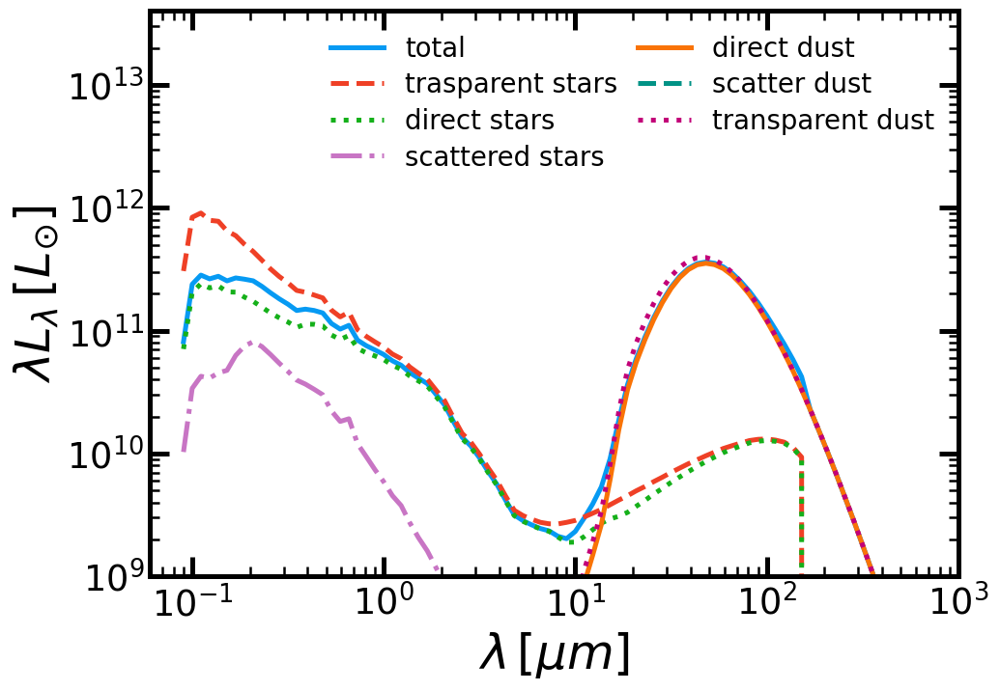

In [418]:
dirc = '/N/scratch/cchoban/SKIRT_HiZ/z5m12b_0.2sd_4acc/output/'
inst_file = 'HiZ_bp_i00_restframe_sed.dat'
sed_data = get_SKIRT_SED_data(dirc,inst_file,distance=1E6,redshift=0)


y_lim = [1E9,4E13]


linewidths, colors, linestyles = plt_set.setup_plot_style(len(sed_data.keys())-1, style=style)


y_label = r'$S_{870 \mu m}/M_{\rm dust}$ (arbitrary)'
fig = Figure(1)
fig.set_axis(0, 'wavelength', 'flux',y_lim=y_lim)

wavelength = sed_data.pop('wavelength')
#print(sed_data)
for i,key in enumerate(sed_data):
    fig.plot_line_data(0,wavelength,sed_data[key],color=colors[i],linestyle=linestyles[i],label=key)
fig.set_all_legends(fontsize = 0.75*config.SMALL_FONT)

### Test JWST Images(Full Res, PSF Convolved, and Downscaled PSF Convolved) and Color Scaling (Saturated vs Lupton True Color)

FITS files info
Filename: /N/scratch/cchoban/SKIRT_HiZ/z7m12a_0.2sd_4acc/output/HiZ_bp_i00_obsframe_JWST_NIRCam_total.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      32   (1000, 1000, 3)   float32   
  1  Z-axis coordinate values    1 TableHDU        13   3R x 1C   ['E16.9']   
None
SIMPLE  =                    T / file does conform to FITS standard             BITPIX  =                  -32 / number of bits per data pixel                  NAXIS   =                    3 / number of data axes                            NAXIS1  =                 1000 / length of data axis 1                          NAXIS2  =                 1000 / length of data axis 2                          NAXIS3  =                    3 / length of data axis 3                          EXTEND  =                    T / FITS dataset may contain extensions            COMMENT   FITS (Flexible Image Transport System) format is defined in 'AstronomyCOMMENT   and Astrop

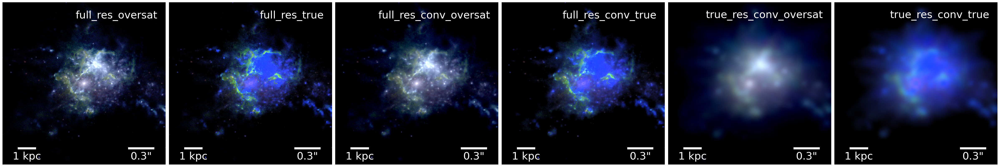

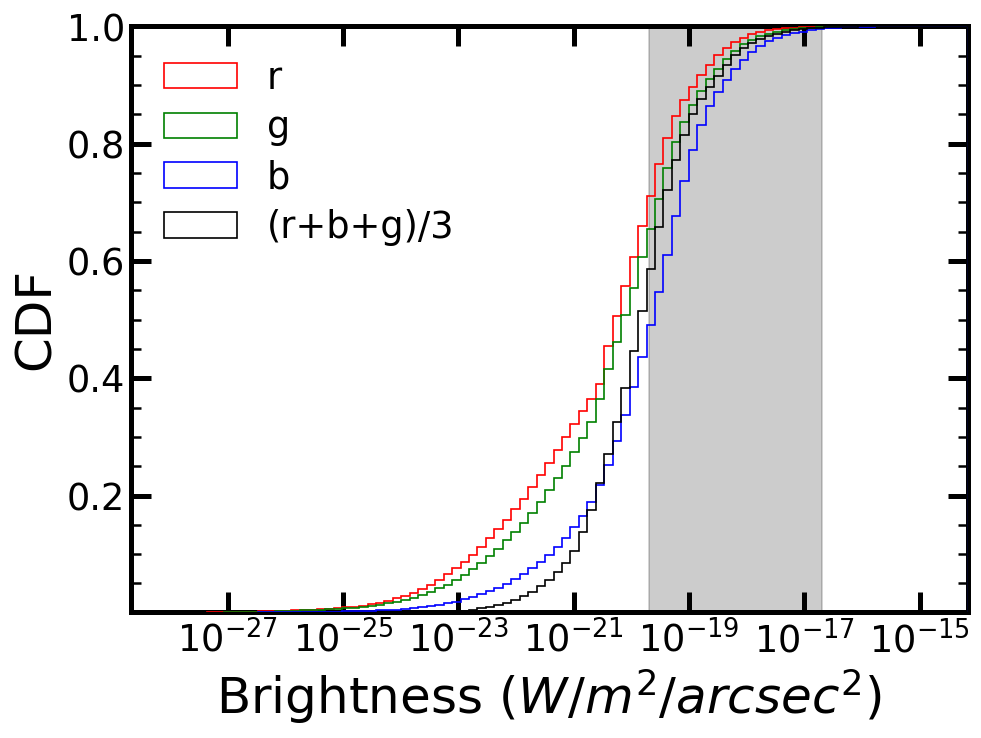

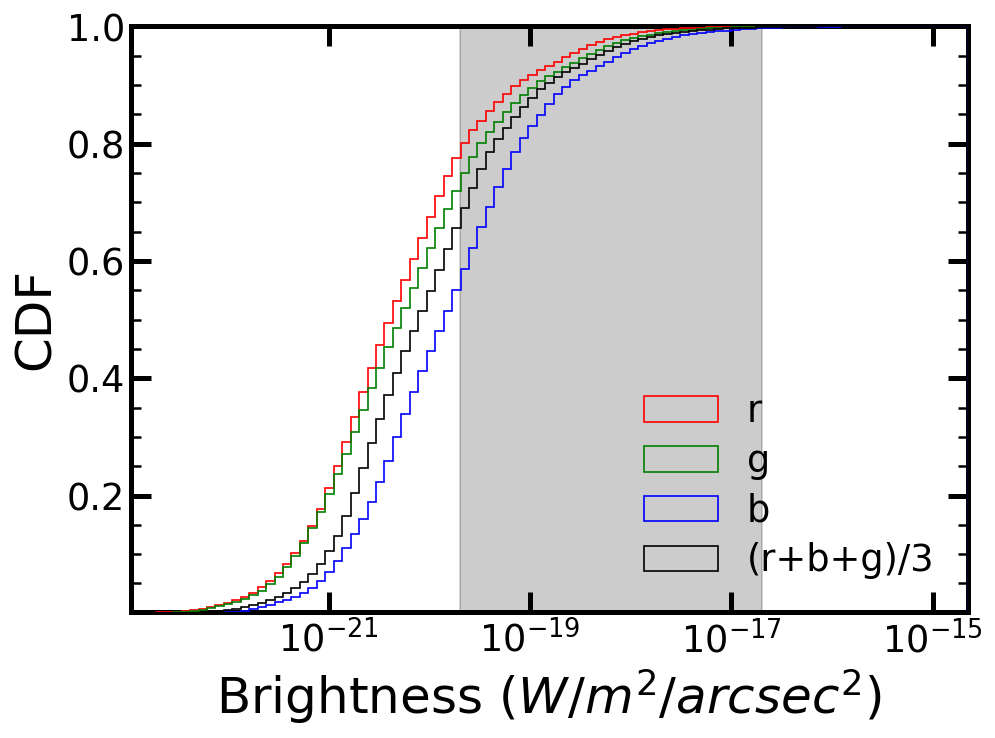

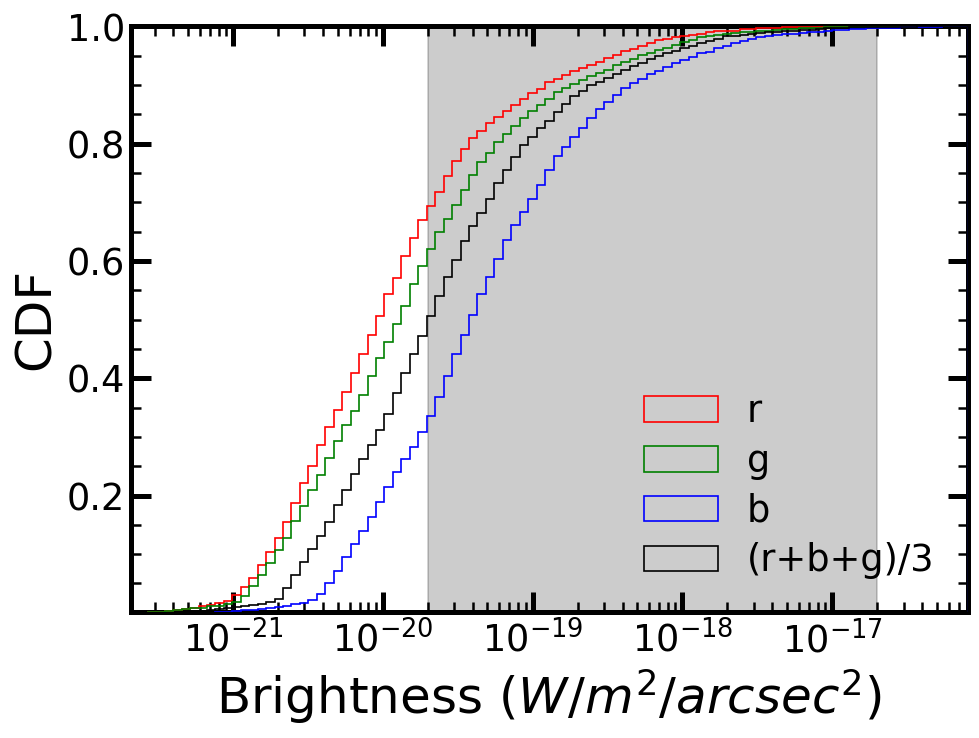

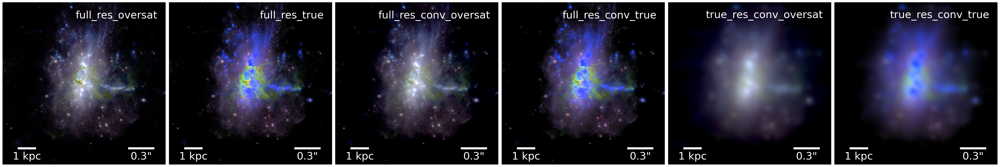

...

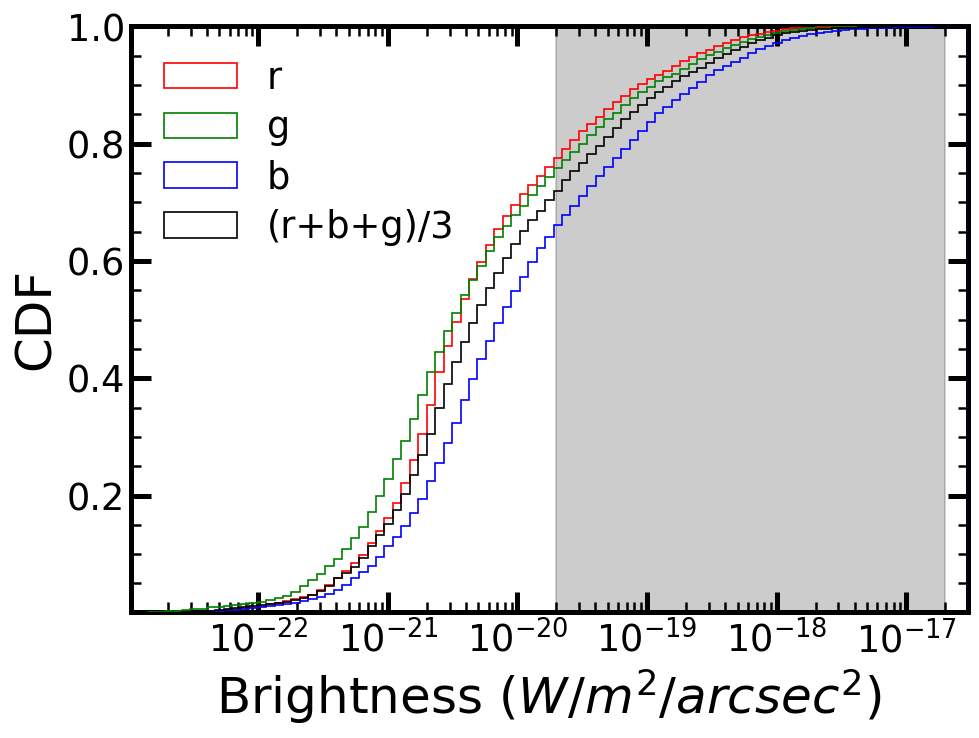

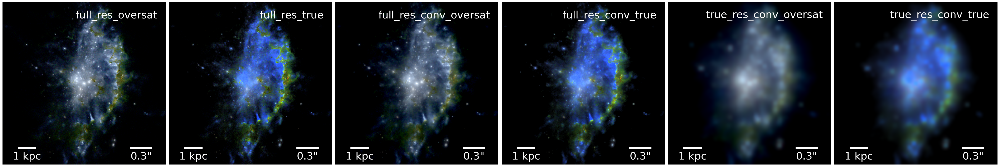

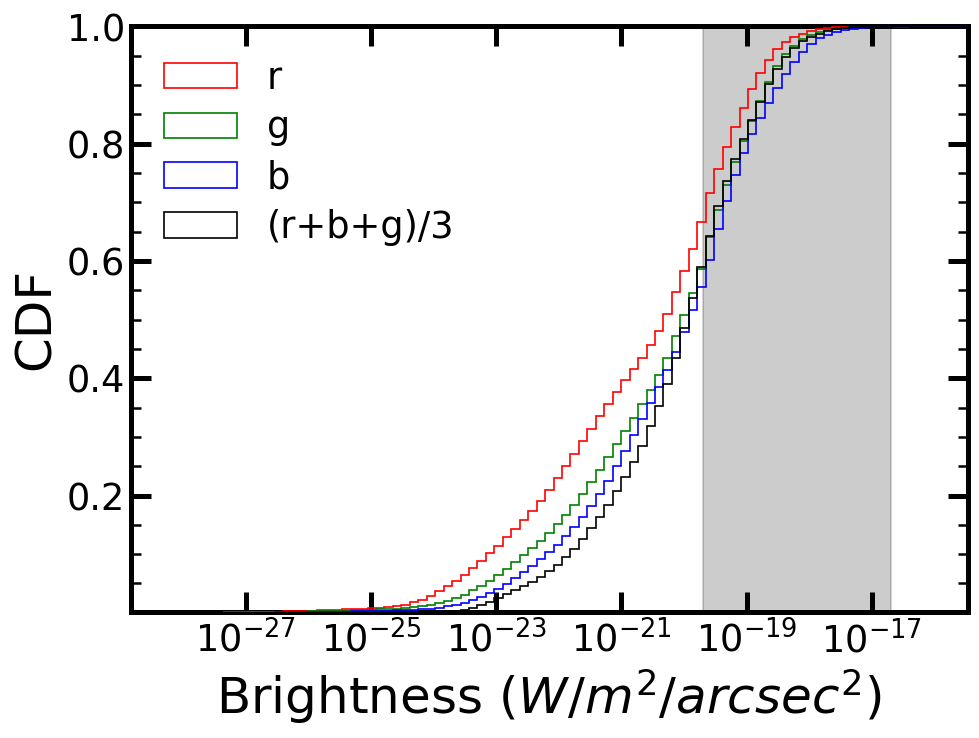

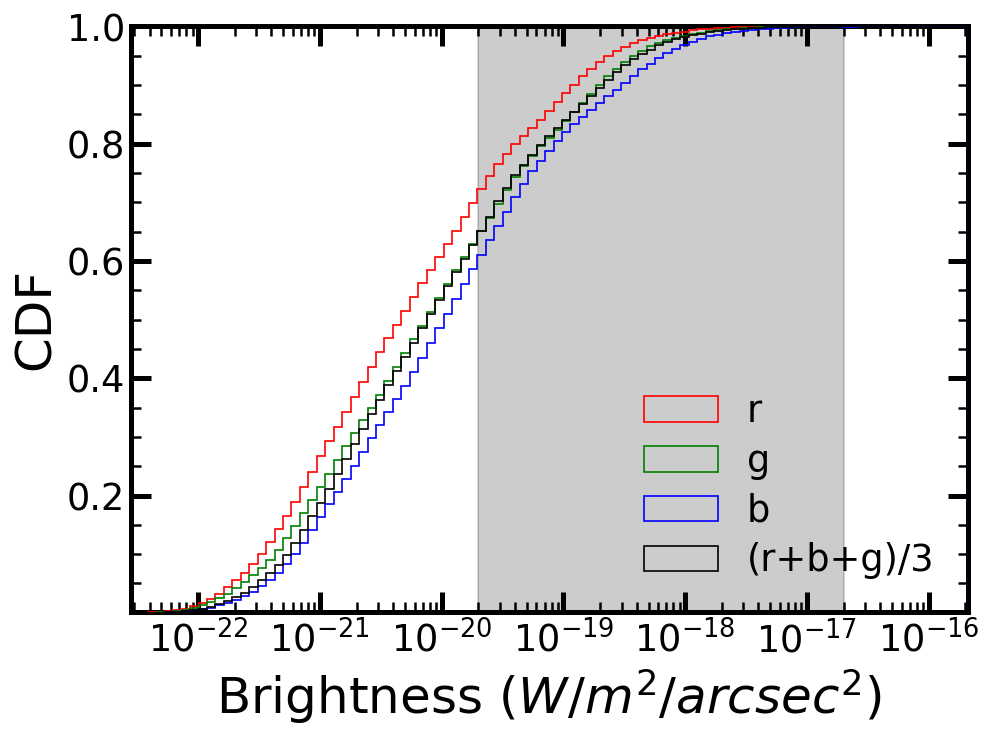

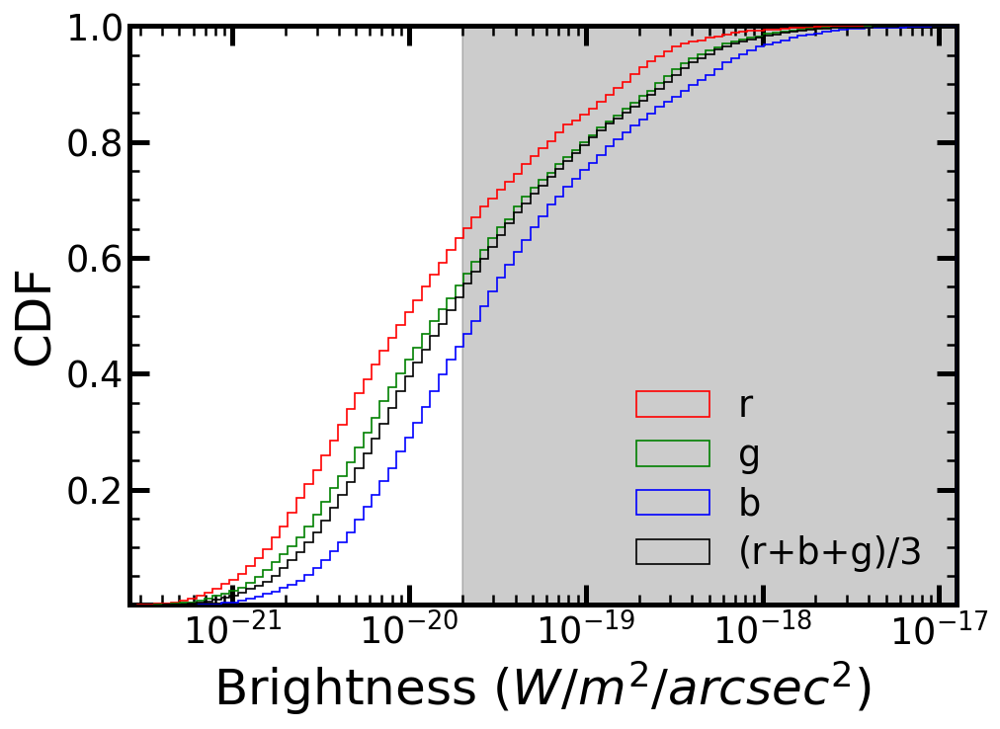

In [673]:
dynamic_range = 3
max_bright_frac=0.1
create_rgb_hist=True
max_brightness = 2E-17

for i in range(len(names)):
    name = names[i]; short_name = short_names[i]
    dirc = '/N/scratch/cchoban/SKIRT_HiZ/'+name+'/output/'
    inst_file = 'HiZ_bp_i00_obsframe_JWST_NIRCam_total.fits'
    #inst_file = 'HiZ_bp_i00_restframe_HST_total.fits'

    # Set the filters used for each image and the fov
    filters = ["F115W","F277W","F444W"]
    zoom = 1
    
    
    wavelengths, images, pixel_res_kpc, pixel_res_arcsec = get_SKIRT_image_data(dirc, inst_file, verbose=True)
    num_pixels = np.shape(images)[1]
    print(num_pixels)
    fov_kpc = num_pixels * pixel_res_kpc
    fov_arcsec = num_pixels * pixel_res_arcsec
    print("Image FOV",fov_kpc," kpc",fov_arcsec,"arcsec")
    
    # sort colors so RGB corresponds to longest to shortest wavelengths
    print(wavelengths)
    sort_colors = np.argsort(-wavelengths)
    images = images[sort_colors]
    filters = np.array(filters)[sort_colors].tolist()
    
    
    # Lets focus on the inner part of the image
    fov_kpc *= zoom
    fov_arcsec *= zoom
    pixel_zoom = int(images[0].shape[0]//2*zoom)
    middle_pixel = images[0].shape[0]//2
    upper_pixel = int(middle_pixel+pixel_zoom)
    lower_pixel = int(middle_pixel-pixel_zoom)
    new_size = int(upper_pixel-lower_pixel)
    zoomed_images = np.zeros([np.shape(images)[0],new_size,new_size])
    for i, image in enumerate(images):
        zoomed_images[i] = image[lower_pixel:upper_pixel,lower_pixel:upper_pixel]
    
    foutname= name+'_zoom_'+str(zoom)+'_JWST_3band_comparison.pdf'
    
    images = zoomed_images
    
    downsampled_convolved_images = convolve_images_w_PSF(images, 'JWST', filters, oversample_factor=2, instrument_res=pixel_res_arcsec, extension_name="DET_SAMP",downsample_image=True)
    
    convolved_images = convolve_images_w_PSF(images, 'JWST', filters, oversample_factor=2, instrument_res=pixel_res_arcsec, extension_name="DET_SAMP",downsample_image=False)


    
    N=6
    img = Projection(N)
    for i in range(N):
        img.set_image_axis(i)
    
    label = 'full_res_oversat'
    RGB_image =  create_RGB_log_image_data(images, dynamic_mag_range=dynamic_range , max_brightness=max_brightness,
                                           max_bright_frac=max_bright_frac,allow_oversaturation=True,only_full_rgb_pixels=True)
    img.plot_image(0, RGB_image, fov_kpc=fov_kpc, fov_arcsec=fov_arcsec, label=label)
    
    print("Full res true color")
    label = 'full_res_true'
    RGB_image =  create_RGB_log_image_data(images, dynamic_mag_range=dynamic_range , max_brightness=max_brightness, 
                                            max_bright_frac=max_bright_frac, only_full_rgb_pixels=True, create_rgb_hist=create_rgb_hist)
    img.plot_image(1, RGB_image, fov_kpc=fov_kpc, fov_arcsec=fov_arcsec, label=label)
    
    
    print("Full res convolved oversat")
    label = 'full_res_conv_oversat'
    convolved_RGB_image =  create_RGB_log_image_data(convolved_images, dynamic_mag_range=dynamic_range , max_brightness=max_brightness,
                                                     max_bright_frac=max_bright_frac,allow_oversaturation=True,only_full_rgb_pixels=True,)
    img.plot_image(2, convolved_RGB_image, fov_kpc=fov_kpc, fov_arcsec=fov_arcsec, label=label)
    
    print("Full res convolved truecolor")
    label = 'full_res_conv_true'
    convolved_RGB_image =  create_RGB_log_image_data(convolved_images, dynamic_mag_range=dynamic_range , max_brightness=max_brightness,
                                                     max_bright_frac=max_bright_frac,only_full_rgb_pixels=True,create_rgb_hist=create_rgb_hist)
    img.plot_image(3,convolved_RGB_image, fov_kpc=fov_kpc, fov_arcsec=fov_arcsec, label=label)
    
    
    print("Down sampled convolved true color")
    label = 'true_res_conv_oversat'
    down_RGB_image =  create_RGB_log_image_data(downsampled_convolved_images, dynamic_mag_range=dynamic_range , max_brightness=max_brightness,
                                                max_bright_frac=max_bright_frac,allow_oversaturation=True,only_full_rgb_pixels=True)
    img.plot_image(4,down_RGB_image, fov_kpc=fov_kpc, fov_arcsec=fov_arcsec, label=label)
    
    print("Down sampled convolved true color")
    label = 'true_res_conv_true'
    down_RGB_image =  create_RGB_log_image_data(downsampled_convolved_images, dynamic_mag_range=dynamic_range , max_brightness=max_brightness,
                                                max_bright_frac=max_bright_frac,allow_oversaturation=False,only_full_rgb_pixels=True,create_rgb_hist=create_rgb_hist)
    img.plot_image(5,down_RGB_image, fov_kpc=fov_kpc, fov_arcsec=fov_arcsec, label=label)
    
    
    img.save(plot_dir+foutname)


### Make Visualization Images (High Definition Image, True JWST Image, and Dust and Stellar Projection) for a Galaxy

Looking for snapshot's corresponding AHF file
AHF file found /N/scratch/cchoban/HiZ_dust/z5m11d_0.2sd_4acc/halo/ahf/output/snapshot_067.z5.024.AHF_halos
assigning center of galaxy:
  center position [kpc] = 3743.789, 3705.467, 3570.692
  center velocity [km/s] = 98.6, 110.5, 6.6
assigning principal axes:
  using ptype 4 particles at radius < 10 kpc
  using ptype 4 particles with age = [0, 1] Gyr
  axis ratios:  min/maj = 0.390, min/med = 0.765, med/maj = 0.510
Image FOV 19.99998121125936  kpc 3.103110399 arcsec
Projection size: 20.000 kpc
Downsampled resolution set by telescope resolution of 0.031 arcsec / pixel

Downsampled image has resolution 0.031031103990000003 arcsec / pixel compared to desired telescope resolution of  0.031 arcsec / pixel.

PSF model for filter F444W has pixel scale 0.06291 arcsec / pixel.

Downsampled image has resolution 0.031031103990000003 arcsec / pixel compared to desired telescope resolution of  0.031 arcsec / pixel.

PSF model for filter F277W has pixel 

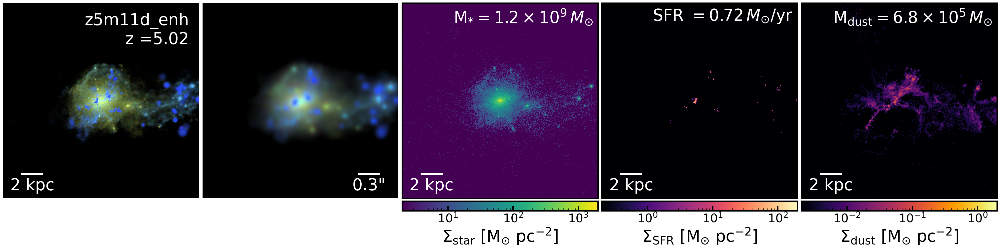

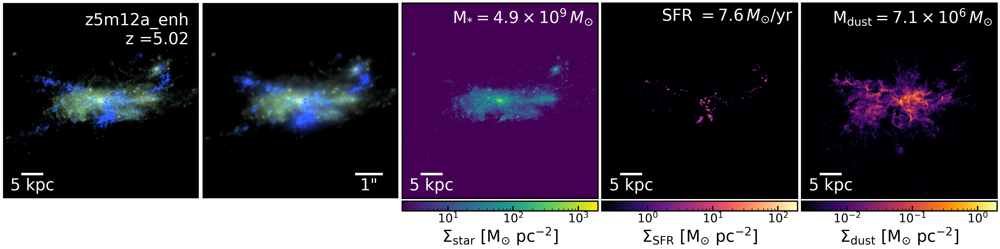

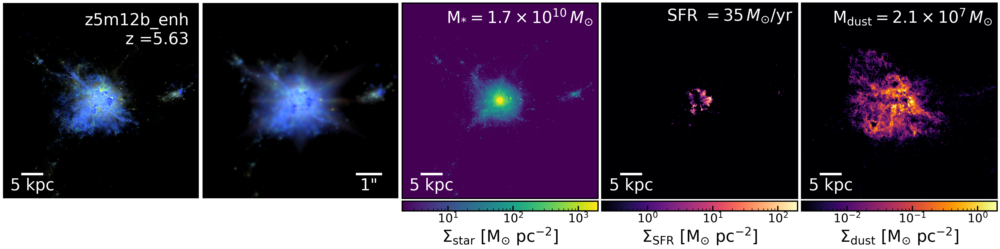

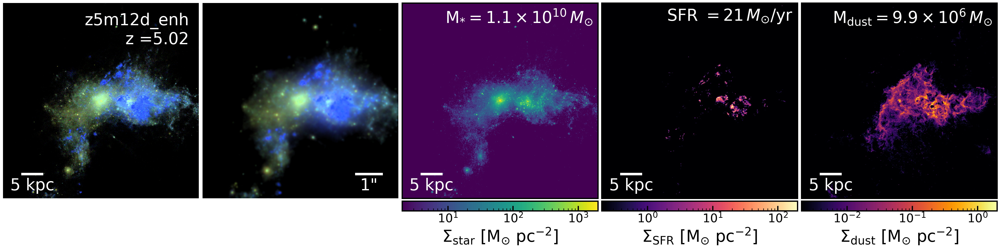

In [60]:

# Set mock JWST image parameters. The only good way to determine this trial and error.
max_bright_frac=0.1
dynamic_range = 3.
create_rgb_hist=False
# Noticed the max brightness need to be upped at higher z
z5_brightness = 2E-18
z7_brightness = 2E-17
allow_oversaturation=False

proj_rescale_font=1.3

# Set projection parameters
# Properties to plot projections of. Can be surface densities (total mass in pixel divied by pixel size) or properties like T (median value of all particles in pixel)
properties = ['sigma_star','sigma_sfr','sigma_dust']
# Limits for projection of each property. Defaults if not set
prop_limits = [[2E0,2E3],[2E-1,2E2],[2E-3,2E0]]
# Colormaps for each projection
prop_cmaps = ['viridis','magma','inferno']
# Do you want log colormaps (default = yes)
log_cmap = [True]*len(properties)
# Do you want a secondary projection from an orthogonal axis?
add_sub_proj = False
# size of secondary projection
sub_L = 2 # kpc
# Do you want colorbars for each projection?
add_colorbars=True
# Size resolution (kpc) for each "pixel" in projection
pixel_res=0.05

# Saved image name
foutname='_images_and_star_sfr_dust_projections.pdf'


for i in range(len(names)):
    name = names[i]; short_name = short_names[i]
    snap_dir=snap_dirs[i]
    hdir = hdirs[i];snap_num = final_snaps[i]

    

    halo = load_halo(snap_dir, snap_num, cosmological=1, id=-1, mode='AHF', hdir=hdir)
    halo.set_orientation()
    halo.set_zoom(rout=1.0, kpc=False)

    if halo.redshift > 6: max_brightness=z7_brightness
    else: max_brightness=z5_brightness

    sim_label = f"{short_name}\n z ={halo.redshift:2.3g}"
    
    gas = halo.loadpart(0)
    M_dust = np.sum(gas.get_property('M_dust'))
    stars = halo.loadpart(4)
    M_star = np.sum(stars.get_property('M'))
    sfr = np.sum(stars.get_property('M_star_10Myr'))/1E7

    power = int(np.floor(np.log10(M_star)))
    digit = M_star / np.power(10,power)
    star_label = r'M$_{*} = %.1f \times 10^{%i} \, M_{\odot}$'%(digit,power)

    sfr_label = r'SFR $= %2.2g \, M_{\odot}/$yr'%sfr

    power = int(np.floor(np.log10(M_dust)))
    digit = M_dust / np.power(10,power)
    dust_label = r'M$_{\rm dust} = %.1f \times 10^{%i} \, M_{\odot}$'%(digit,power)

    labels = [star_label,sfr_label,dust_label]

    # First read in SKIRT instrument to get the field of view
    dirc = '/N/scratch/cchoban/SKIRT_HiZ/'+name+'/output/'
    inst_file = 'HiZ_bp_i00_obsframe_JWST_NIRCam_total.fits'

    # Set the filters used for each image and the fov
    filters = ["F115W","F277W","F444W"]

    wavelengths, images, pixel_res_kpc, pixel_res_arcsec = get_SKIRT_image_data(dirc, inst_file, verbose=False)
    num_pixels = np.shape(images)[1]
    fov_kpc = num_pixels * pixel_res_kpc
    fov_arcsec = num_pixels * pixel_res_arcsec
    print("Image FOV",fov_kpc," kpc",fov_arcsec,"arcsec")

    # sort colors so RGB corresponds to longest to shortest wavelengths
    sort_colors = np.argsort(-wavelengths)
    images = images[sort_colors]
    filters = np.array(filters)[sort_colors].tolist()
    # For some reason the images are roated 90 degrees
    for j in range(len(images)):
        images[j] = np.rot90(images[j],k=3)

    # Initialize projection figure
    L = fov_kpc
    height_ratios = [L/sub_L,1]
    im_proj = Projection(2+len(properties), add_sub_proj=False, add_colorbars=True, height_ratios=height_ratios)
    # Create projections for each property and plot the projection
    print('Projection size: %.3f kpc'%L)


    for j in range(len(properties)):
   
        im_proj.set_proj_axis(2+j, properties[j], L, axes_visible=False)
        # x-y projection
        main_pixel_stats, main_xedges, main_yedges, main_extent = calc.calc_projected_prop(properties[j], halo, [L,L,L], pixel_res=pixel_res_arcsec, proj='xy')
        # x-z projection
        #sub_pixel_stats, sub_xedges, sub_yedges, sub_extent = calc.calc_projected_prop(prop, snap, [L,sub_L,L], pixel_res=pixel_res, proj='xz')
        im_proj.plot_projection(2+j, main_pixel_stats, main_extent, sub_proj_data=None, sub_extent=None,
                                 cmap= prop_cmaps[j], v_limits = prop_limits[j],v_log=log_cmap[j], label=labels[j],rescale_font=proj_rescale_font)

    downsampled_convolved_images = convolve_images_w_PSF(images, 'JWST', filters, oversample_factor=2, instrument_res=pixel_res_arcsec, extension_name="DET_SAMP",downsample_image=True)

    RGB_image =  create_RGB_log_image_data(images, dynamic_mag_range=dynamic_range , max_bright_frac=max_bright_frac,max_brightness=max_brightness,
                                           allow_oversaturation=allow_oversaturation,only_full_rgb_pixels=True,create_rgb_hist=create_rgb_hist)
    im_proj.set_image_axis(0)
    im_proj.plot_image(0, RGB_image, fov_kpc=fov_kpc, label=sim_label,rescale_font=proj_rescale_font)

    RGB_image =  create_RGB_log_image_data(downsampled_convolved_images, dynamic_mag_range=dynamic_range , max_bright_frac=max_bright_frac,max_brightness=max_brightness,
                                           allow_oversaturation=allow_oversaturation,only_full_rgb_pixels=True,create_rgb_hist=create_rgb_hist)

    im_proj.set_image_axis(1)
    im_proj.plot_image(1, RGB_image, fov_arcsec=fov_arcsec,rescale_font=proj_rescale_font)
    im_proj.save(plot_dir+name+foutname)

Looking for snapshot's corresponding AHF file
AHF file found /N/scratch/cchoban/HiZ_dust/z5m12d_0.2sd_4acc/halo/ahf/output/snapshot_067.z5.024.AHF_halos
assigning center of galaxy:
  center position [kpc] = 3451.105, 3607.588, 3635.356
  center velocity [km/s] = -90.6, 1.0, 9.4
assigning principal axes:
  using ptype 4 particles at radius < 10 kpc
  using ptype 4 particles with age = [0, 1] Gyr
  axis ratios:  min/maj = 0.285, min/med = 0.688, med/maj = 0.415
Projection size: 50.000 kpc
FITS files info
Filename: /N/scratch/cchoban/SKIRT_HiZ/z5m12d_0.2sd_4acc/output/HiZ_bp_i00_obsframe_JWST_NIRCam_total.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      32   (1000, 1000, 3)   float32   
  1  Z-axis coordinate values    1 TableHDU        13   3R x 1C   [E16.9]   
None
SIMPLE  =                    T / file does conform to FITS standard             BITPIX  =                  -32 / number of bits per data pixel                  NAXIS   = 

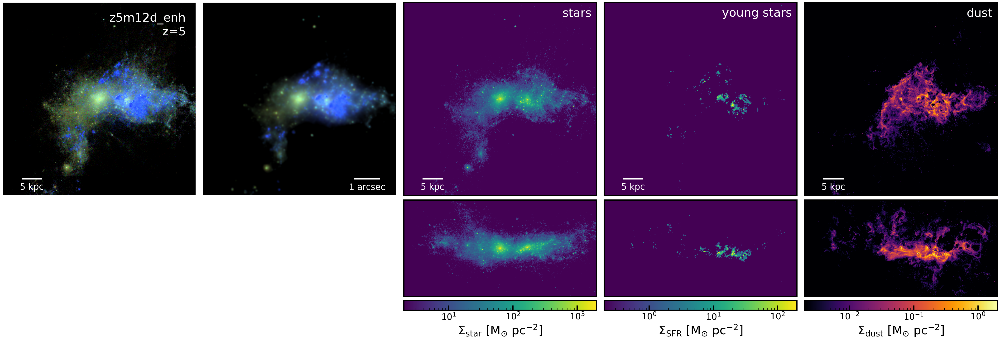

In [504]:
hi_def_dynamic_range = 3.
hi_def_max_bright_frac=0.1
convolved_dynamic_range = 3.
convolved_max_bright_frac=1

allow_oversaturation=False


for i, name in enumerate(names[mask]):
    short_name = short_names[i]
    hdir = hdirs[mask][i];snap_num = final_snaps[mask][i]

    # Properties to plot projections of. Can be surface densities (total mass in pixel divied by pixel size) or properties like T (median value of all particles in pixel)
    properties = ['sigma_star','sigma_sfr','sigma_dust']
    # Limits for projection of each property. Defaults if not set
    prop_limits = [[2E0,2E3],[2E-1,2E2],[2E-3,2E0]]
    # Colormaps for each projection
    prop_cmaps = ['viridis','viridis','inferno']
    # Do you want log colormaps (default = yes)
    log_cmap = [True]*len(properties)
    # Labels for each projection is so desired
    labels = ['stars','young stars','dust']
    
    # Physical size of projection
    rkpc = 50 # kpc
    # Do you want a secondary projection from an orthogonal axis?
    add_sub_proj = True
    # size of secondary projection
    sub_L = 25 # kpc
    # Do you want colorbars for each projection?
    add_colorbars=True
    # Size resolution (kpc) for each "pixel" in projection
    pixel_res=0.05
    
    # Saved image name
    foutname='_images_and_projections.pdf'


    halo = load_halo(snap_dir, snap_num, cosmological=1, id=-1, mode='AHF', hdir=hdir)
    halo.set_orientation()
    halo.set_zoom(rout=1.0, kpc=False)
    
    
    # Initialize projection figure
    L = rkpc
    height_ratios = [L/sub_L,1]
    im_proj = Projection(2+len(properties), add_sub_proj=add_sub_proj, add_colorbars=add_colorbars, height_ratios=height_ratios)
    # Create projections for each property and plot the projection
    print('Projection size: %.3f kpc'%L)


    for j in range(len(properties)):
   
        im_proj.set_proj_axis(2+j, properties[j], L, axes_visible=False)
        # x-y projection
        main_pixel_stats, main_xedges, main_yedges, main_extent = calc.calc_projected_prop(properties[j], halo, [L,L,L], pixel_res=pixel_res, proj='xy')
        # x-z projection
        sub_pixel_stats, sub_xedges, sub_yedges, sub_extent = calc.calc_projected_prop(properties[j], halo, [L,sub_L,L], pixel_res=pixel_res, proj='xz')
        im_proj.plot_projection(2+j, main_pixel_stats, main_extent, sub_proj_data=sub_pixel_stats, sub_extent=sub_extent,
                                 cmap= prop_cmaps[j], v_limits = prop_limits[j],v_log=log_cmap[j], label=labels[j])


    # Set the filters used for each image and the fov
    filters = ["F115W","F277W","F444W"]
    fov_kpc = 5E1 # kpc
    fov_arcsec = fov_kpc/6.417
    zoom = 1
    
    
    wavelengths, images, pixel_res = get_SKIRT_photometric_data(dirc, inst_file)
    # sort colors so RGB corresponds to longest to shortest wavelengths
    print(wavelengths)
    sort_colors = np.argsort(-wavelengths)
    images = images[sort_colors]
    # For some reason the images are roated 90 degrees
    for j in range(len(images)):
        images[j] = np.rot90(images[j],k=3)
    filters = np.array(filters)[sort_colors].tolist()

    downsampled_convolved_images = convolve_images_w_PSF(images, 'JWST', filters, oversample_factor=2, instrument_res=pixel_res, extension_name="DET_SAMP",downsample_image=True)

    convolved_images = convolve_images_w_PSF(images, 'JWST', filters, oversample_factor=2, instrument_res=pixel_res, extension_name="DET_SAMP",downsample_image=False)


    RGB_image =  create_RGB_log_image_data(images, dynamic_mag_range=hi_def_dynamic_range , max_bright_frac=hi_def_max_bright_frac,
                                           allow_oversaturation=allow_oversaturation,only_full_rgb_pixels=True)
    im_proj.set_image_axis(0)
    im_proj.plot_image(0, RGB_image, fov_kpc=fov_kpc, label=label)

    RGB_image =  create_RGB_log_image_data(downsampled_convolved_images, dynamic_mag_range=convolved_dynamic_range , max_bright_frac=convolved_max_bright_frac,
                                           allow_oversaturation=allow_oversaturation,only_full_rgb_pixels=True)

    im_proj.set_image_axis(1)
    im_proj.plot_image(1, RGB_image, fov_arcsec=fov_arcsec)
    im_proj.save(plot_dir+'Convolved_JWST'+foutname)

## Comparison with Original Runs from Ma+19

In [36]:
# Main directory
orig_dirc = '/N/scratch/cchoban/orig_HiZ/'
# Names of simulation directories
orig_names = np.array(['z5m11d','z5m12a','z5m12b','z5m12d'])
orig_labels = np.array(['old z5m11d','old z5m12a','old z5m12b','old z5m12d'])

# Main sim directories and their snap and halo directories
orig_main_dirs = [orig_dirc+name+'/' for name in orig_names]
orig_snap_dirs = [orig_dirc+name+'/output/' for name in orig_names]
# Use new AHF halos for now
orig_hdirs = [orig_dirc+name+'/halo/AHF/' for name in orig_names]
# We only look at the main halos
orig_halo_histories = [main_dirc+name+'/AHF_data/AHF_output/halo_0000000.dat' for name in orig_names]

orig_final_snaps=final_snaps[z5_mask]

In [38]:
rvir_frac=0.2
id=-1

# Corresponds to z=5,6,7,8,9,10
base_snap_nums = np.array([67,52,41,33,26,20])
orig_sims=[]

for i in range(len(orig_names)):
    snap_dir = orig_snap_dirs[i]; hdir = orig_hdirs[i];final_snap=orig_final_snaps[i];halo_file=orig_halo_histories[i]
    snap_nums = base_snap_nums[base_snap_nums<=orig_final_snaps[i]]
    # If last sim snap is not at a int value of redshift tack it onto the list
    if  len(snap_nums)==0 or orig_final_snaps[i] > snap_nums[0]:
        snap_nums = np.append([orig_final_snaps[i]],snap_nums)
    print(snap_dir)
    snap_nums = list(range(11,orig_final_snaps[i]+1))
    buff = Buffer(snap_dir, snap_nums, cosmological=1,halohist_file=halo_file,base_FIRE=True)
    buff.set_halo(mode='AHF', hdir=hdir, rout=rvir_frac, kpc=False)
    buff.load(override=False,increment=2)

    orig_sims+=[buff]
orig_sims=np.array(orig_sims)

/N/scratch/cchoban/orig_HiZ/z5m11d/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/orig_HiZ/z5m12a/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/orig_HiZ/z5m12b/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....
/N/scratch/cchoban/orig_HiZ/z5m12d/output/
Reduced data already exists for the given halo setup so loading that first....
All done reducing snapshot data. Please clap.....


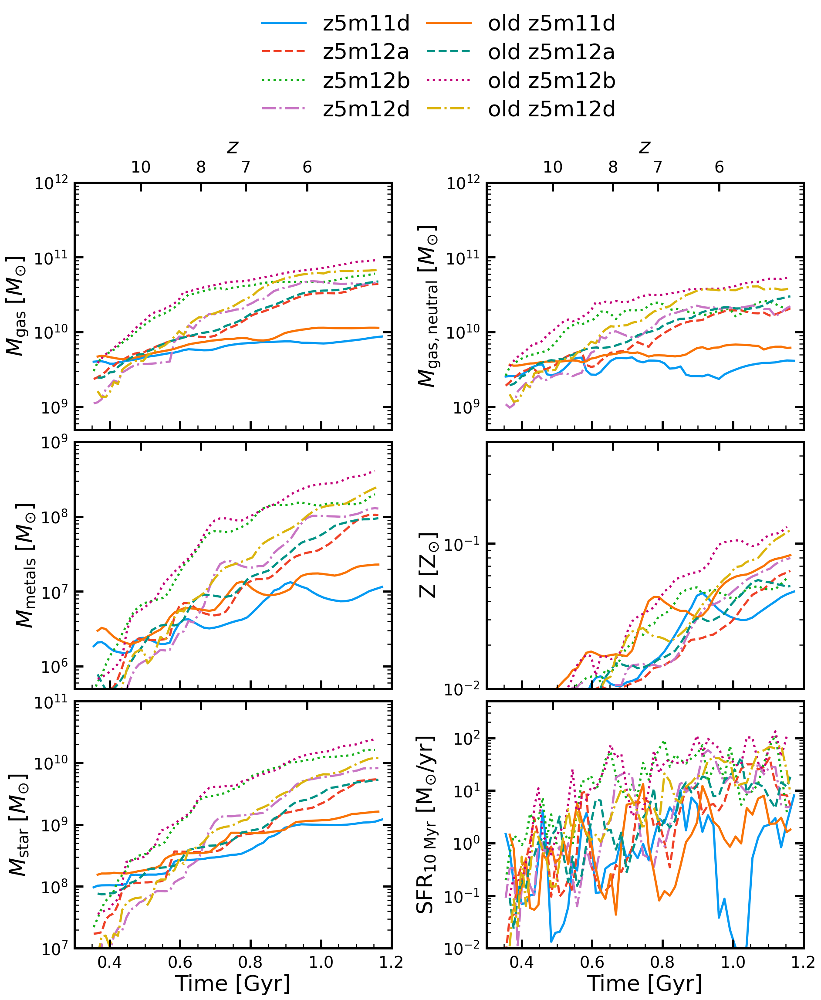

In [42]:
foutname = 'FIREversion_galaxy_data_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_gas','M_gas_neutral','M_metals','Z','M_star','sfr_10Myr']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E8,1E12],[5E8,1E12],[5E5,1E9],[1E-2,0.5],[1E7,1E11],[1E-2,5E2]]
x_lim=[0.3,1.2]
y_logs=[True]*(len(params))

# The precompile data objects which house all of the time evolution data
data_objs = np.append(sims[z5_mask],orig_sims)
# The statistic you want to use when plotting quantities that could be averaged
stat = 'median'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
gas_sample = 'all'
star_sample='all'
subsample = 'all'
# Labels you to give to the data objects
labels = np.append(names[z5_mask],orig_labels)
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(data_objs), style=style)
# Setup figure
fig = Figure(len(params), sharex=True, orientation='vertical',ncols=2)

for i, y_prop in enumerate(params):

    fig.set_axis(i, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)

    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            if isinstance(subsample, list):
                sample = subsample[j]
            else:
                sample = subsample
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample=sample, statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
        print("These species in sims given:", param_labels)
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    if isinstance(subsample, list):
        sample = subsample[i]
    else:
        sample = subsample

    for j, data in enumerate(data_objs):

        label = labels[j] if labels is not None else None
        # Get time data for x axis
        time_data = data.get_data(time_prop)

        # Check if parameter has subparameters
        if len(param_labels) == 0:
            data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
            fig.plot_line_data(i, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                      linewidth=config.BASE_LINEWIDTH, zorder=-1)
        else:
            data_vals = []
            for sub_param in sub_y_props:
                data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
            data_vals = np.array(data_vals)
            for k in range(np.shape(data_vals)[0]):
                # Ignore properties that are zero for the entire simulation and don't plot them
                if not np.all(data_vals[k, :] == 0):
                    fig.plot_line_data(i, time_data, data_vals[k, :], color=sub_colors[k], linestyle=linestyles[j],
                              linewidth=config.BASE_LINEWIDTH, zorder=-1, label=param_labels[k])
    # Only need to label the separate simulations in the first plot
    if i == 0 and len(data_objs) > 1:
        if outside_legend:
            fig.set_outside_legend(ncol=2)
        else:
            fig.set_axis_legend(i)

fig.save(plot_dir+foutname)


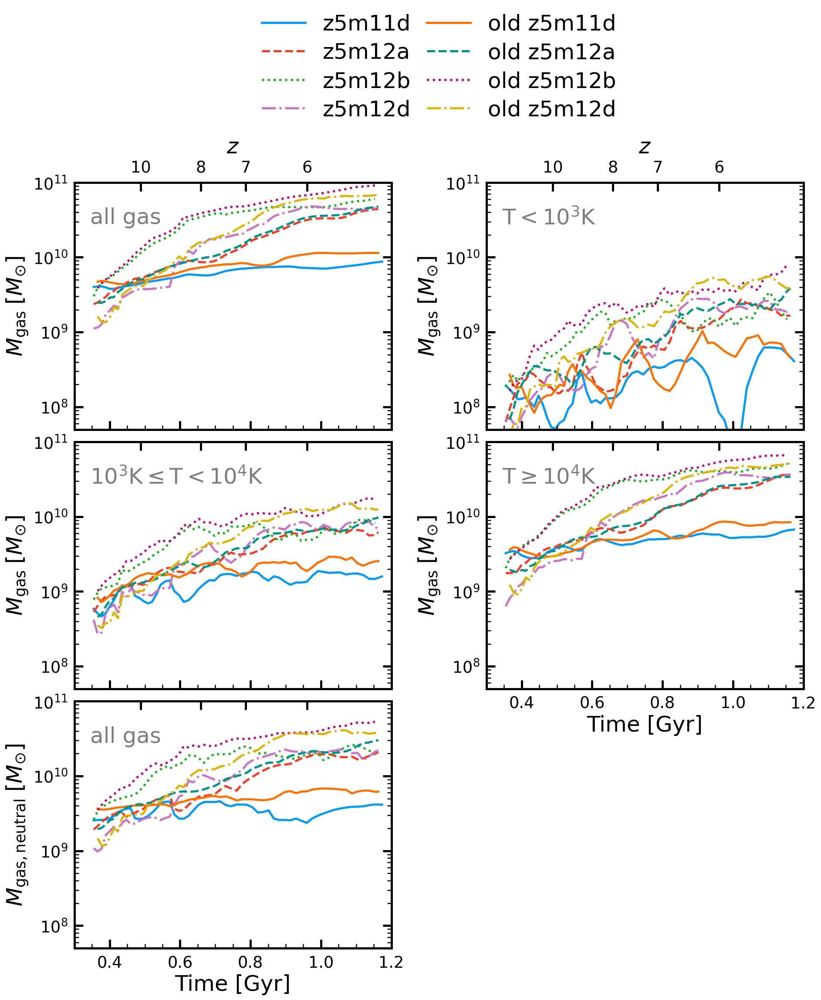

In [41]:
foutname = 'FIREversion_galaxy_ISMphase_vs_time.pdf'
# The galactic properties you want to plot the evolution of
params = ['M_gas','M_gas','M_gas','M_gas','M_gas_neutral']
# Set x-axis time property (time, redshift_plus_1, or redshfit)
time_prop = 'time'
# X and Y limits
y_lims=[[5E7,1E11]]*len(params)
x_lim=[0.3,1.2]
y_logs=[True]*(len(params))

# The precompile data objects which house all of the time evolution data
data_objs = np.append(sims[z5_mask],orig_sims)
# The statistic you want to use when plotting quantities that could be averaged
stat = 'total'
# What types of particles do you want to include for the properties (all, hot, warm, cold)
subsample = ['all','cold','warm','hot','all']
subsample_labels = ['all gas',r'T$<10^3$K',r'$10^3$K$\leq$T$<10^4$K','T$\geq10^4$K','all gas']
# Labels you to give to the data objects
labels = np.append(names[z5_mask],orig_labels)
# If you have multiple subsamples this makes them easily differentiable
sample_linewidths = None
style = 'color-linestyle'

outside_legend=True

# Get plot stylization
linewidths, colors, linestyles = plt_set.setup_plot_style(len(data_objs), style=style)
# Setup figure
fig = Figure(len(params), sharex=True, orientation='vertical',ncols=2)

for i, y_prop in enumerate(params):

    fig.set_axis(i, time_prop, y_prop, x_lim=x_lim, y_lim=y_lims[i], y_log=y_logs[i], twin_time_axis=True)

    param_labels = []
    sub_y_props = []
    if y_prop == 'source_frac':
        param_labels = np.array(config.DUST_SOURCES)
        sub_y_props = np.array(['source_acc', 'source_SNeII', 'source_AGB','source_SNeIa'])
        sub_colors = config.LINE_COLORS
    elif y_prop == 'spec_frac':
        param_labels = np.array(config.DUST_SPECIES)
        sub_y_props = np.array(['spec_sil', 'spec_carb', 'spec_iron', 'spec_ORes', 'spec_SiC', 'spec_ironIncl'])
        sub_colors = config.SECOND_LINE_COLORS
        # Check which of these dust species are in the simulations given
        in_sim = np.zeros(len(sub_y_props))
        for j, data in enumerate(data_objs):
            if isinstance(subsample, list):
                sample = subsample[j]
            else:
                sample = subsample
            for k, sub_param in enumerate(sub_y_props):
                data_vals = data.get_data(sub_param, subsample=sample, statistic=stat)
                if data_vals is not None and not np.all((data_vals == 0) | (np.isnan(data_vals))):
                    in_sim[k] += 1
        param_labels = param_labels[in_sim > 0]
        sub_y_props = sub_y_props[in_sim > 0]
        print("These species in sims given:", param_labels)
    elif y_prop == 'spec_frac_Si/C':
        param_labels = np.array(config.DUST_SPECIES_SIL_CARB)
        sub_y_props = np.array(['spec_sil+', 'spec_carb'])
        sub_colors = config.SECOND_LINE_COLORS
    elif '/H_all' in y_prop and y_prop.split('/')[0] in config.ELEMENTS:
        param_labels = np.array(['total', 'dust'])
        elem = y_prop.split('/')[0]
        sub_y_props = np.array([elem + '/H', elem + '/H_dust'])
        sub_colors = config.SECOND_LINE_COLORS

    if isinstance(subsample, list):
        sample = subsample[i]
    else:
        sample = subsample

    fig.add_text(i, .05, .9, subsample_labels[i], color='xkcd:medium grey', fontsize=config.LARGE_FONT, ha='left',
                va='top', zorder=1)

    for j, data in enumerate(data_objs):

        label = labels[j] if labels is not None else None
        # Get time data for x axis
        time_data = data.get_data(time_prop)

        # Check if parameter has subparameters
        if len(param_labels) == 0:
            data_vals = data.get_data(y_prop, subsample=sample, statistic=stat)
            fig.plot_line_data(i, time_data, data_vals, color=colors[j], linestyle=linestyles[j], label=labels[j],
                      linewidth=config.BASE_LINEWIDTH, zorder=-1)
        else:
            data_vals = []
            for sub_param in sub_y_props:
                data_vals += [data.get_data(sub_param, subsample=sample, statistic=stat)]
            data_vals = np.array(data_vals)
            for k in range(np.shape(data_vals)[0]):
                # Ignore properties that are zero for the entire simulation and don't plot them
                if not np.all(data_vals[k, :] == 0):
                    fig.plot_line_data(i, time_data, data_vals[k, :], color=sub_colors[k], linestyle=linestyles[j],
                              linewidth=config.BASE_LINEWIDTH, zorder=-1, label=param_labels[k])
    # Only need to label the separate simulations in the first plot
    if i == 0 and len(data_objs) > 1:
        if outside_legend:
            fig.set_outside_legend(ncol=2)
        else:
            fig.set_axis_legend(i)

fig.save(plot_dir+foutname)
